In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
#import uproot
import uproot3
from scipy import optimize as op
import scipy.integrate as integrate

In [2]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb
#uproot3
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH1\ Functions-uproot3.ipynb

#Gain Access to functions for taking discrete derivatives of lists of data
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Derivatives.ipynb

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

In [3]:
#date="05-07-2024"
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date+"/cc"
dir="/Users/cmc/analysis_phd/root_files/local_runs/e16/target"
root_file=dir+"/analysis_full_e16_geo_fid.root"
#root_file=dir+"/exp_e16_clas6_fid_geo_"+date+".root"
file=uproot3.open(root_file)

species="pro"
detector="sc"
cut="pid"

sector_names = ["sec1","sec2","sec3","sec4","sec5","sec6","all"]
side = ["left","coinc","right","All"]
num_cc_seg = 18
num_cc_side = 3
num_sc_pad = 48
#0-> pid | 1->event selection all 

In [4]:
layer1="Geometric Distributions"
layer2="Geo Fid "+species
layer3=layer2+" "+detector
layer4=[layer3+" "+sector_names[sec] for sec in range(7)]
layer5=[layer4[sec]+" "+cut for sec in range(7)]

    

In [5]:
hist_idx_len = len(file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[0]+"/"+layer5[0]].keys())

hist = [[file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]][file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]].keys()[2*hist_idx]] for hist_idx in range(round(hist_idx_len/2))] for sec in range(7)]


cut_hist_len = round(hist_idx_len/4)

In [6]:
def x_idx(xarray_, xval_):
    for i in range(len(xarray_)):
        if xarray_[i] <= xval_:
            if xarray_[i+1] >= xval_:
                return i
    return -1

def y_idx(yarray_, yval_):
    for i in range(len(yarray_)):
        if yarray_[i] <= yval_:
            if yarray_[i+1] >= yval_:
                return i
    return -1

In [7]:
#For cut only
def side_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return 0
        elif hist_idx < num_cc_seg*2:
            return 1
        else:
            return 2
    elif hist_idx_ <= num_cc_seg*3+3:
        return hist_idx_ - (num_cc_seg*3)

def seg_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return hist_idx_
        elif hist_idx < num_cc_seg*2:
            return hist_idx_ - num_cc_seg
        else:
            return hist_idx_ - num_cc_seg*2
    elif hist_idx_ <= num_cc_seg*3+3:
        return _num_cc_seg
    
def pad_idx(hist_idx_):
    if hist_idx_ <= _num_sc_pad:
        return hist_idx_ 
    else:
        return -1
    
def cc_hist_idx(side_, seg_):
    if side_ == 3:
        if seg_ == num_cc_seg:
            return cut_hist_len-1
        else:
            return -1
    else:
        if seg_ == num_cc_seg:
            return num_cc_seg*3 + side_
        else:
            return num_cc_seg*side_ + seg_


In [8]:
#Look at Overall Distributions
xdim_len = len(Center_Xbins(hist[0][0]))
ydim_len = len(Center_Ybins(hist[0][0]))

x_merge = 1
y_merge = 1


xvals = Merge_Bins(Center_Xbins(hist[0][0]),x_merge)
yvals = Merge_Bins(Center_Ybins(hist[0][0]),y_merge)
zvals_xy = [[Merge_Z(XY_Values(hist[sec][hist_idx]),x_merge,y_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]
zvals_yx = [[Merge_Z(YX_Values(hist[sec][hist_idx]),y_merge,x_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]

xdim = len(xvals)
ydim = len(yvals)


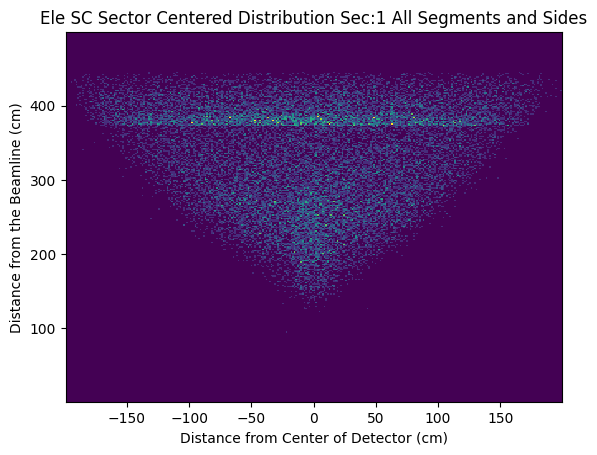

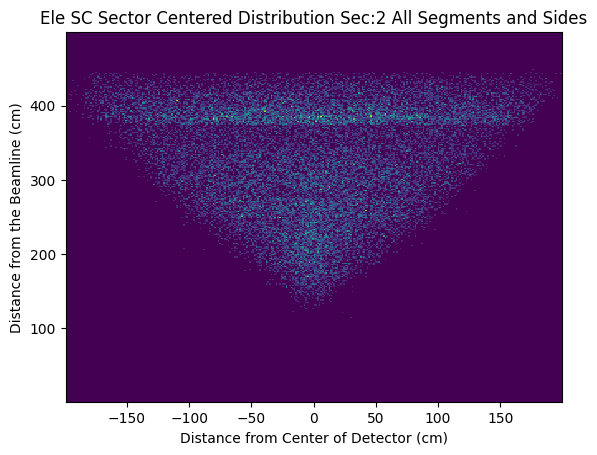

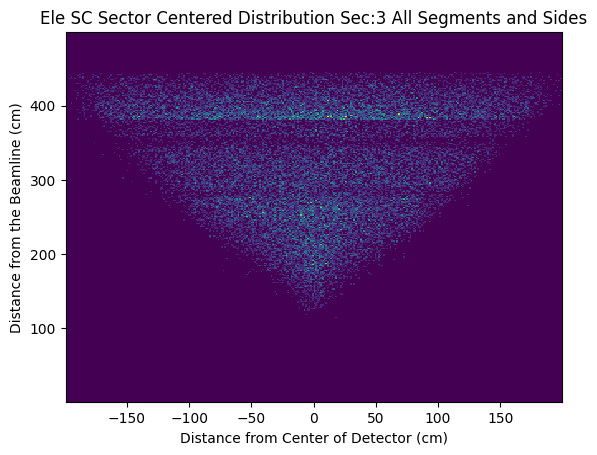

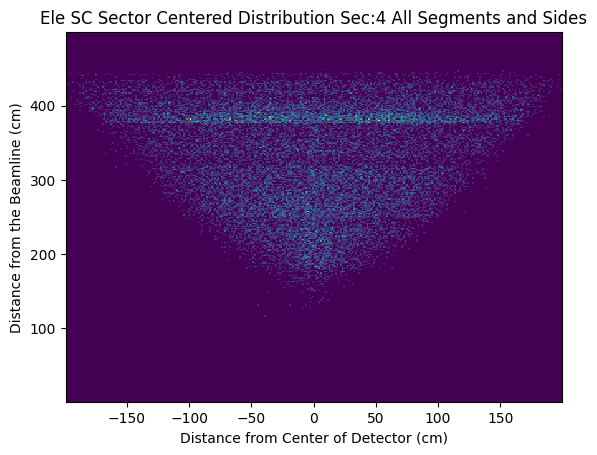

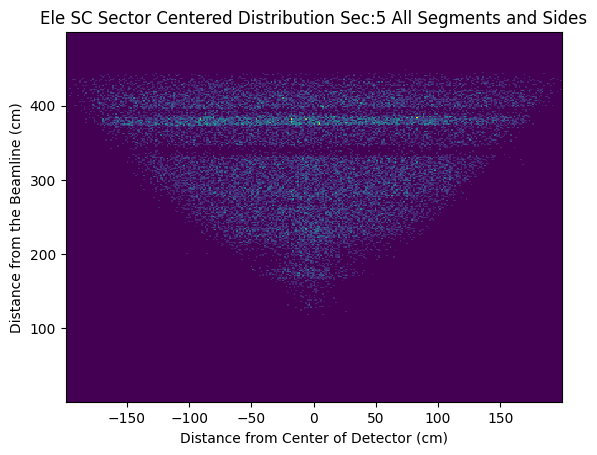

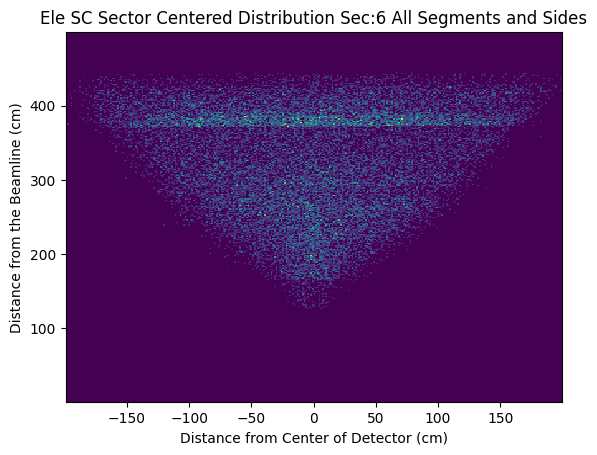

In [9]:
dumb1_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense1 = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense2 = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x[sec][hist_idx][i+j*xdim]+=xvals[i]
                dumb1_y[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y[sec][hist_idx][j+i*ydim]+=xvals[i]
                dense2[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]
for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1])
    plt.title("Ele SC Sector Centered Distribution Sec:{} All Segments and Sides".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [10]:
proj_y = np.zeros((7,cut_hist_len,ydim))
for sec in range(7):
    for i in range(ydim):
        for j in range(xdim):
            for hist_idx in range(cut_hist_len):
                proj_y[sec][hist_idx][i] += zvals_xy[sec][hist_idx][j][i]

In [11]:
sec = 0
hist_idx = 3
print(np.argmax(proj_y[sec][hist_idx]))
print(proj_y[sec][hist_idx][np.argmax(proj_y[sec][hist_idx])])

56
2.0


In [12]:
def super_gaus_cut_bound(frac_,side_,a_,m_,s_,p_):
    if side_ == 0:
        return 0.5*(2*m_ - 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    elif side_ ==1:
        return 0.5*(2*m_ + 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    else:
        return -99.9
    

def Sup_Gaus_Cutoff(x_,frac_,a_,m_,s_,p_):
    if x < super_gaus_cut_bound(frac_,0,a_,m_,s_,p_):
        return 0.
    elif x > super_gaus_cut_bound(frac_,1,a_,m_,s_,p_):
        return 0.
    else:
        return Super_Gaus(x_,a_,m_,s_,p_)
    
def Sup_Gaus_Cutoff_Array(x_,frac_,a_,m_,s_,p_):
    output = np.zeros(len(x_))
    for i in range(len(x_)):
        output[i] = Sup_Gaus_Cutoff(x_[i],frac_,a_,m_,s_,p_)
    return output

Parameters for Sec:1 Paddle:7
test pars [ 20.         145.83333333   5.4          4.        ]
fit pars [ 15.71428575 145.83333334   4.74392528  62.17111832]


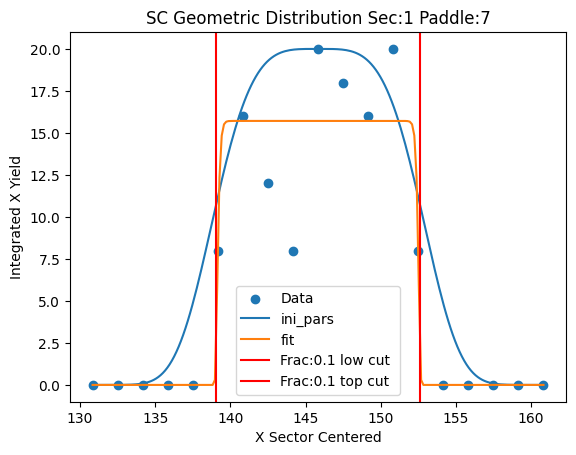

Parameters for Sec:1 Paddle:8
test pars [ 60.         155.83333333   5.74392528  62.17111832]
fit pars [ 32.18209023 157.43946246   6.91445029  62.65804663]


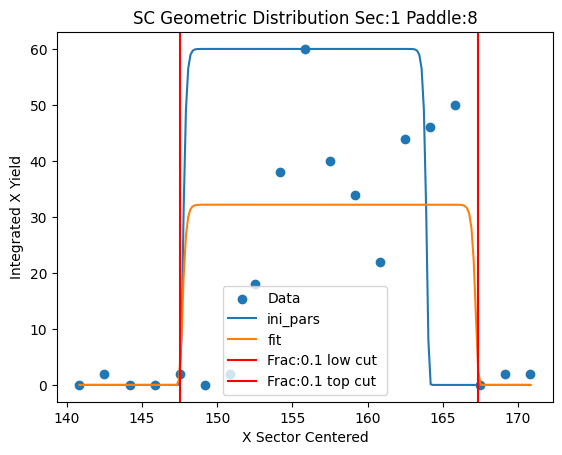

Parameters for Sec:1 Paddle:9
test pars [ 60.         169.16666667   7.91445029  62.65804663]
fit pars [ 50.75000012 173.28330354   5.27291963  75.23122589]


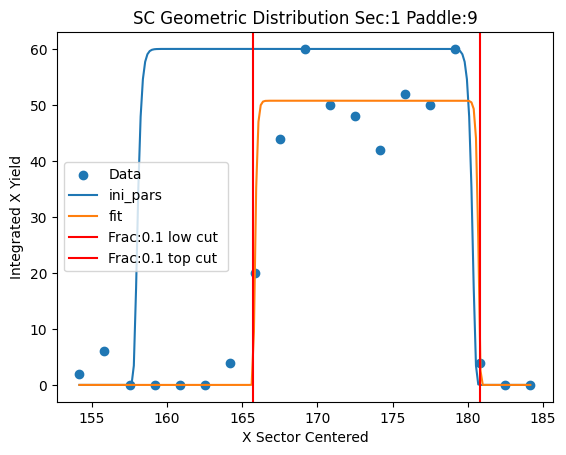

Parameters for Sec:1 Paddle:10
test pars [138.         190.83333333   6.27291963  75.23122589]
fit pars [ 87.14286266 187.41741301   4.72623164  54.22486323]


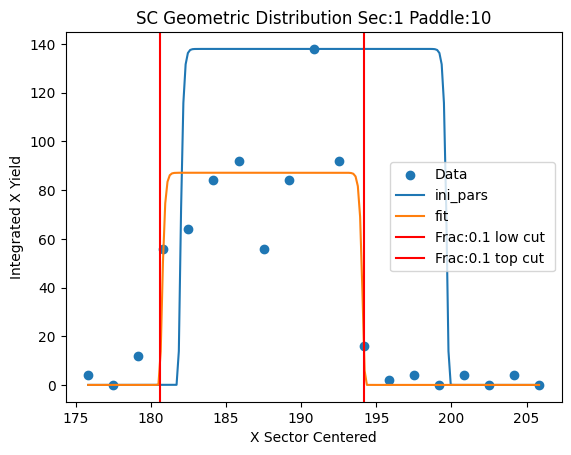

Parameters for Sec:1 Paddle:11
test pars [152.         205.83333333   5.72623164  54.22486323]
fit pars [124.85714286 200.80932714   4.75012208  77.14243973]


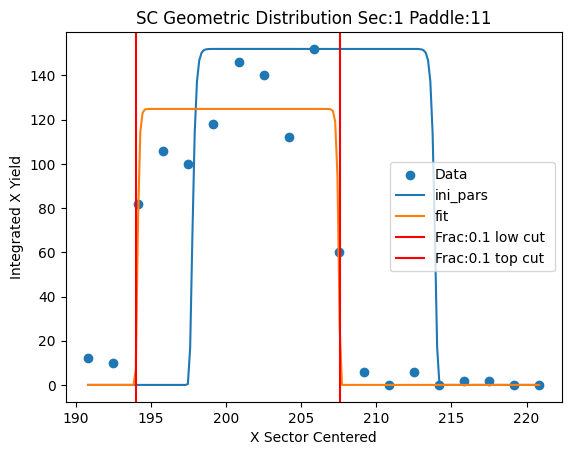

Parameters for Sec:1 Paddle:12
test pars [212.         219.16666667   5.75012208  77.14243973]
fit pars [173.40696303 214.58876835   5.04234194  11.2088277 ]


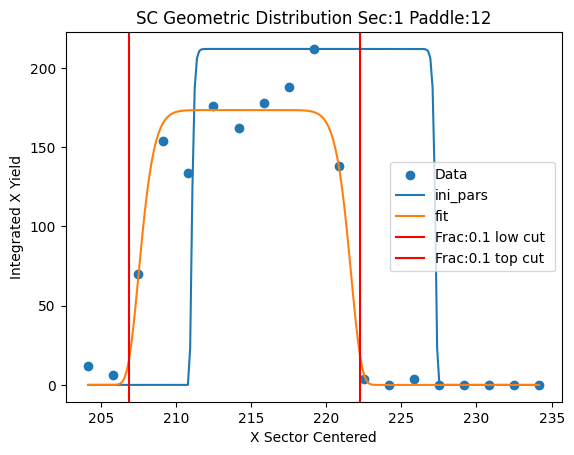

Parameters for Sec:1 Paddle:13
test pars [230.         227.5          6.04234194  11.2088277 ]
fit pars [204.75000637 228.29286079   5.26045321  65.83254843]


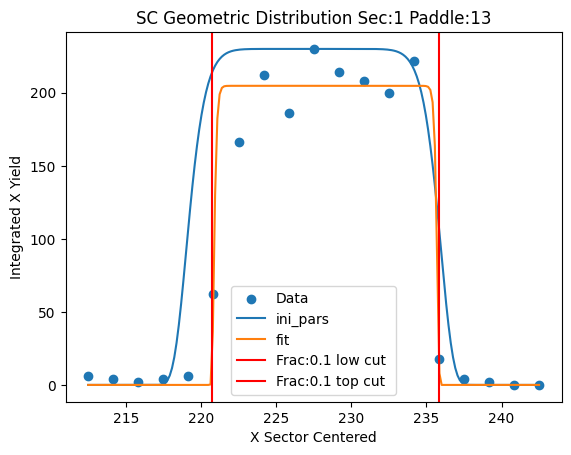

Parameters for Sec:1 Paddle:14
test pars [288.         240.83333333   6.26045321  65.83254843]
fit pars [263.95498713 241.9561343    5.08673859  11.56170388]


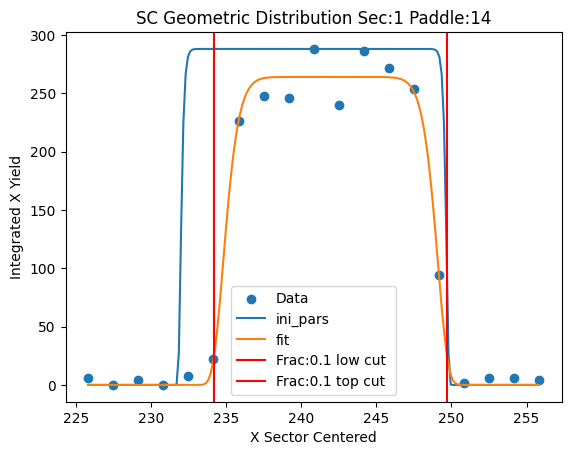

Parameters for Sec:1 Paddle:15
test pars [334.         257.5          6.08673859  11.56170388]
fit pars [308.80007958 255.75174011   5.0520978    7.12186888]


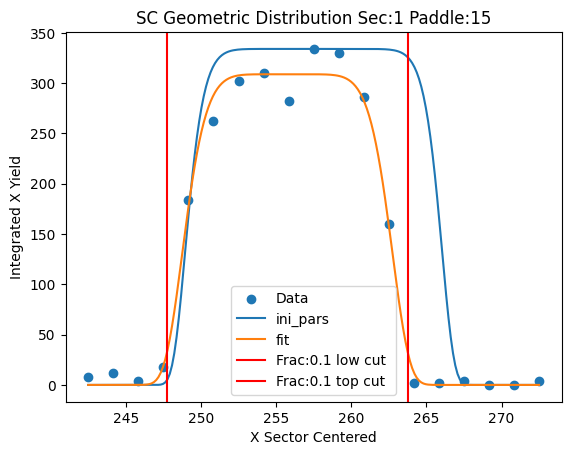

Parameters for Sec:1 Paddle:16
test pars [392.         270.83333333   6.0520978    7.12186888]
fit pars [360.55975026 269.36261733   4.99930911   6.14224646]


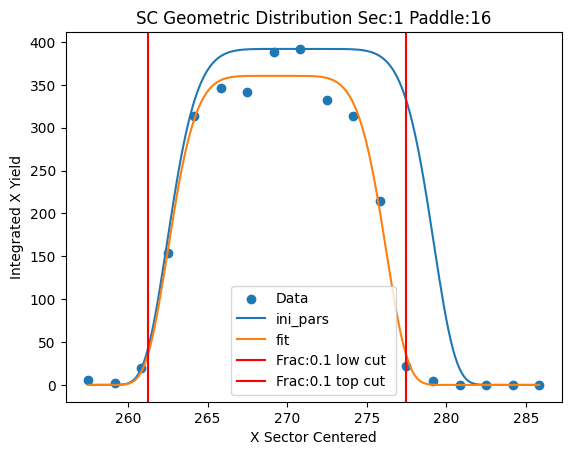

Parameters for Sec:1 Paddle:17
test pars [348.         282.5          5.99930911   6.14224646]
fit pars [320.16789944 283.22178472   5.13155564  14.91327851]


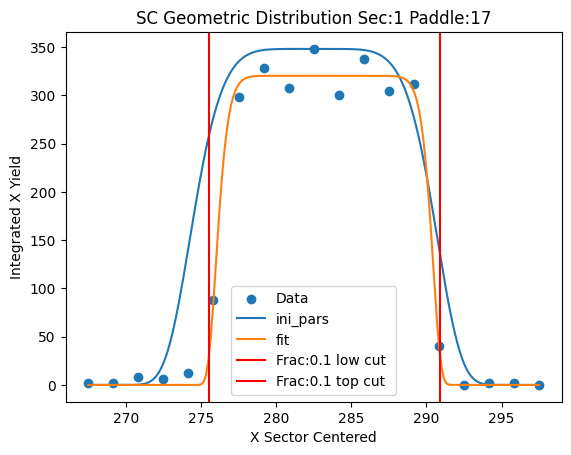

Parameters for Sec:1 Paddle:18
test pars [352.         299.16666667   6.13155564  14.91327851]
fit pars [308.99465189 296.76500519   5.07536185  11.55027715]


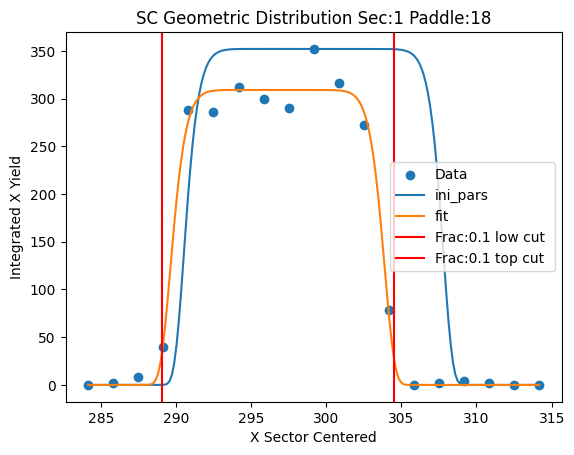

Parameters for Sec:1 Paddle:19
test pars [360.         309.16666667   6.07536185  11.55027715]
fit pars [327.05677069 310.6447354    4.97104336   9.00470382]


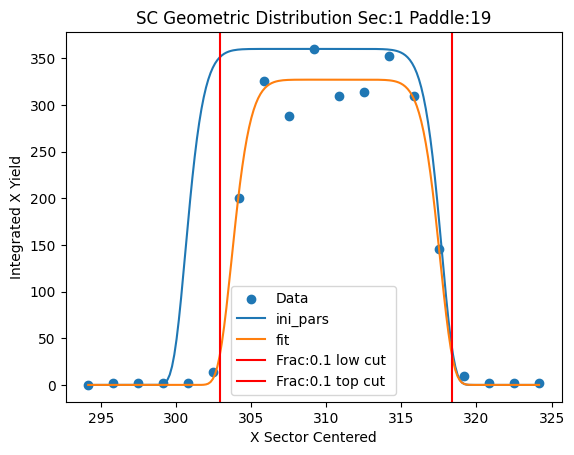

Parameters for Sec:1 Paddle:20
test pars [346.         319.16666667   5.97104336   9.00470382]
fit pars [323.80809619 324.40088189   5.06698125   8.19249113]


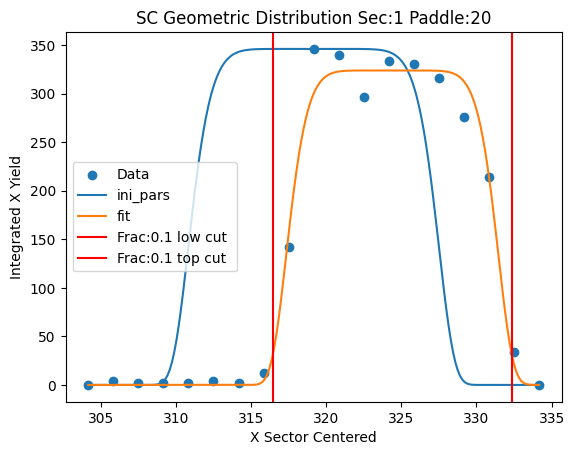

Parameters for Sec:1 Paddle:21
test pars [322.         342.5          6.06698125   8.19249113]
fit pars [301.72823593 338.15905152   5.1050576    8.31966216]


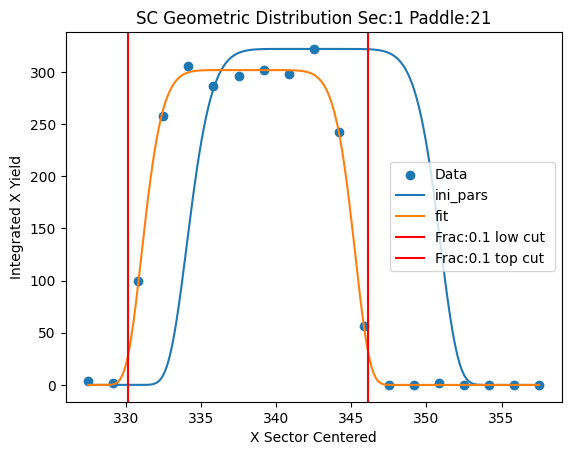

Parameters for Sec:1 Paddle:22
test pars [326.         349.16666667   6.1050576    8.31966216]
fit pars [274.63086763 351.66281673   5.20275455  10.88802955]


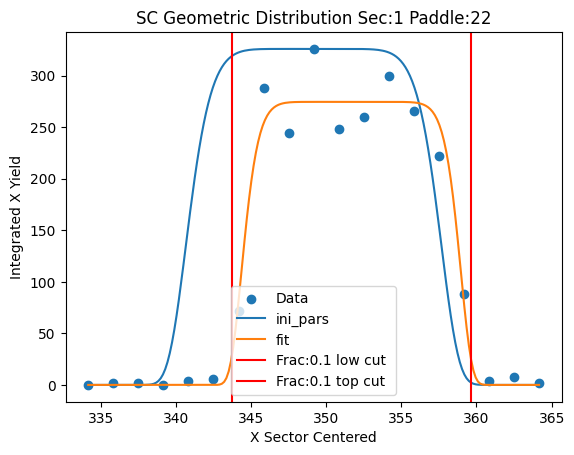

Parameters for Sec:1 Paddle:23
test pars [290.         367.5          6.20275455  10.88802955]
fit pars [266.16916531 365.23529165   4.96675118   8.72878632]


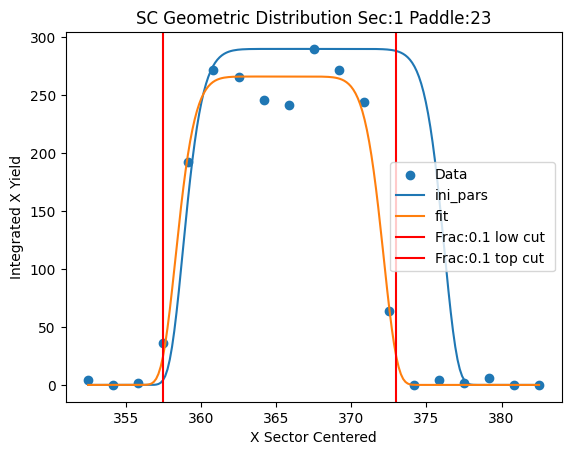

Parameters for Sec:1 Paddle:24
test pars [230.         379.16666667   5.96675118   8.72878632]
fit pars [226.28471034 379.31142721   5.50514328   6.4827459 ]


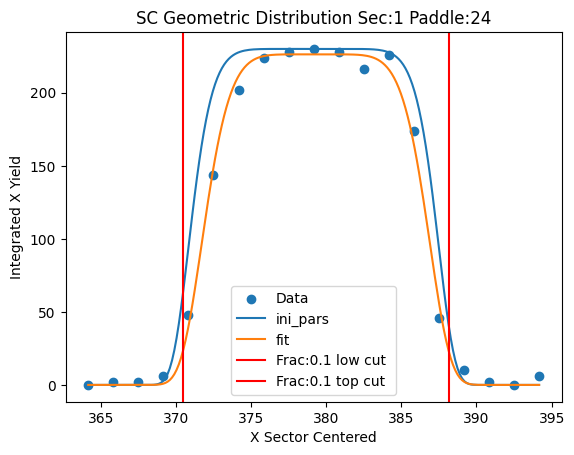

Parameters for Sec:1 Paddle:26
test pars [692.         382.5          6.50514328   6.4827459 ]
fit pars [679.3333354  382.44803023   2.34850795  28.32042384]


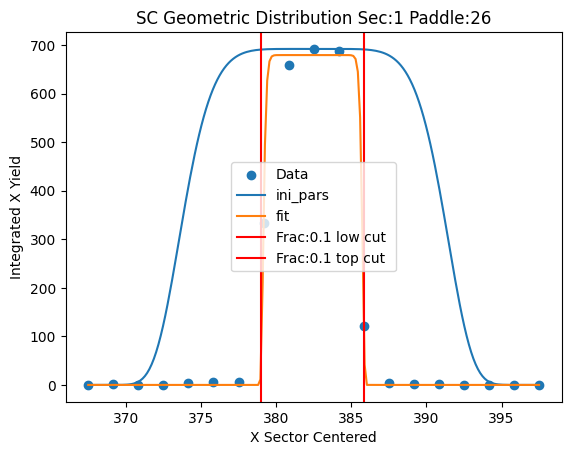

Parameters for Sec:1 Paddle:27
test pars [644.         389.16666667   3.34850795  28.32042384]
fit pars [641.57920983 388.15970352   2.18820554   5.72629016]


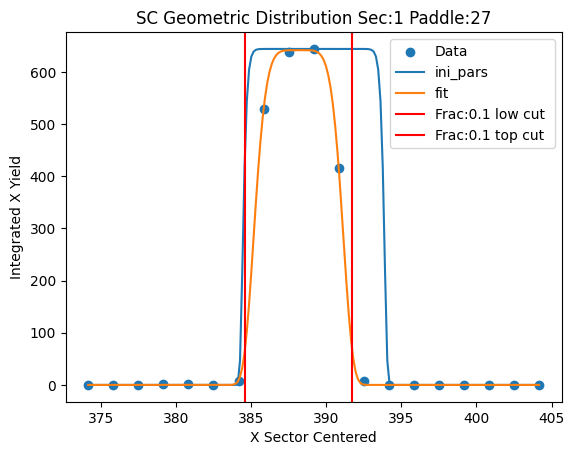

Parameters for Sec:1 Paddle:35
test pars [148.         434.16666667   3.18820554   5.72629016]
fit pars [158.78251154 435.47024856   1.93709752   1.80091743]


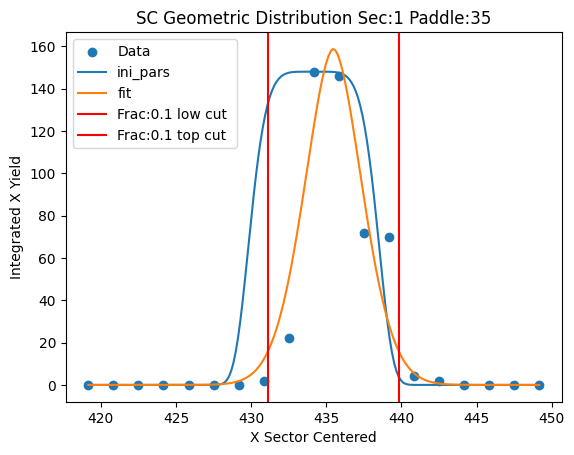

Parameters for Sec:1 Paddle:44
test pars [  8.         370.83333333   2.93709752   1.80091743]
fit pars [1.31333233e+03 3.70198978e+02 1.70391540e-08 9.61281051e-02]


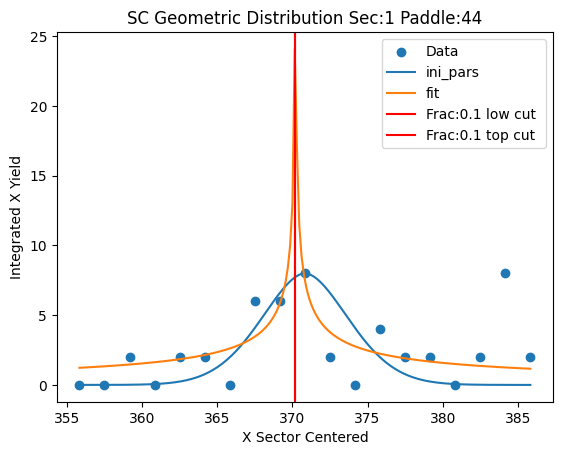

Parameters for Sec:1 Paddle:45
test pars [8.00000000e+00 3.35833333e+02 1.00000002e+00 9.61281051e-02]
fit pars [7.23800928e+00 3.35833331e+02 9.18415925e-01 2.95034650e-01]


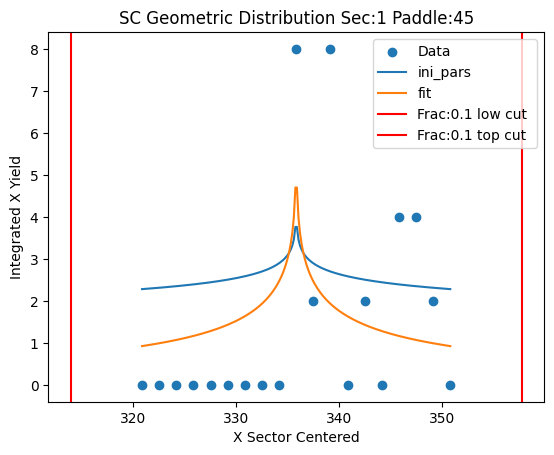

Parameters for Sec:1 Paddle:47
test pars [6.00000000e+00 2.99166667e+02 1.91841593e+00 2.95034650e-01]
fit pars [5.72317526e+00 2.99166666e+02 1.84563401e+00 2.66244911e-01]


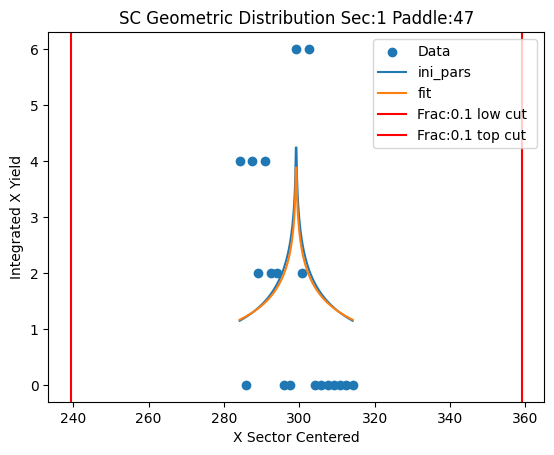

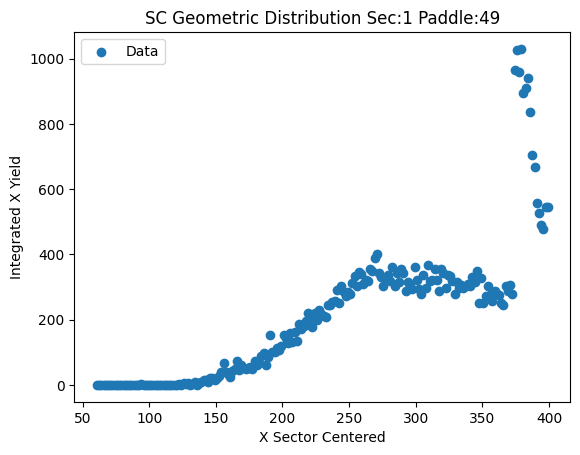

Parameters for Sec:2 Paddle:6
test pars [ 10.         134.16666667   5.4          4.        ]
fit pars [  8.6715771  134.16667011   3.31883469   1.02840607]


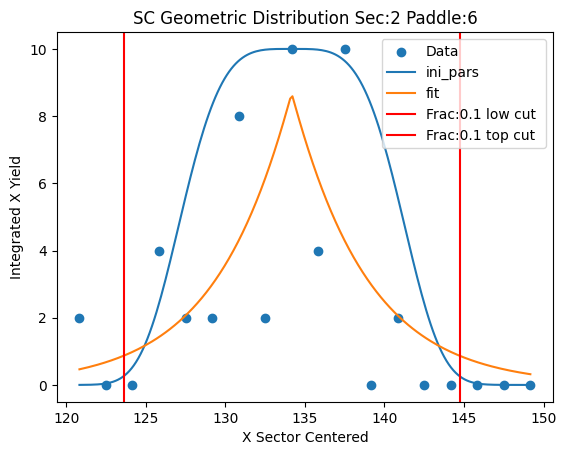

Parameters for Sec:2 Paddle:7
test pars [ 36.         147.5          4.31883469   1.02840607]
fit pars [ 35.18974217 147.50784366   3.12090684   1.39503783]


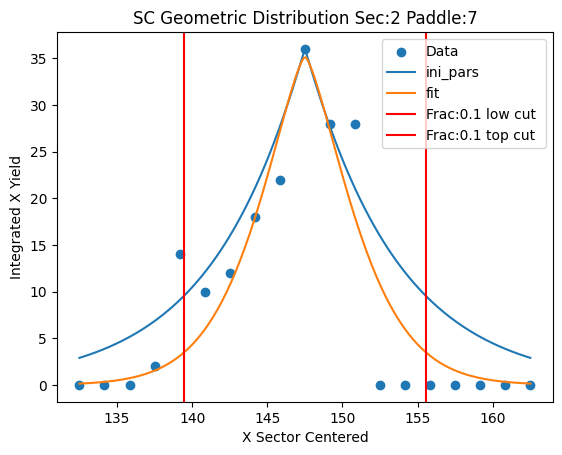

Parameters for Sec:2 Paddle:8
test pars [ 60.         159.16666667   4.12090684   1.39503783]
fit pars [ 45.25712694 159.1348231    4.885748    14.61015697]


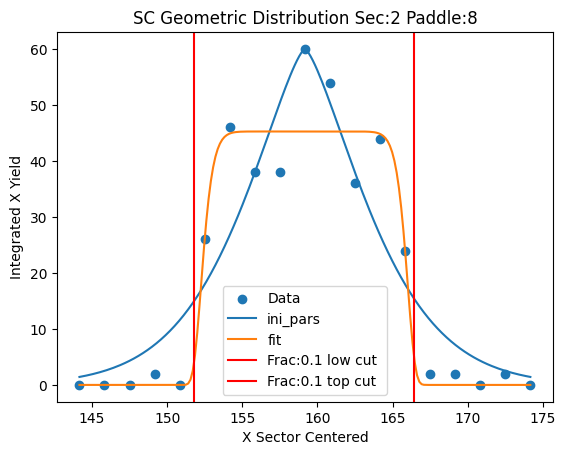

Parameters for Sec:2 Paddle:9
test pars [110.         175.83333333   5.885748    14.61015697]
fit pars [ 84.33589035 172.55682571   4.94503672   7.95117716]


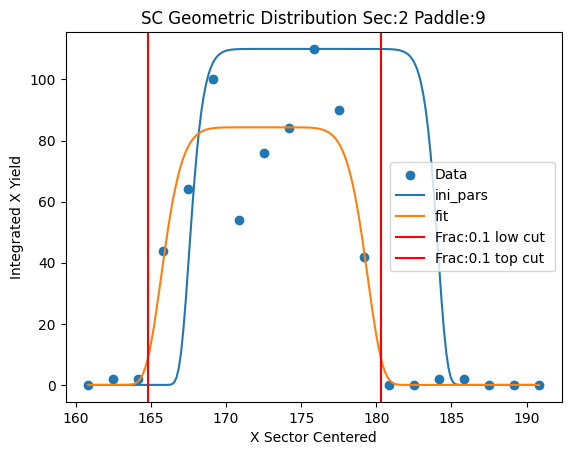

Parameters for Sec:2 Paddle:10
test pars [152.         189.16666667   5.94503672   7.95117716]
fit pars [113.24347089 186.40209331   5.13644643  13.49077238]


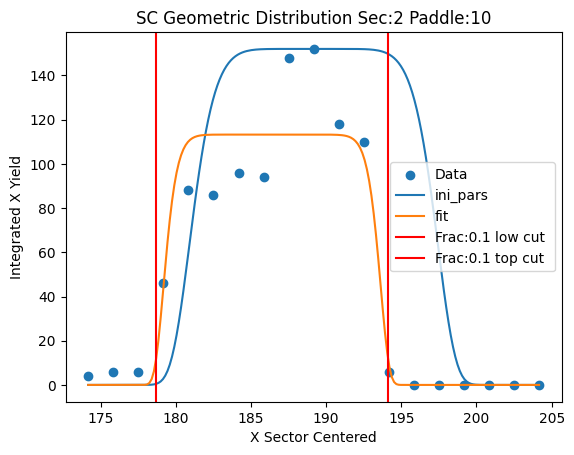

Parameters for Sec:2 Paddle:11
test pars [160.         204.16666667   6.13644643  13.49077238]
fit pars [146.21705403 200.25170507   4.97903194   8.85044342]


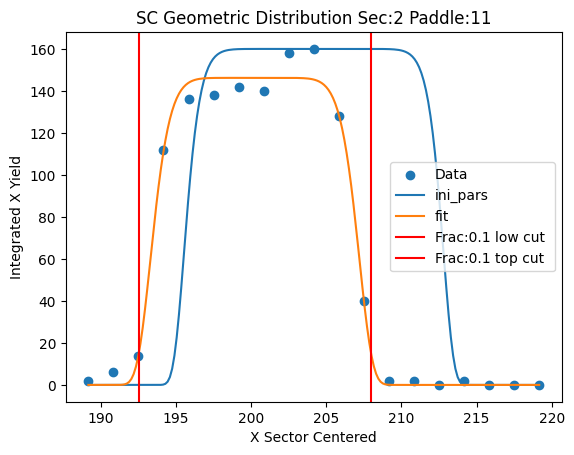

Parameters for Sec:2 Paddle:12
test pars [192.         209.16666667   5.97903194   8.85044342]
fit pars [164.85714356 214.1122398    4.77587005  59.16714789]


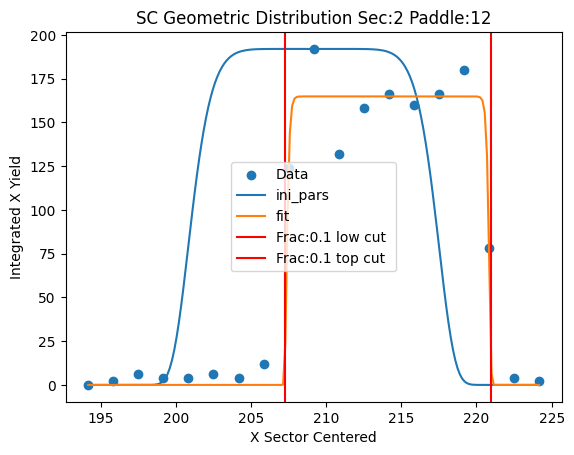

Parameters for Sec:2 Paddle:13
test pars [278.         232.5          5.77587005  59.16714789]
fit pars [220.57142886 227.51981625   4.77050215  61.72741905]


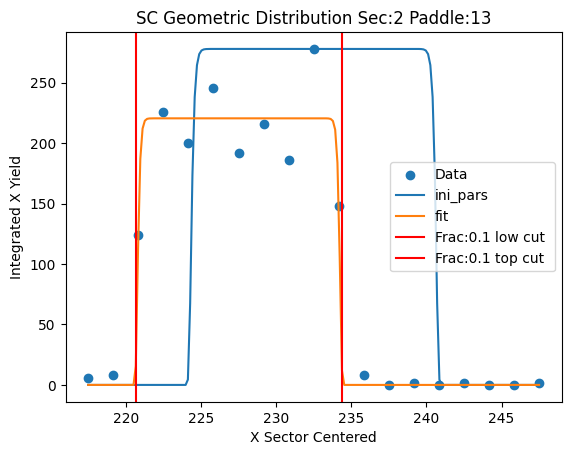

Parameters for Sec:2 Paddle:14
test pars [256.         240.83333333   5.77050215  61.72741905]
fit pars [227.27065413 241.37804802   4.93779173  10.89584341]


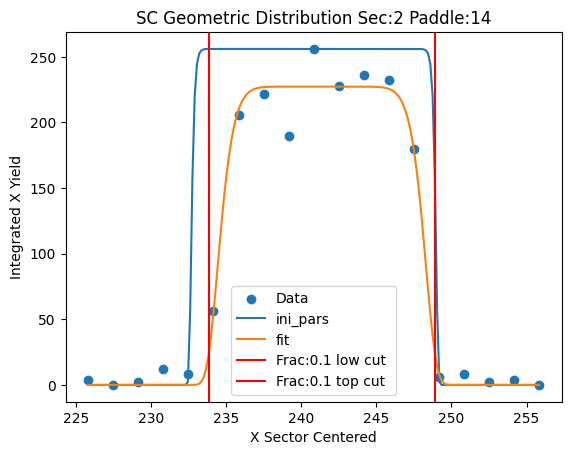

Parameters for Sec:2 Paddle:15
test pars [332.         255.83333333   5.93779173  10.89584341]
fit pars [301.75000217 255.04026884   5.25278642  72.17608218]


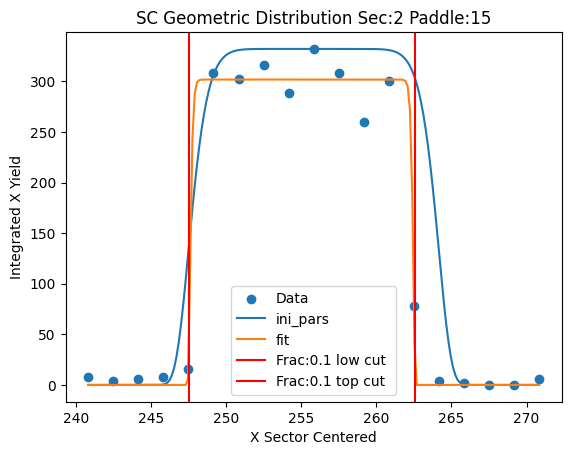

Parameters for Sec:2 Paddle:16
test pars [366.         270.83333333   6.25278642  72.17608218]
fit pars [326.85714347 269.09969406   4.77888856  63.50373281]


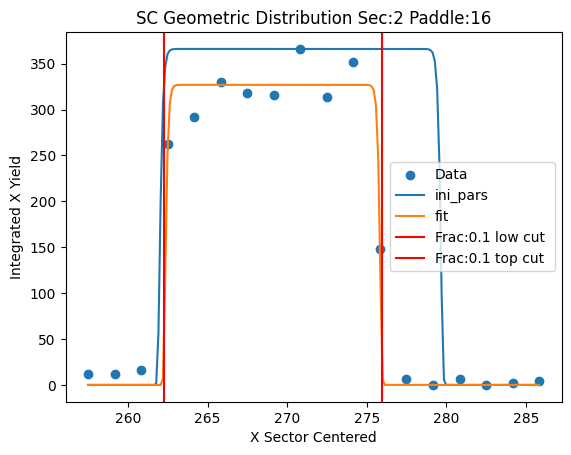

Parameters for Sec:2 Paddle:17
test pars [268.         287.5          5.77888856  63.50373281]
fit pars [248.61919888 282.7523428    5.04038963  11.88089729]


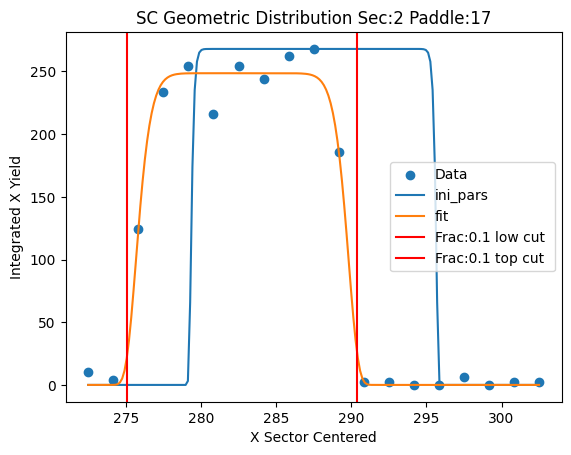

Parameters for Sec:2 Paddle:18
test pars [376.         294.16666667   6.04038963  11.88089729]
fit pars [360.06531199 296.42879678   5.00525878  10.83503579]


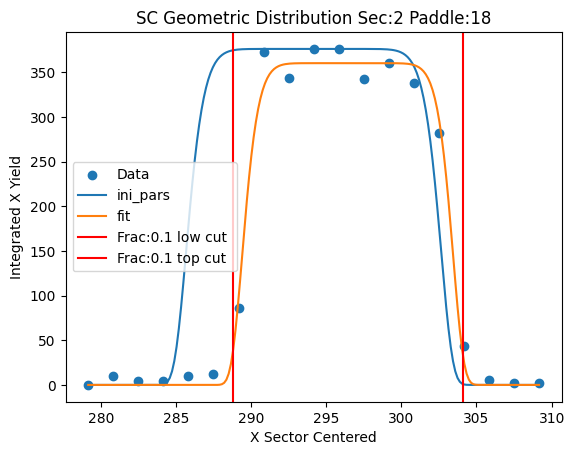

Parameters for Sec:2 Paddle:19
test pars [390.         309.16666667   6.00525878  10.83503579]
fit pars [339.37749827 310.13403937   5.16282033  13.11134411]


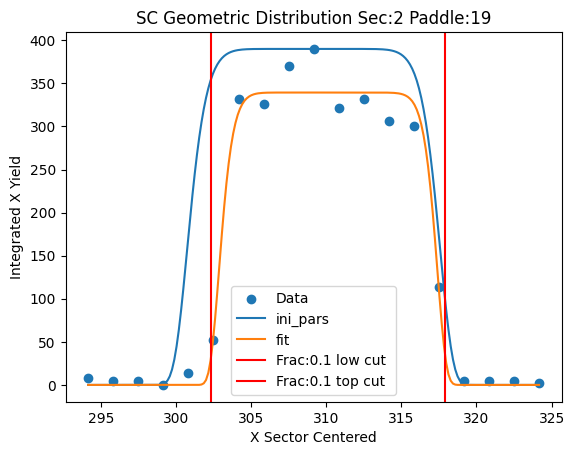

Parameters for Sec:2 Paddle:20
test pars [356.         324.16666667   6.16282033  13.11134411]
fit pars [325.48726405 323.909917     5.1307439   11.67403402]


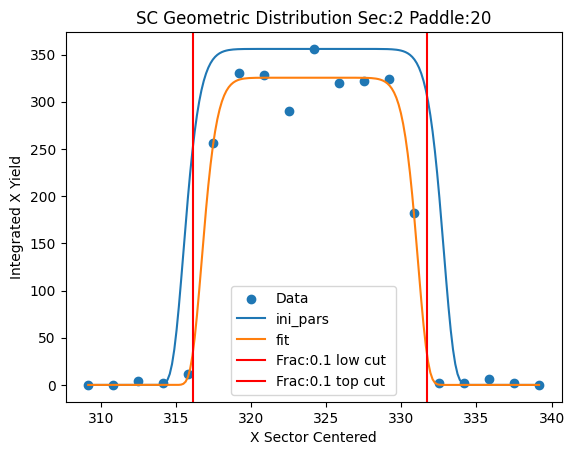

Parameters for Sec:2 Paddle:21
test pars [342.         342.5          6.1307439   11.67403402]
fit pars [314.84549574 337.77137684   5.10930714   8.82899881]


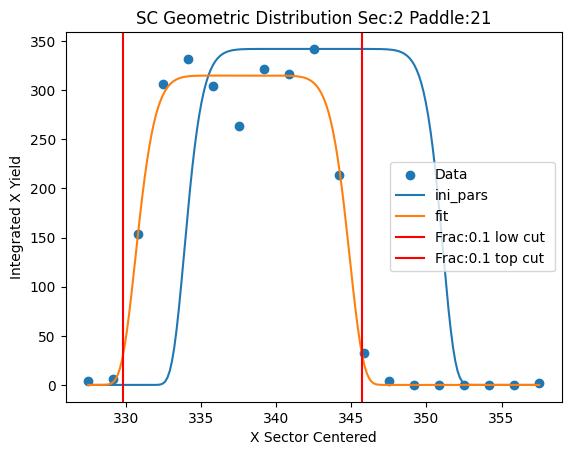

Parameters for Sec:2 Paddle:22
test pars [282.         347.5          6.10930714   8.82899881]
fit pars [245.96987712 351.66982149   5.04629618   9.71373398]


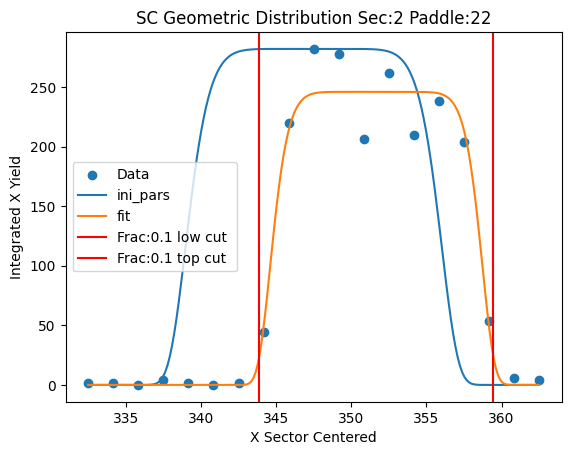

Parameters for Sec:2 Paddle:23
test pars [284.         364.16666667   6.04629618   9.71373398]
fit pars [269.08156358 364.93428817   4.99971633   9.07391277]


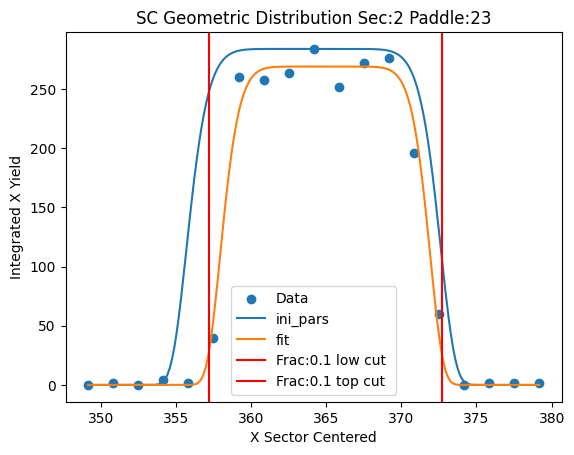

Parameters for Sec:2 Paddle:24
test pars [264.         375.83333333   5.99971633   9.07391277]
fit pars [228.07265318 379.67285597   5.63301364   8.82737052]


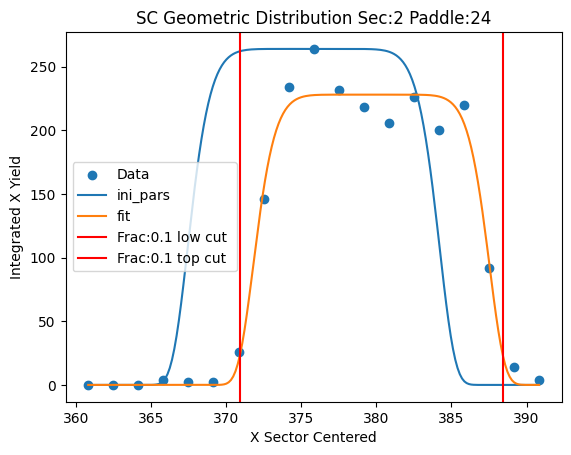

Parameters for Sec:2 Paddle:25
test pars [506.         379.16666667   6.63301364   8.82737052]
fit pars [481.01840858 378.51948259   2.22821057   4.8075618 ]


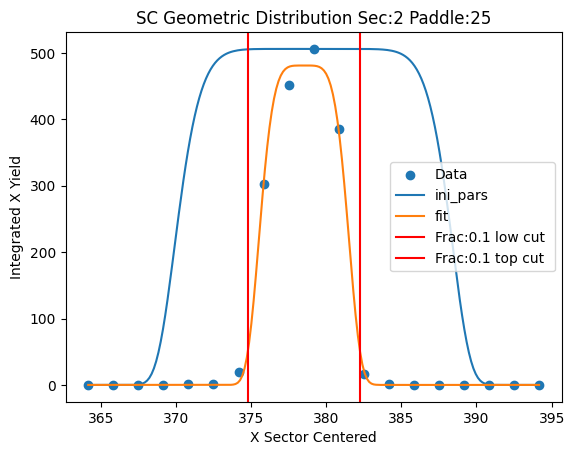

Parameters for Sec:2 Paddle:26
test pars [732.         385.83333333   3.22821057   4.8075618 ]
fit pars [723.32965255 384.51990459   2.12420455   4.46594357]


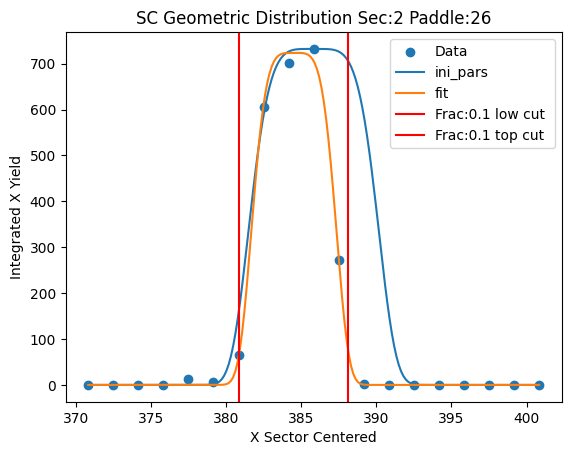

Parameters for Sec:2 Paddle:27
test pars [654.         390.83333333   3.12420455   4.46594357]
fit pars [645.57564749 390.26927064   2.19851576   6.26966916]


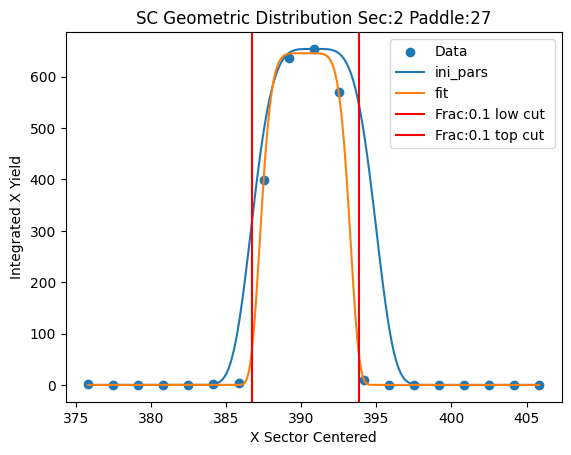

Parameters for Sec:2 Paddle:28
test pars [660.         395.83333333   3.19851576   6.26966916]
fit pars [629.57478912 396.09428963   2.21868675   7.39512592]


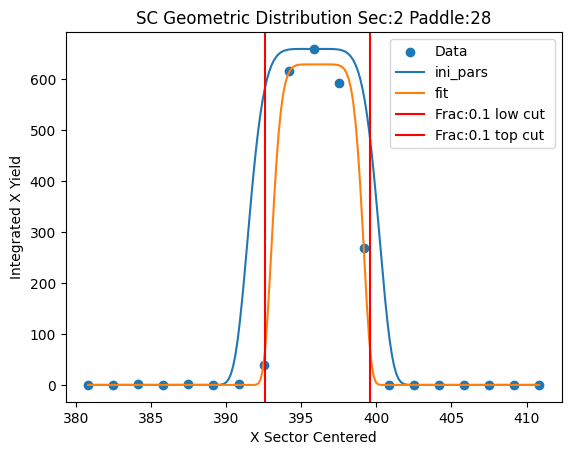

Parameters for Sec:2 Paddle:34
test pars [216.         430.83333333   3.21868675   7.39512592]
fit pars [196.61600816 431.17899048   2.09073034   4.62537204]


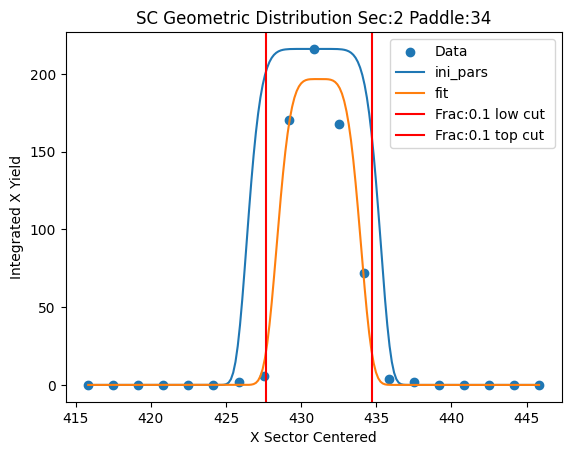

Parameters for Sec:2 Paddle:41
test pars [ 24.         415.83333333   3.09073034   4.62537204]
fit pars [ 16.6666667  411.47262453   4.20837117  59.34941455]


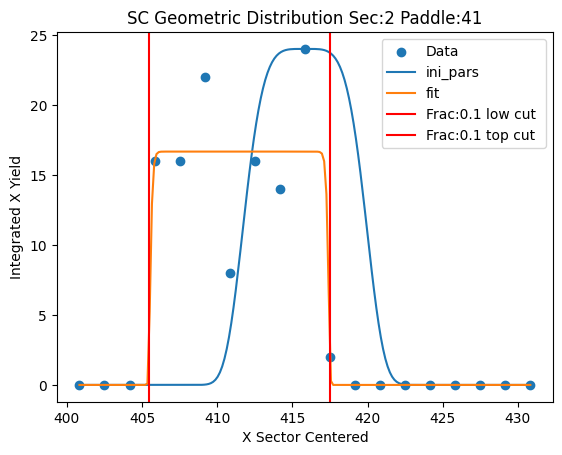

Parameters for Sec:2 Paddle:42
test pars [ 14.         404.16666667   5.20837117  59.34941455]
fit pars [  8.66666668 399.92511471   4.14816223  53.86870304]


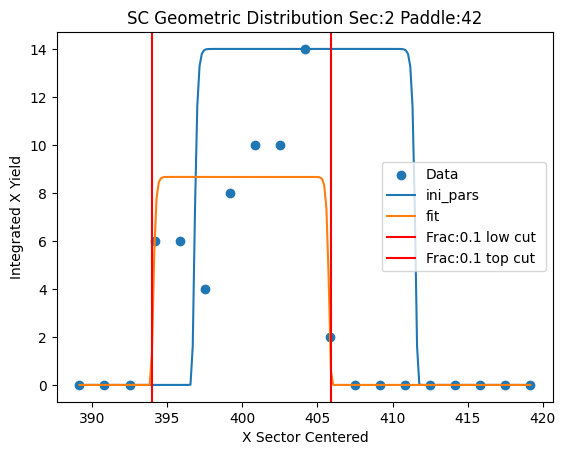

Parameters for Sec:2 Paddle:44
test pars [  6.         365.83333333   5.14816223  53.86870304]
fit pars [  3.14285714 370.9752919    4.66450708  72.34427826]


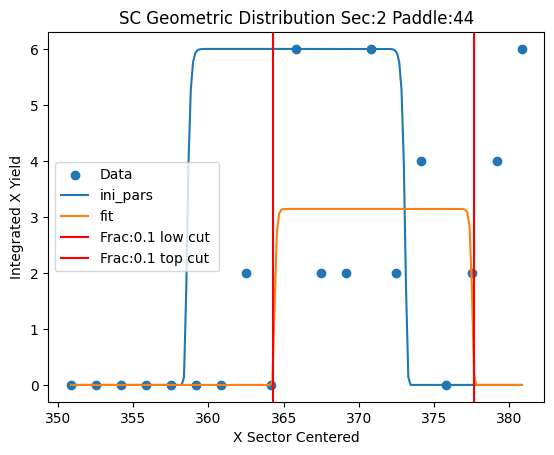

Parameters for Sec:2 Paddle:45
test pars [ 10.         345.83333333   5.66450708  72.34427826]
fit pars [  5.090909   353.22836445   7.43884251 114.27398029]


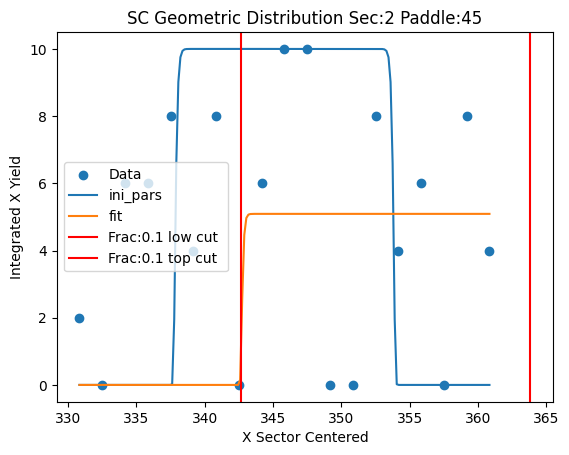

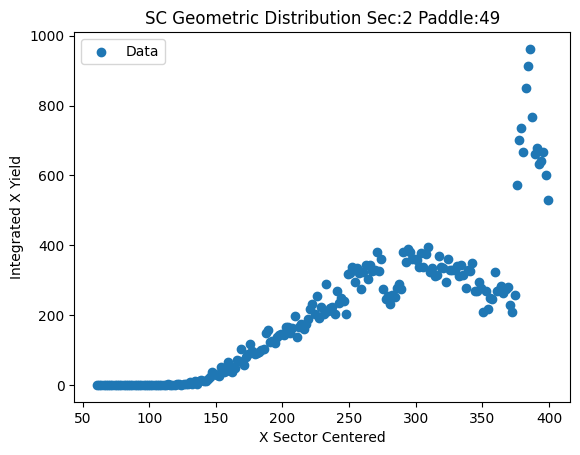

Parameters for Sec:3 Paddle:6
test pars [ 16.         135.83333333   5.4          4.        ]
fit pars [ 10.85714286 130.97814208   4.78019412  69.59203609]


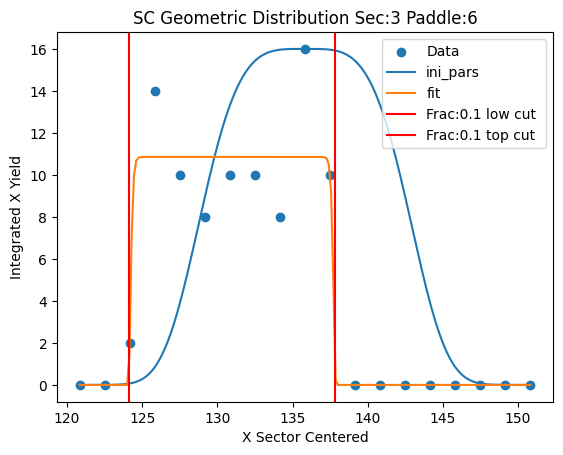

Parameters for Sec:3 Paddle:7
test pars [ 40.         150.83333333   5.78019412  69.59203609]
fit pars [ 27.2423826  146.13460144   4.8957057    6.1805491 ]


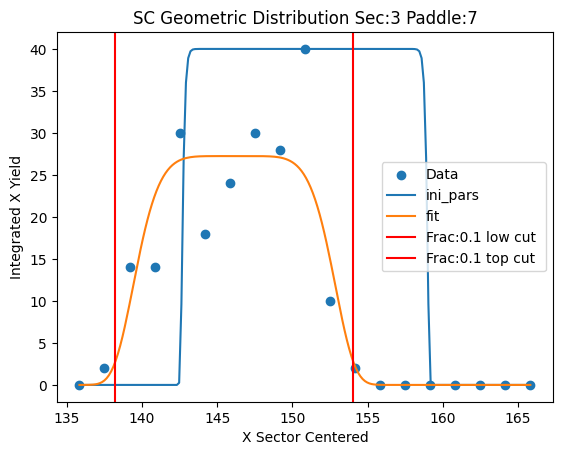

Parameters for Sec:3 Paddle:8
test pars [ 68.         160.83333333   5.8957057    6.1805491 ]
fit pars [ 47.27574558 159.71027983   4.72748216   3.09941704]


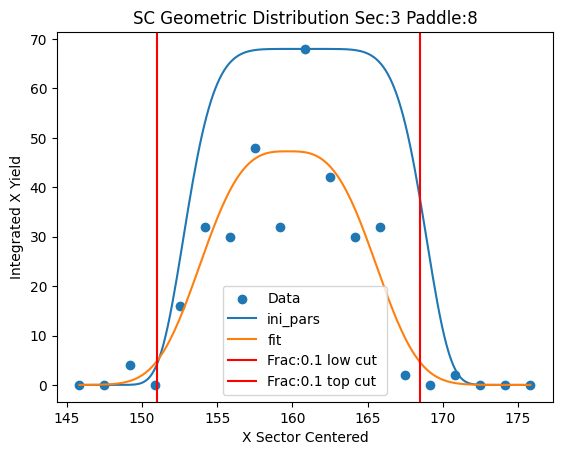

Parameters for Sec:3 Paddle:9
test pars [112.         177.5          5.72748216   3.09941704]
fit pars [ 76.75       173.24636868   5.22978796  97.03017029]


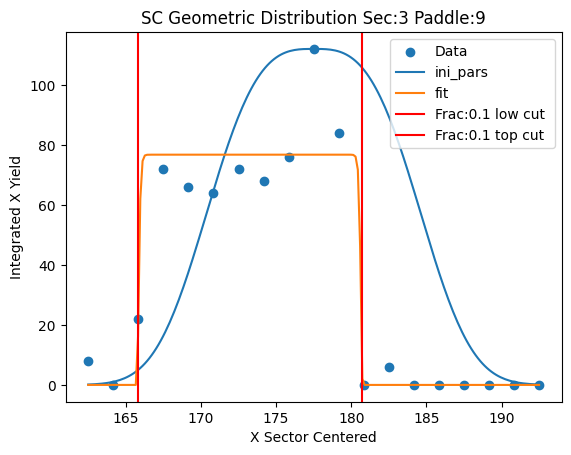

Parameters for Sec:3 Paddle:10
test pars [154.         187.5          6.22978796  97.03017029]
fit pars [121.74048464 186.70788013   5.03976918   8.07114756]


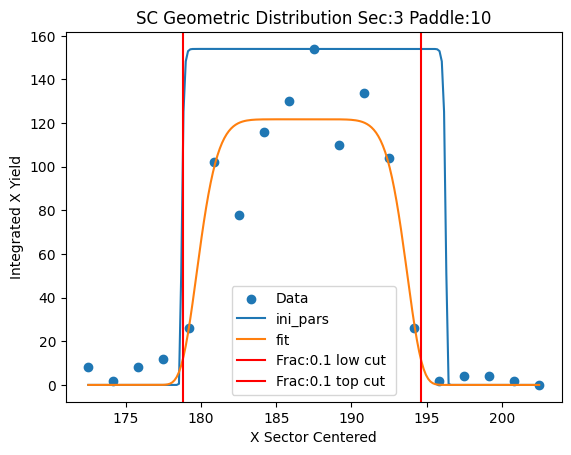

Parameters for Sec:3 Paddle:11
test pars [188.         199.16666667   6.03976918   8.07114756]
fit pars [175.39321248 200.81184386   5.19545522   8.89982559]


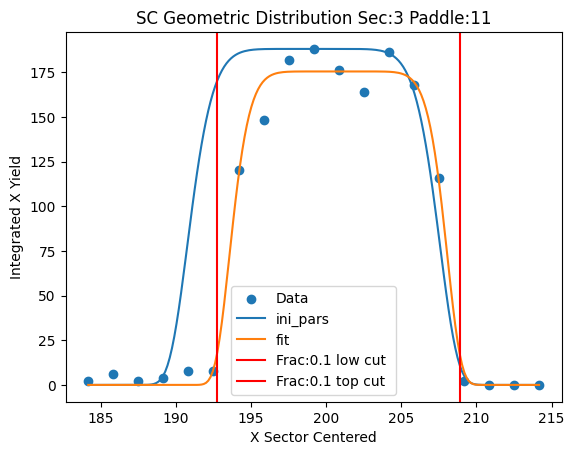

Parameters for Sec:3 Paddle:12
test pars [244.         217.5          6.19545522   8.89982559]
fit pars [203.51338738 214.41697369   4.8478792   10.28524667]


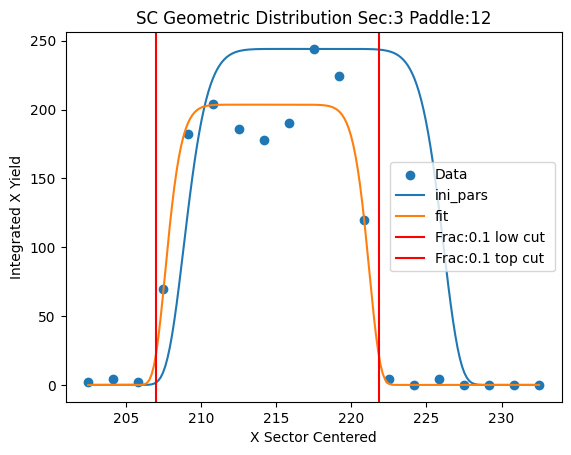

Parameters for Sec:3 Paddle:13
test pars [246.         225.83333333   5.8478792   10.28524667]
fit pars [224.50000002 228.27328746   5.2632687   89.582137  ]


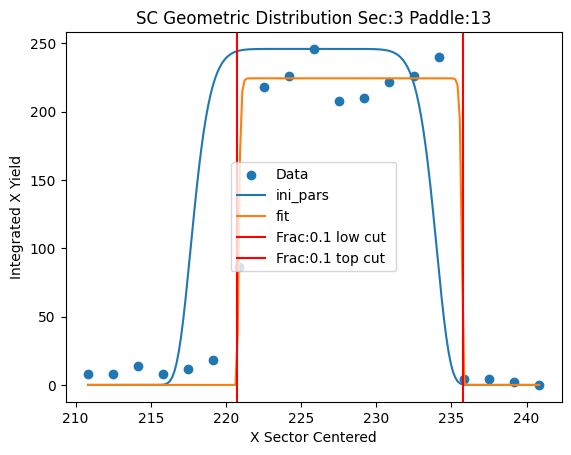

Parameters for Sec:3 Paddle:14
test pars [330.         245.83333333   6.2632687   89.582137  ]
fit pars [206.85714286 237.07301665   4.37757004 195.11713461]


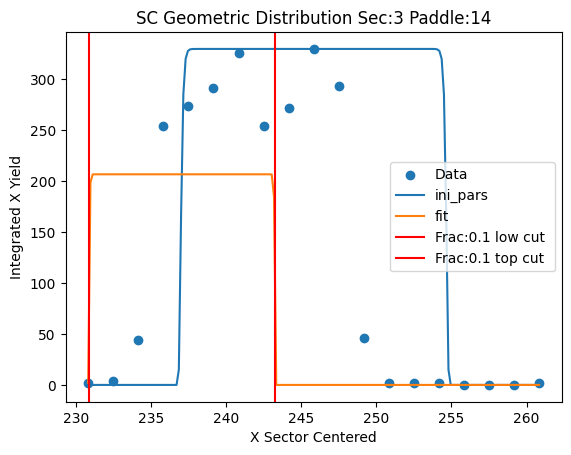

Parameters for Sec:3 Paddle:15
test pars [406.         259.16666667   5.37757004 195.11713461]
fit pars [358.75       254.6820068    5.05096165 195.36704645]


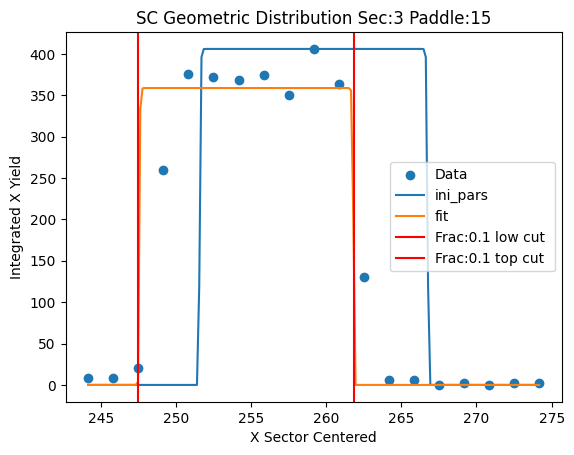

Parameters for Sec:3 Paddle:16
test pars [418.         270.83333333   6.05096165 195.36704645]
fit pars [393.42857143 268.63744299   4.34775851 423.52411129]


/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_83697/2664612452.py:3: RuntimeWarning: overflow encountered in double_scalars
  return 0.5*(2*m_ - 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_83697/2664612452.py:5: RuntimeWarning: overflow encountered in double_scalars
  return 0.5*(2*m_ + 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))


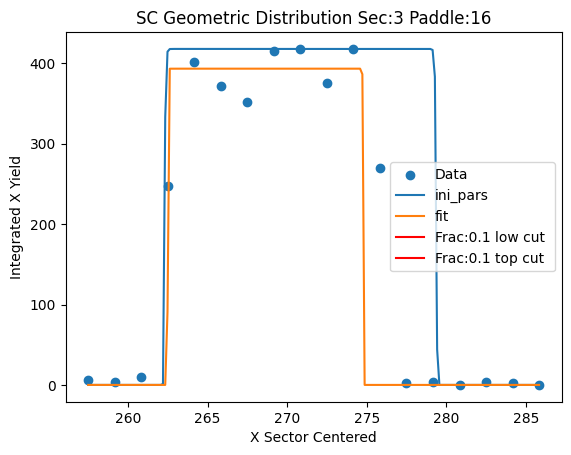

Parameters for Sec:3 Paddle:17
test pars [286.         280.83333333   5.34775851 423.52411129]
fit pars [205.33333366 280.83333333   5.34775851 423.52411129]


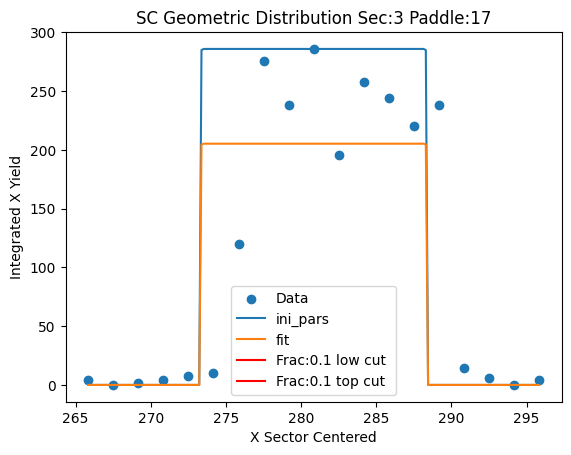

Parameters for Sec:3 Paddle:18
test pars [444.         297.5          6.34775851 423.52411129]
fit pars [282.         297.5          6.34775851 423.52411129]


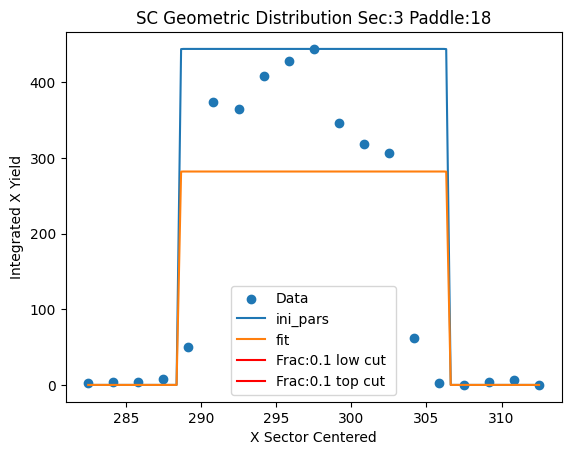

Parameters for Sec:3 Paddle:19
test pars [398.         309.16666667   7.34775851 423.52411129]
fit pars [320.88888889 309.20654211   5.35136745 423.45071559]


/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_83697/3852480128.py:4: RuntimeWarning: overflow encountered in power
  return a_*np.exp(-(np.abs(x-m_)/(np.sqrt(2)*s_))**p_)


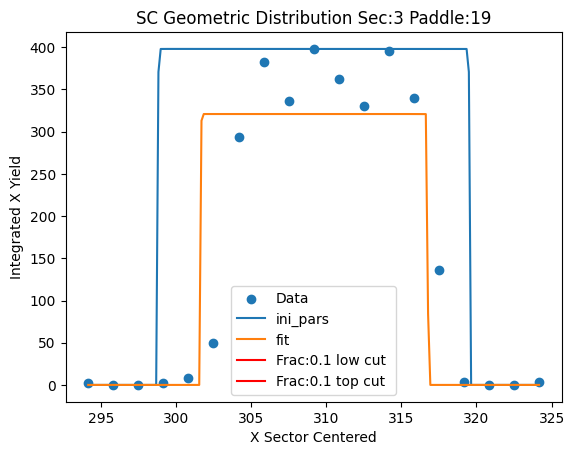

Parameters for Sec:3 Paddle:20
test pars [394.         325.83333333   6.35136745 423.45071559]
fit pars [278.90909169 325.83333333   6.35136745 423.45071559]


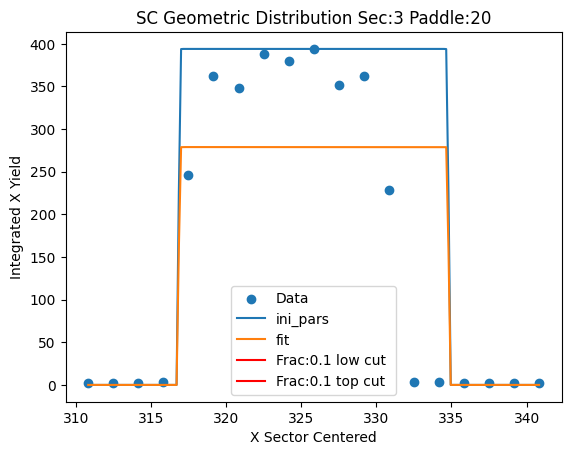

Parameters for Sec:3 Paddle:21
test pars [360.         334.16666667   7.35136745 423.45071559]
fit pars [277.55555555 335.86713485   5.8962889  423.01386021]


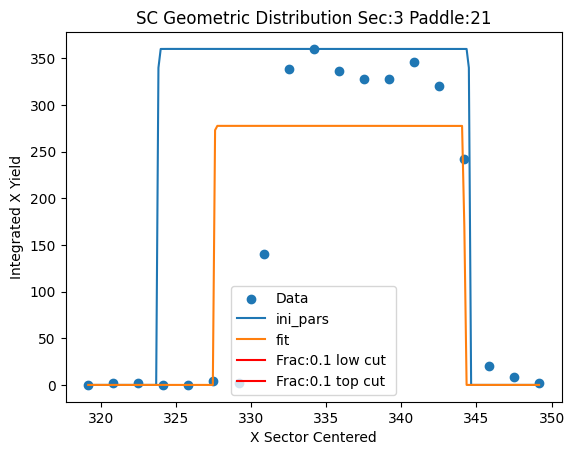

Parameters for Sec:3 Paddle:22
test pars [152.         349.16666667   6.8962889  423.01386021]
fit pars [ 95.63636364 349.16666667   6.8962889  423.01386021]


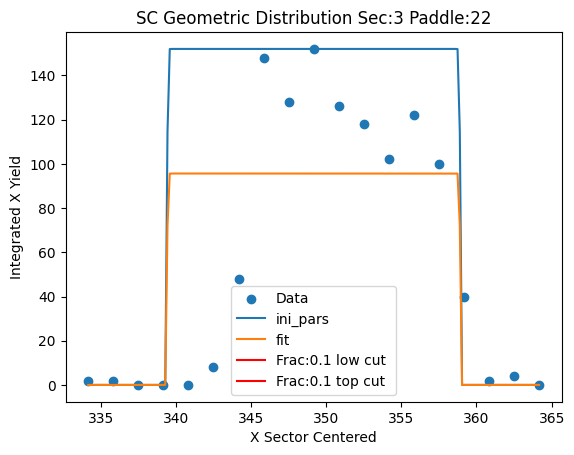

Parameters for Sec:3 Paddle:23
test pars [330.         365.83333333   7.8962889  423.01386021]
fit pars [178.76923077 365.83333333   7.8962889  423.01386021]


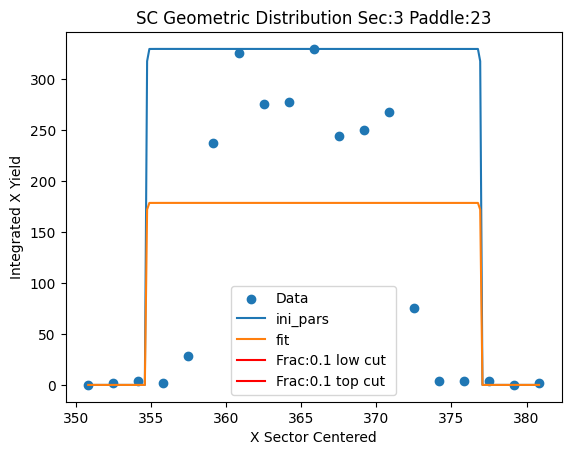

Parameters for Sec:3 Paddle:24
test pars [262.         374.16666667   8.8962889  423.01386021]
fit pars [126.80000035 374.16666667   8.8962889  423.01386021]


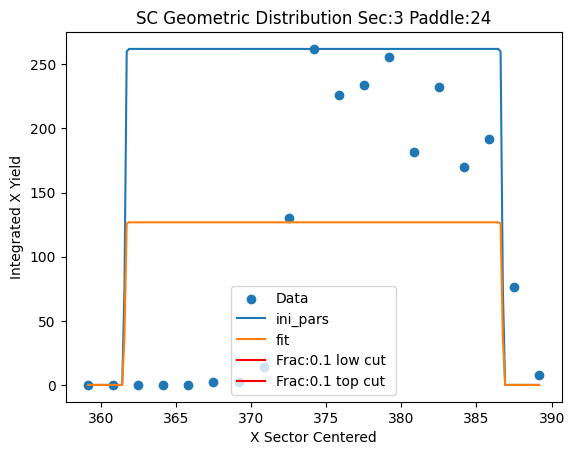

Parameters for Sec:3 Paddle:26
test pars [854.         385.83333333   9.8962889  423.01386021]
fit pars [423.71428571 385.83333333   4.38434814 187.40762841]


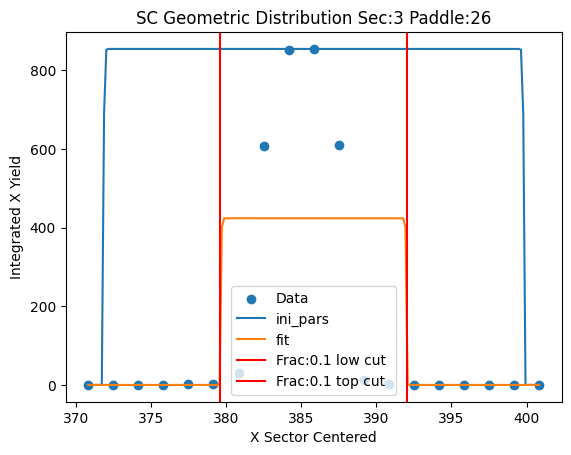

Parameters for Sec:3 Paddle:31
test pars [470.         412.5          5.38434814 187.40762841]
fit pars [295.19999845 412.64189637   3.18934585 185.29710498]


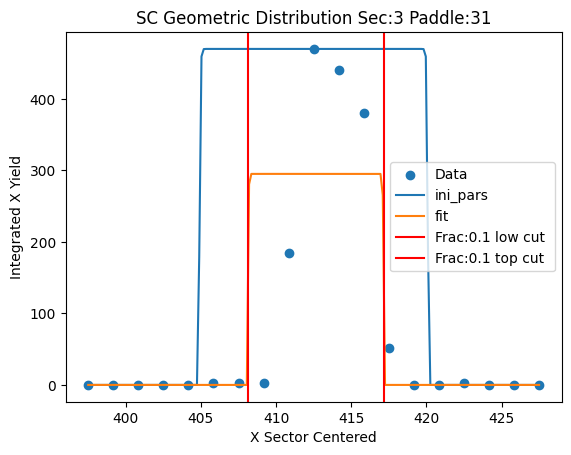

Parameters for Sec:3 Paddle:42
test pars [ 20.         399.16666667   4.18934585 185.29710498]
fit pars [ 16.57142857 399.16666667   4.18934585 185.29710498]


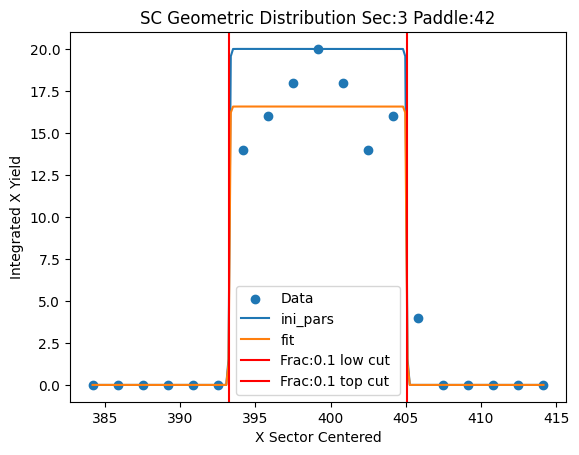

Parameters for Sec:3 Paddle:44
test pars [ 10.         370.83333333   5.18934585 185.29710498]
fit pars [ 6.42857403  0.54587233  2.64763697 94.53975123]


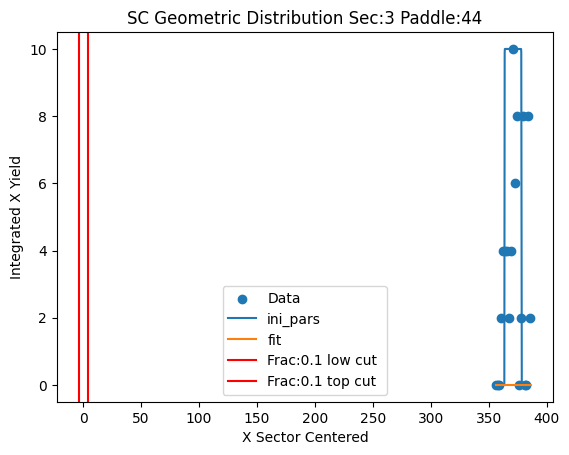

Parameters for Sec:3 Paddle:45
test pars [  8.         345.83333333   3.64763697  94.53975123]
fit pars [  3.         346.66666667   2.98217835  74.53526115]


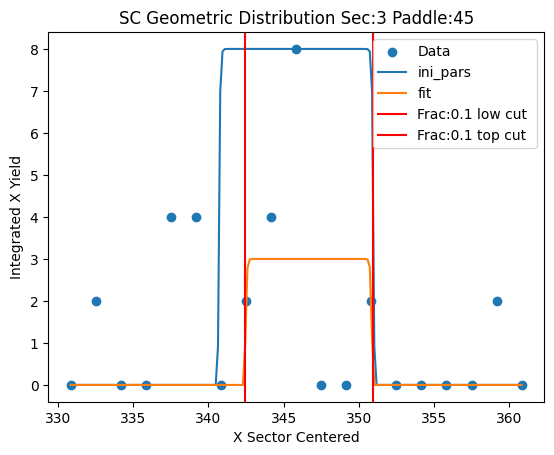

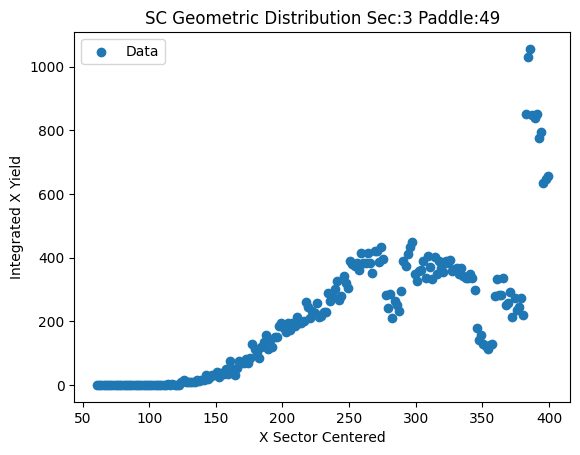

Parameters for Sec:4 Paddle:6
test pars [  8.         135.83333333   5.4          4.        ]
fit pars [  4.07292016 132.98394643   3.97162797  11.1662231 ]


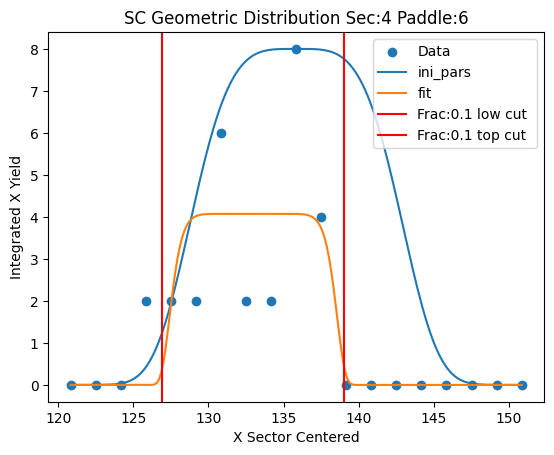

Parameters for Sec:4 Paddle:7
test pars [ 14.         150.83333333   4.97162797  11.1662231 ]
fit pars [  7.36420825 150.83332977   1.91925731   1.02443501]


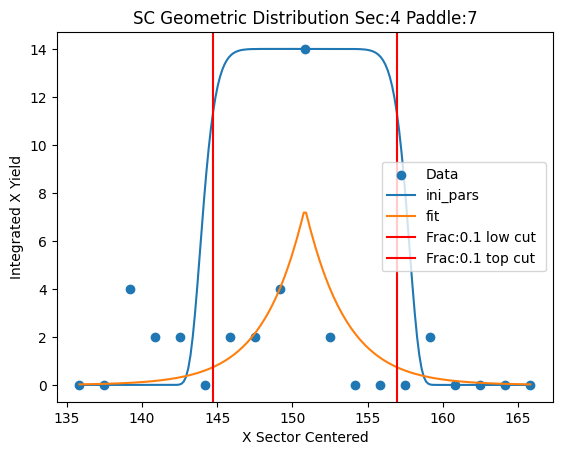

Parameters for Sec:4 Paddle:8
test pars [ 26.         162.5          2.91925731   1.02443501]
fit pars [ 24.95311078 162.49999994   1.69743939   0.6557886 ]


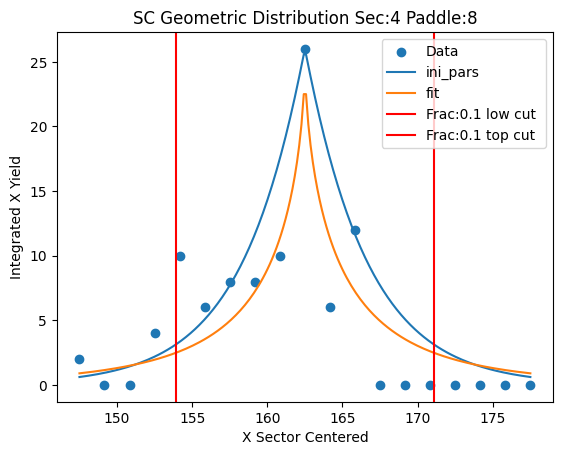

Parameters for Sec:4 Paddle:9
test pars [ 58.         175.83333333   2.69743939   0.6557886 ]
fit pars [ 56.24854576 175.76902979   3.08674139   0.88698692]


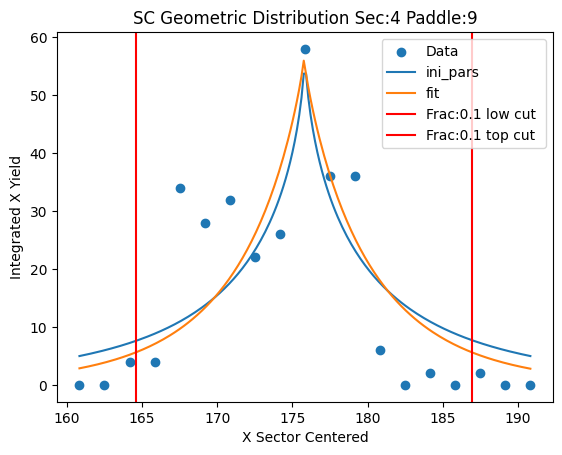

Parameters for Sec:4 Paddle:10
test pars [116.         187.5          4.08674139   0.88698692]
fit pars [108.57142933 187.45163773   4.79139769  57.74254215]


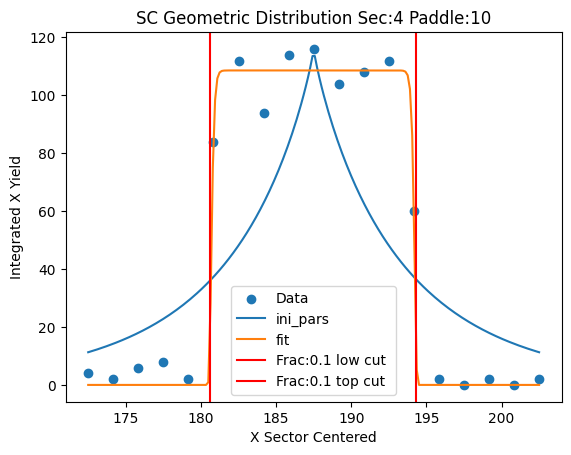

Parameters for Sec:4 Paddle:11
test pars [156.         204.16666667   5.79139769  57.74254215]
fit pars [139.14285738 200.89783361   4.76958189  64.05051286]


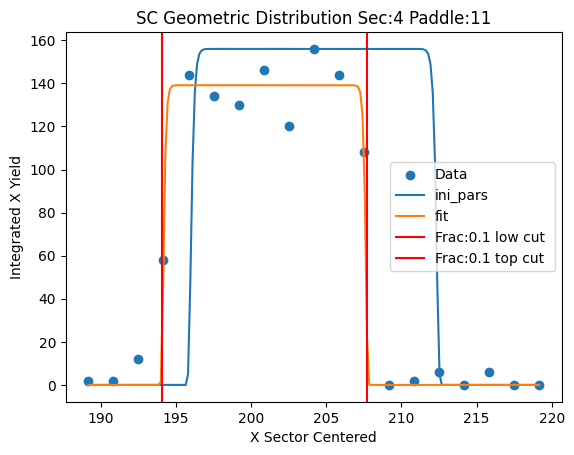

Parameters for Sec:4 Paddle:12
test pars [196.         219.16666667   5.76958189  64.05051286]
fit pars [160.44444596 215.76742933   5.83524902  83.74543611]


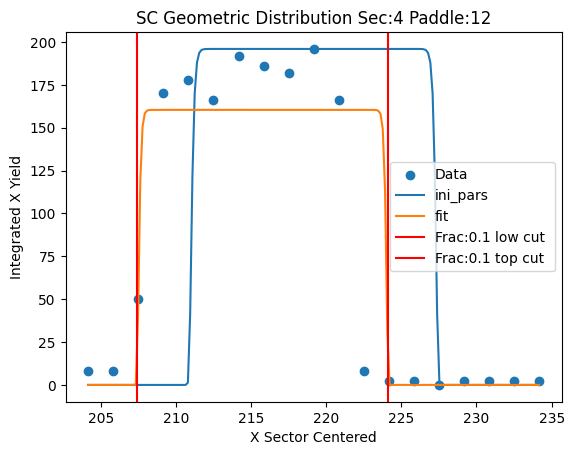

Parameters for Sec:4 Paddle:13
test pars [270.         232.5          6.83524902  83.74543611]
fit pars [245.07391015 228.56012467   5.09640225  14.63116524]


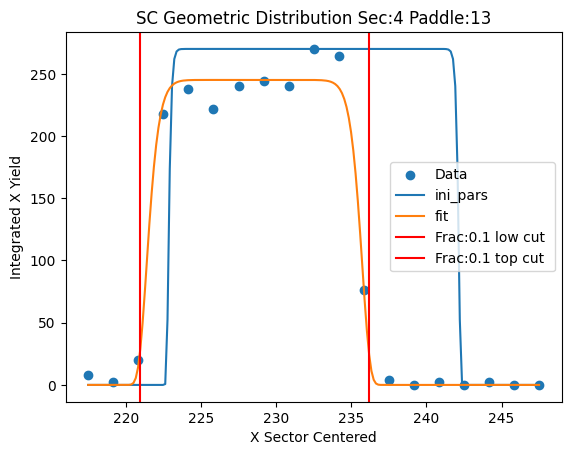

Parameters for Sec:4 Paddle:14
test pars [216.         244.16666667   6.09640225  14.63116524]
fit pars [191.32639644 242.30246507   5.17320318   8.86454268]


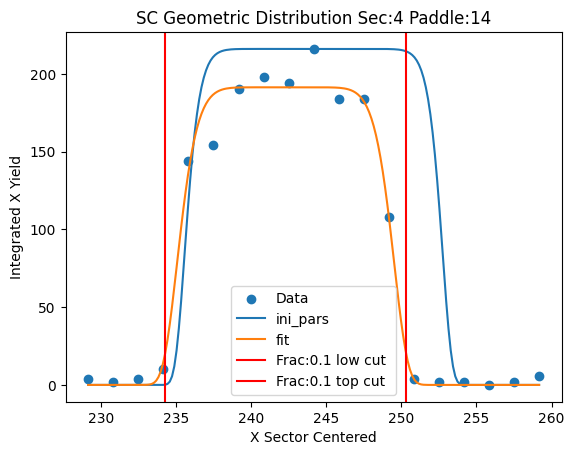

Parameters for Sec:4 Paddle:15
test pars [370.         257.5          6.17320318   8.86454268]
fit pars [347.71428812 255.87061608   4.75815173  59.21548455]


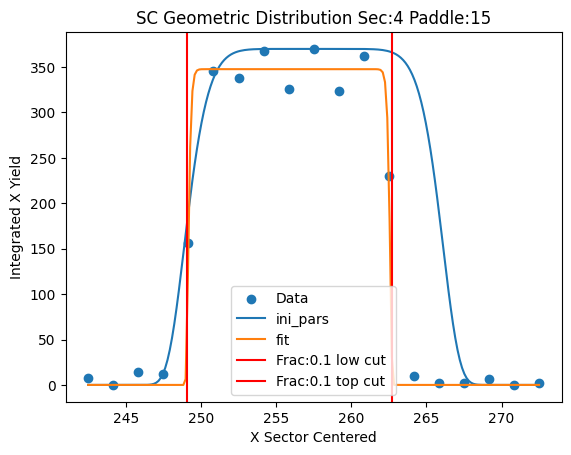

Parameters for Sec:4 Paddle:16
test pars [372.         267.5          5.75815173  59.21548455]
fit pars [344.00000156 269.9931678    5.26350767  72.96909253]


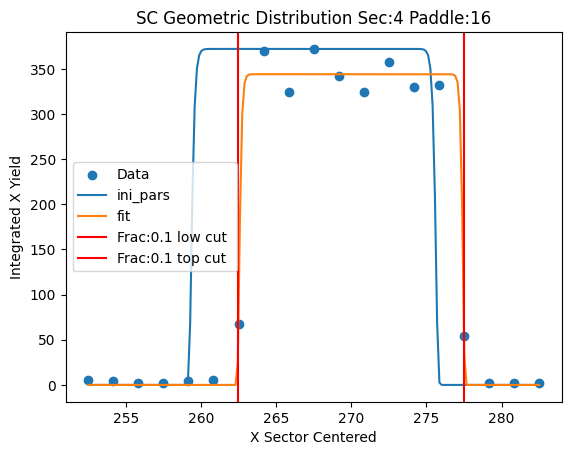

Parameters for Sec:4 Paddle:17
test pars [352.         284.16666667   6.26350767  72.96909253]
fit pars [334.25817217 283.68633996   5.09909438  11.14746074]


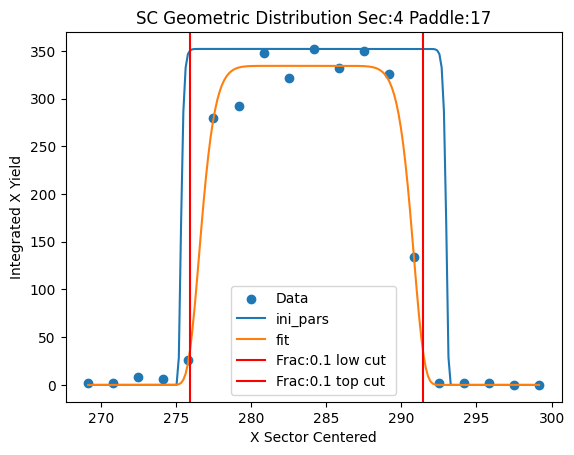

Parameters for Sec:4 Paddle:18
test pars [380.         300.83333333   6.09909438  11.14746074]
fit pars [352.85714461 297.512733     4.77112898  59.39173269]


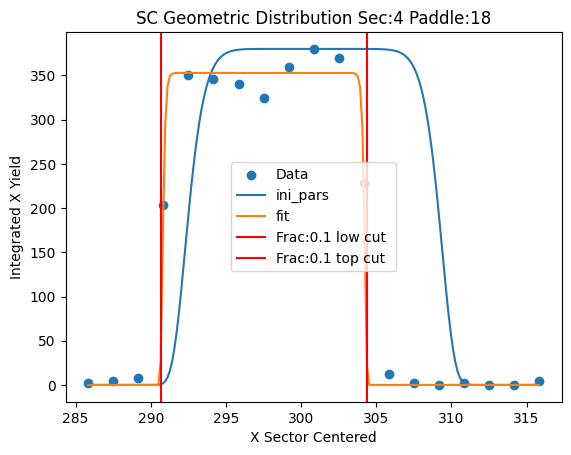

Parameters for Sec:4 Paddle:19
test pars [386.         310.83333333   5.77112898  59.39173269]
fit pars [371.60347884 311.18014817   5.14315492  10.69694837]


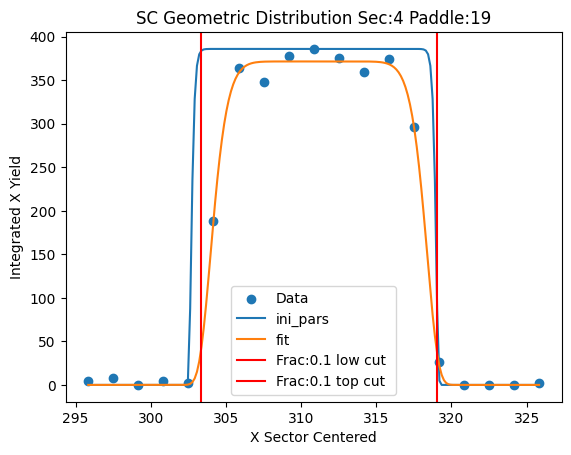

Parameters for Sec:4 Paddle:20
test pars [222.         319.16666667   6.14315492  10.69694837]
fit pars [202.00000031 324.99860988   5.28304319  76.07790489]


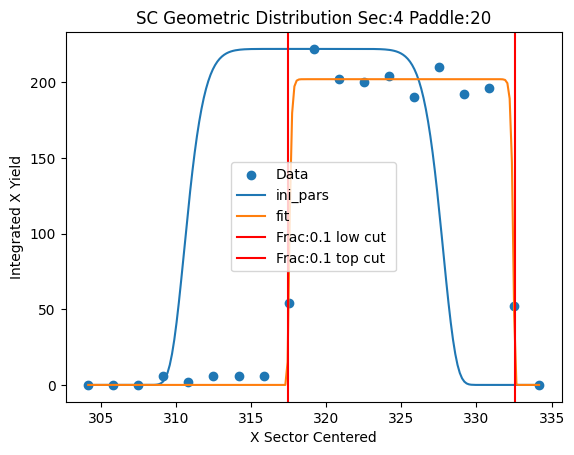

Parameters for Sec:4 Paddle:21
test pars [392.         337.5          6.28304319  76.07790489]
fit pars [336.07850231 338.79306768   5.04101422   8.17736215]


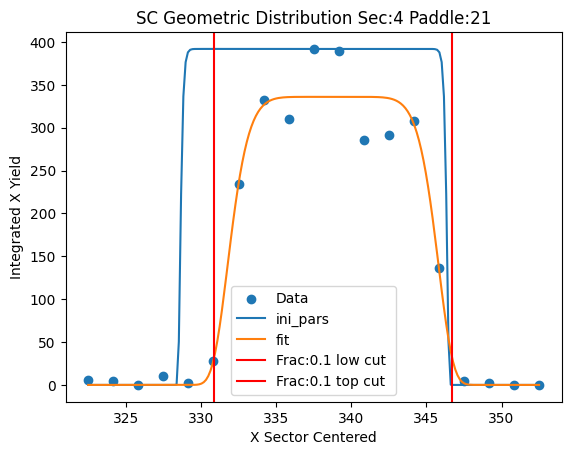

Parameters for Sec:4 Paddle:22
test pars [378.         350.83333333   6.04101422   8.17736215]
fit pars [321.35857959 352.37709084   5.10884942   7.43116055]


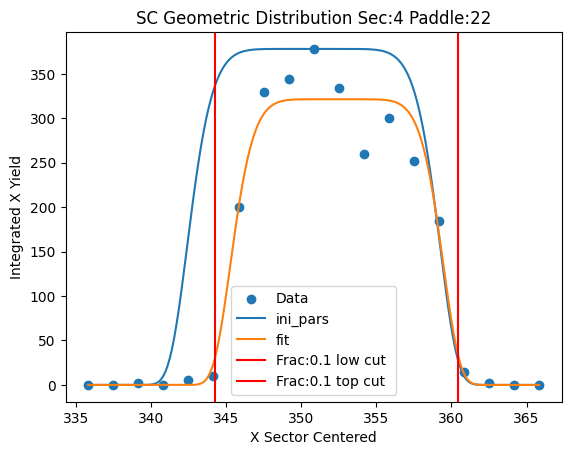

Parameters for Sec:4 Paddle:23
test pars [316.         364.16666667   6.10884942   7.43116055]
fit pars [296.72776228 366.11844184   4.97898849   9.75993399]


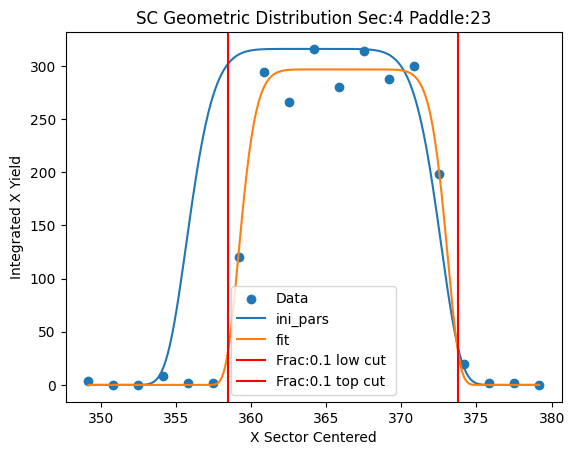

Parameters for Sec:4 Paddle:24
test pars [284.         385.83333333   5.97898849   9.75993399]
fit pars [255.33490173 380.45431782   5.63379684   9.45997472]


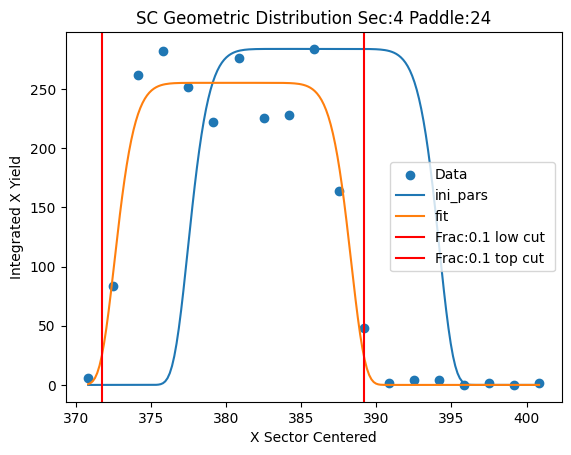

Parameters for Sec:4 Paddle:25
test pars [810.         380.83333333   6.63379684   9.45997472]
fit pars [775.57624515 379.4753364    2.27198978   9.26678062]


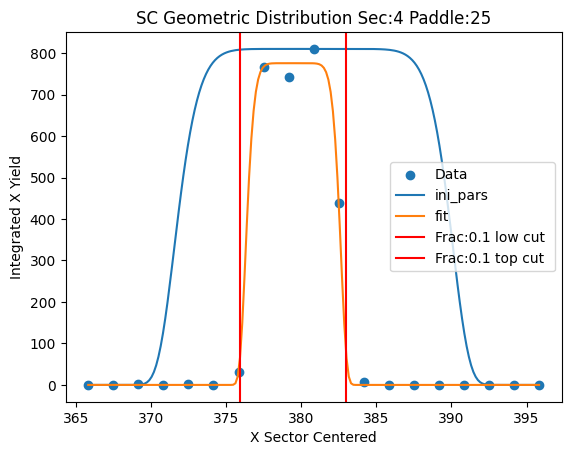

Parameters for Sec:4 Paddle:26
test pars [754.         387.5          3.27198978   9.26678062]
fit pars [722.0000008  385.78860361   2.33615498  29.7645194 ]


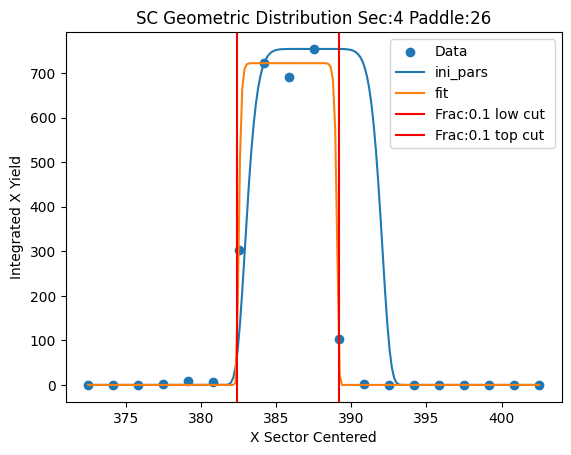

Parameters for Sec:4 Paddle:28
test pars [568.         395.83333333   3.33615498  29.7645194 ]
fit pars [538.7308069  396.9903973    2.17698257   4.05199988]


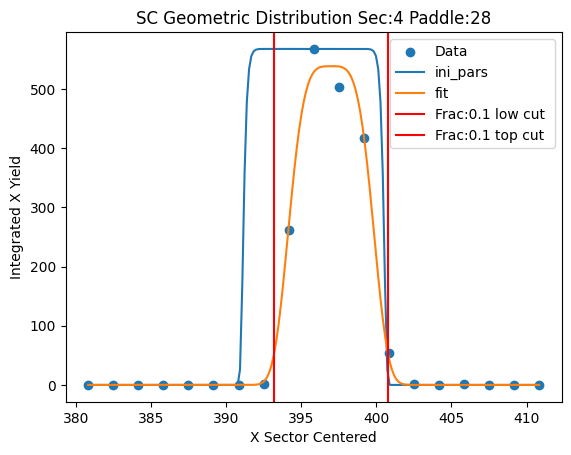

Parameters for Sec:4 Paddle:41
test pars [ 30.         412.5          3.17698257   4.05199988]
fit pars [ 23.66666668 411.72750064   4.10735853  61.91672049]


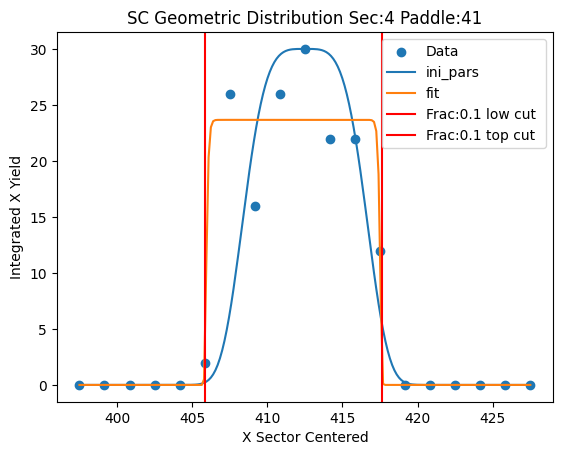

Parameters for Sec:4 Paddle:43
test pars [ 22.         387.5          5.10735853  61.91672049]
fit pars [ 19.         390.01668012   2.98966712  41.73424714]


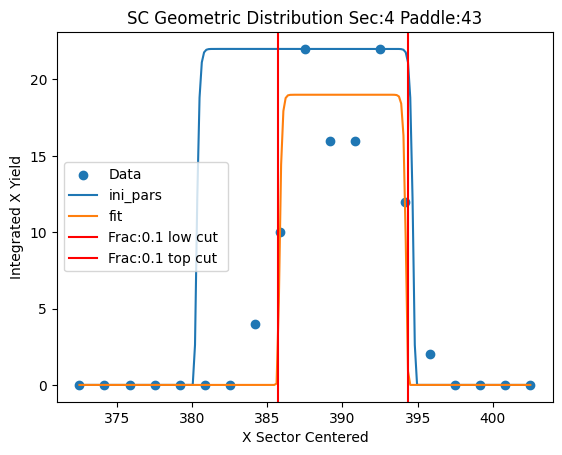

Parameters for Sec:4 Paddle:44
test pars [ 10.         387.5          3.98966712  41.73424714]
fit pars [  7.75028259 384.70744731   5.26549379  41.755512  ]


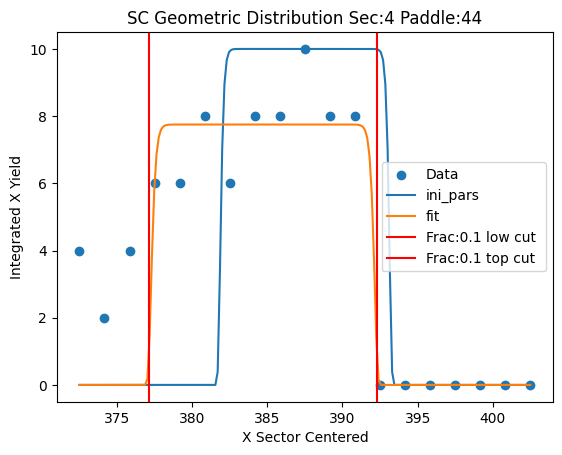

Parameters for Sec:4 Paddle:45
test pars [ 10.         357.5          6.26549379  41.755512  ]
fit pars [  5.35267705 353.4605005    7.53726096   3.65421613]


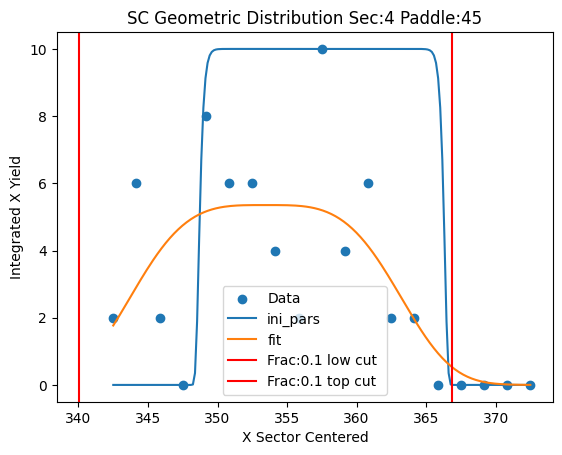

Parameters for Sec:4 Paddle:46
test pars [  8.         309.16666667   8.53726096   3.65421613]
fit pars [  4.         311.15046589   2.49876582  71.3339018 ]


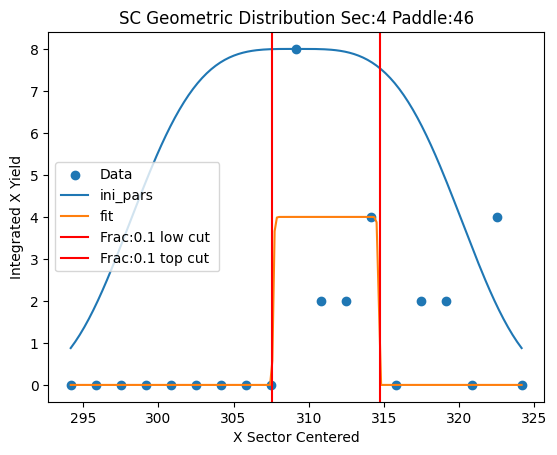

Parameters for Sec:4 Paddle:47
test pars [ 12.         300.83333333   3.49876582  71.3339018 ]
fit pars [  3.19999998 300.83333333   3.49876582 217.34301591]


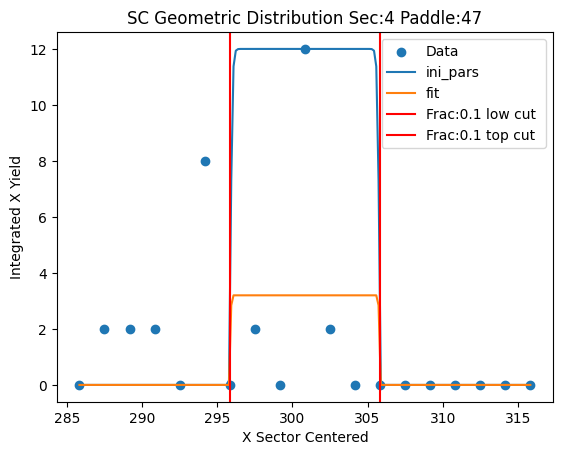

Parameters for Sec:4 Paddle:48
test pars [  6.         260.83333333   4.49876582 217.34301591]
fit pars [  2.57142861 260.83333333   4.49876582 217.34301591]


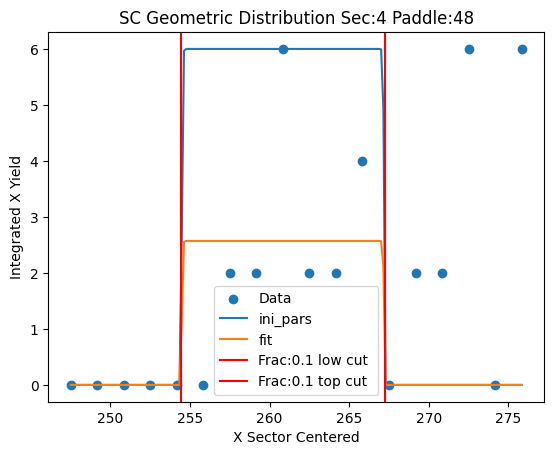

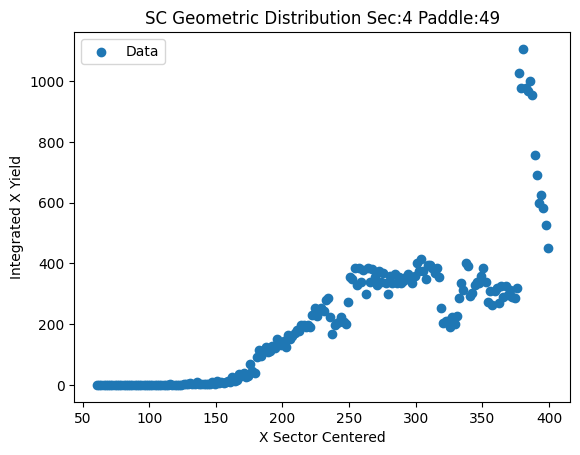

Parameters for Sec:5 Paddle:6
test pars [ 14.  127.5   5.4   4. ]
fit pars [  9.42857143 132.52834132   4.70437686  69.67617967]


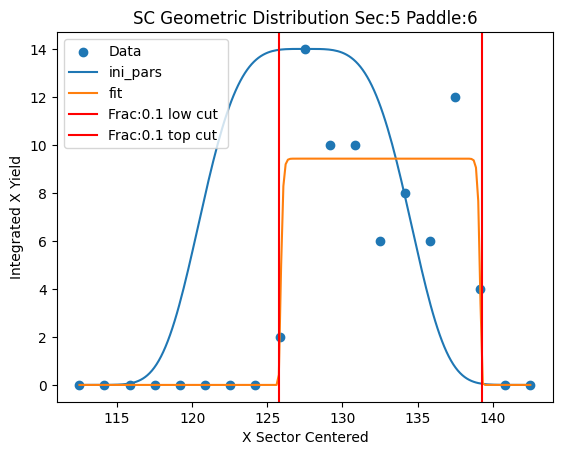

Parameters for Sec:5 Paddle:7
test pars [  8.         140.83333333   5.70437686  69.67617967]
fit pars [  3.99999998 187.54545767  34.23335377 513.4406694 ]


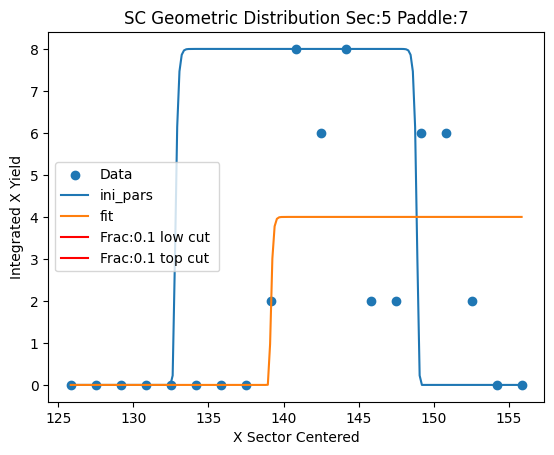

Parameters for Sec:5 Paddle:8
test pars [ 22.         162.5         35.23335377 513.4406694 ]
fit pars [  6.94736844 162.5         35.23335377 513.4406694 ]


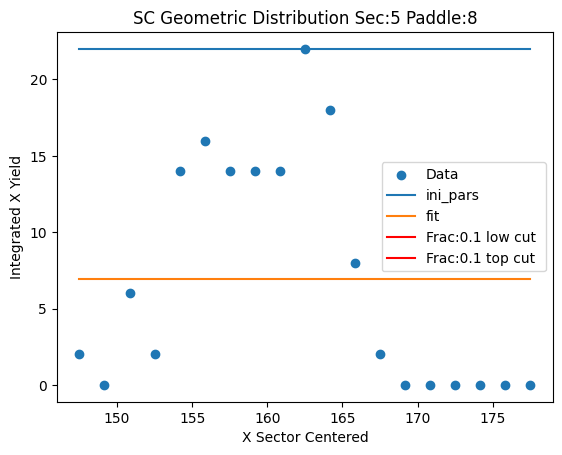

Parameters for Sec:5 Paddle:9
test pars [106.         170.83333333  36.23335377 513.4406694 ]
fit pars [ 35.57894742 170.83333333  36.23335377 513.4406694 ]


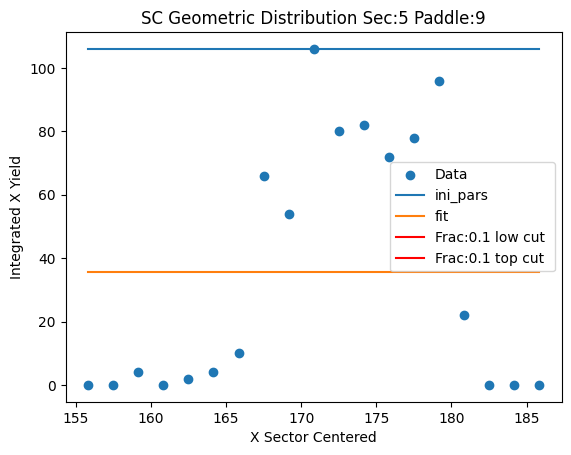

Parameters for Sec:5 Paddle:10
test pars [ 36.         190.83333333  37.23335377 513.4406694 ]
fit pars [ 14.4210526  190.83333333  37.23335377 513.4406694 ]


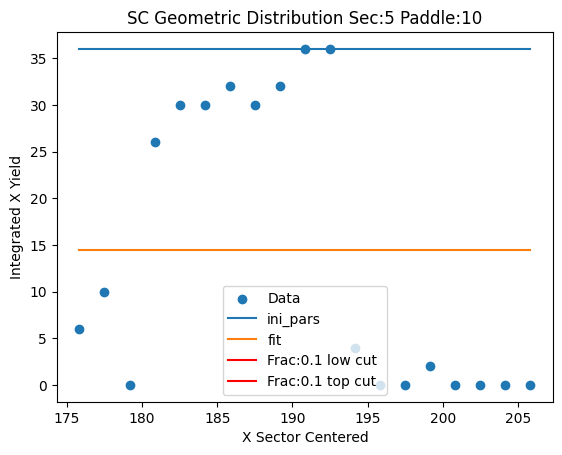

Parameters for Sec:5 Paddle:11
test pars [ 80.         197.5         38.23335377 513.4406694 ]
fit pars [ 31.05263166 197.5         38.23335377 513.4406694 ]


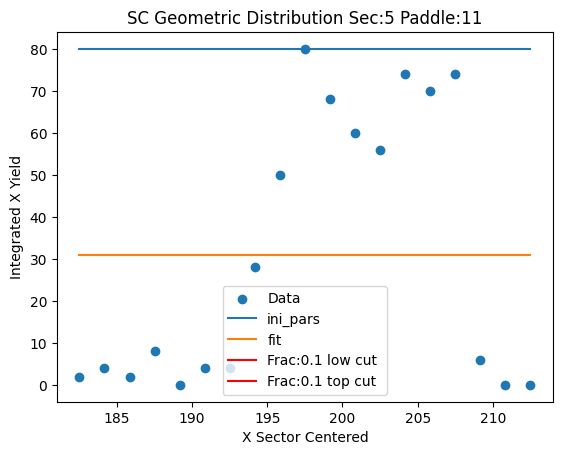

Parameters for Sec:5 Paddle:12
test pars [148.         219.16666667  39.23335377 513.4406694 ]
fit pars [ 47.47368407 219.16666667  39.23335377 513.4406694 ]


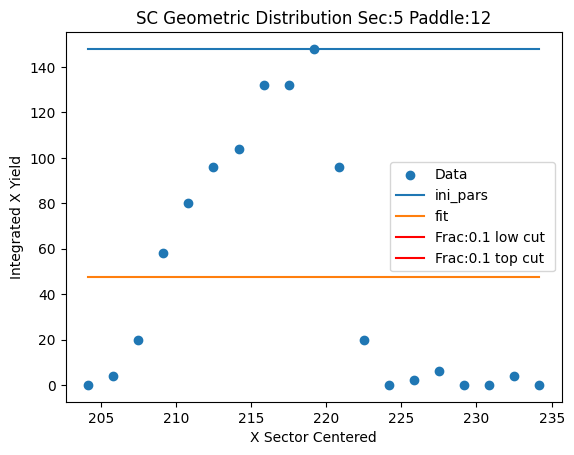

Parameters for Sec:5 Paddle:13
test pars [274.         232.5         40.23335377 513.4406694 ]
fit pars [103.5789476  232.5         40.23335377 513.4406694 ]


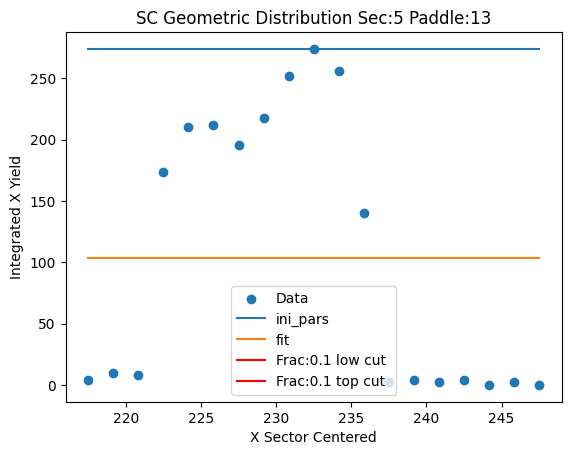

Parameters for Sec:5 Paddle:14
test pars [226.         245.83333333  41.23335377 513.4406694 ]
fit pars [ 90.10526301 245.83333333  41.23335377 513.4406694 ]


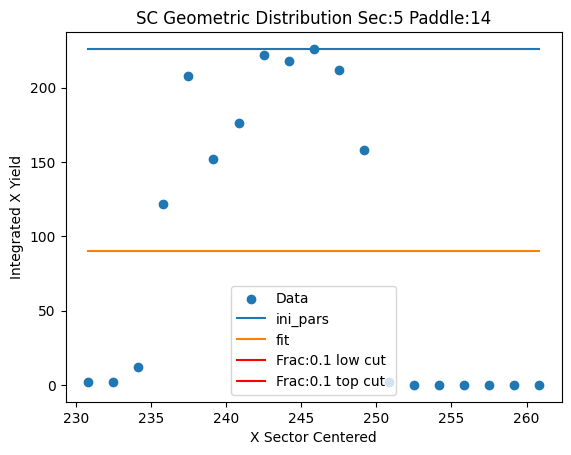

Parameters for Sec:5 Paddle:15
test pars [322.         260.83333333  42.23335377 513.4406694 ]
fit pars [130.11111111 260.83333333  42.23335377 513.4406694 ]


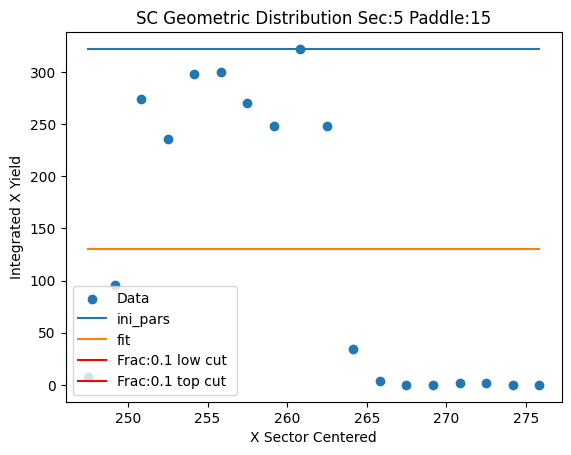

Parameters for Sec:5 Paddle:16
test pars [250.         274.16666667  43.23335377 513.4406694 ]
fit pars [ 97.05263172 274.16666667  43.23335377 513.4406694 ]


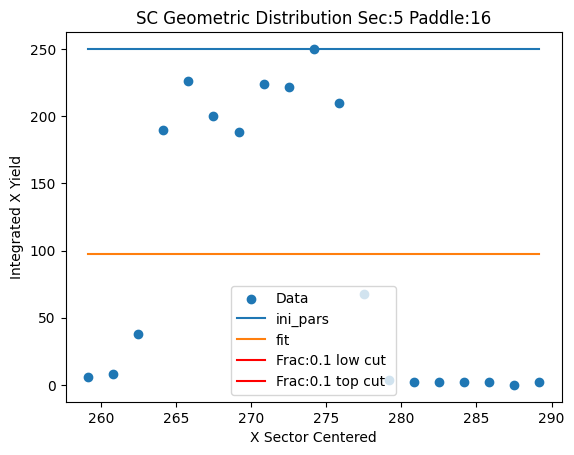

Parameters for Sec:5 Paddle:17
test pars [412.         284.16666667  44.23335377 513.4406694 ]
fit pars [166.73684211 284.16666667  44.23335377 513.4406694 ]


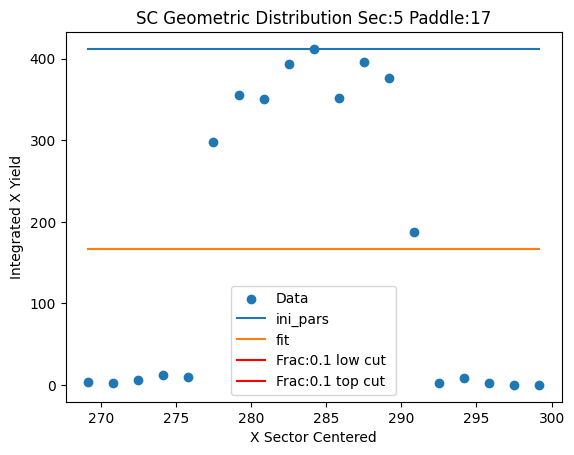

Parameters for Sec:5 Paddle:18
test pars [378.         299.16666667  45.23335377 513.4406694 ]
fit pars [145.47368421 299.16666667  45.23335377 513.4406694 ]


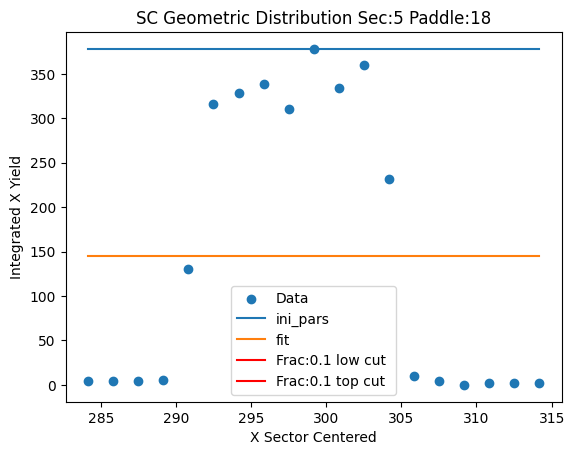

Parameters for Sec:5 Paddle:19
test pars [396.         309.16666667  46.23335377 513.4406694 ]
fit pars [162.84210526 309.16666667  46.23335377 513.4406694 ]


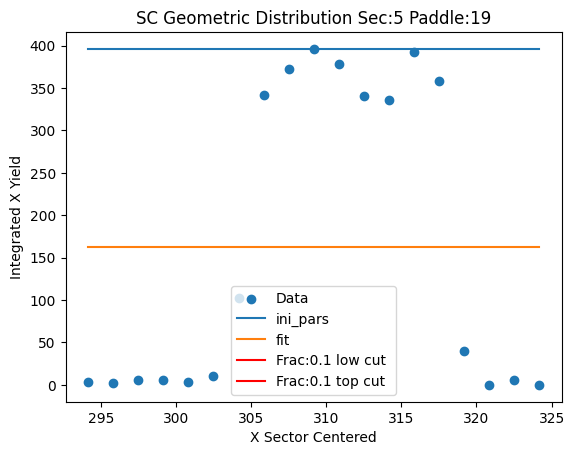

Parameters for Sec:5 Paddle:20
test pars [410.         329.16666667  47.23335377 513.4406694 ]
fit pars [165.26315789 329.16666667  47.23335377 513.4406694 ]


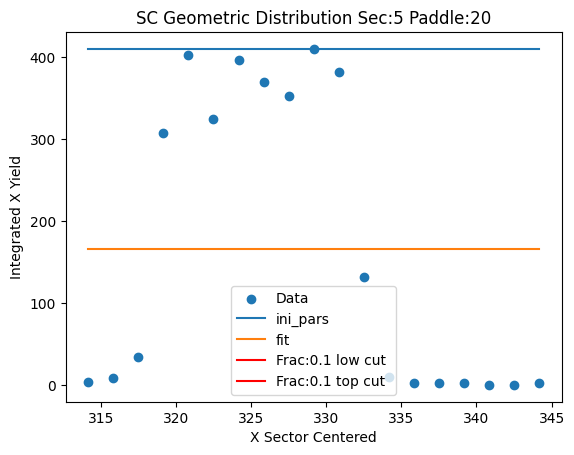

Parameters for Sec:5 Paddle:21
test pars [ 60.         334.16666667  48.23335377 513.4406694 ]
fit pars [ 21.3684211  334.16666667  48.23335377 513.4406694 ]


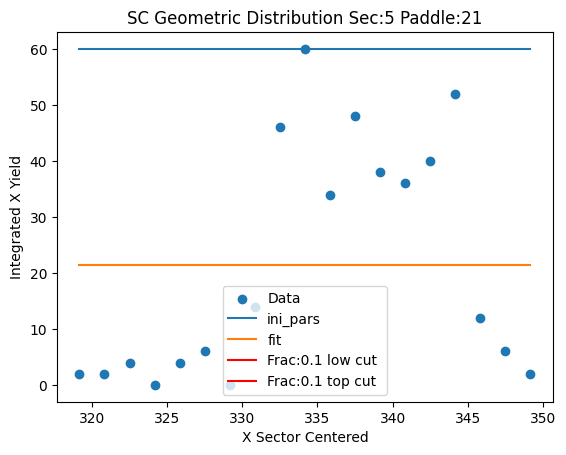

Parameters for Sec:5 Paddle:22
test pars [310.         347.5         49.23335377 513.4406694 ]
fit pars [117.47368421 347.5         49.23335377 513.4406694 ]


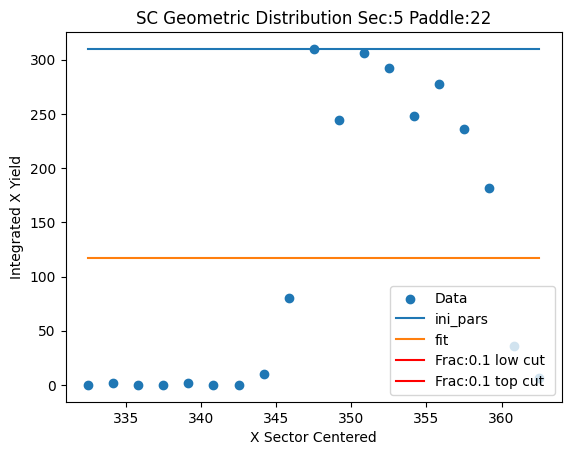

Parameters for Sec:5 Paddle:23
test pars [342.         362.5         50.23335377 513.4406694 ]
fit pars [127.68421011 362.5         50.23335377 513.4406694 ]


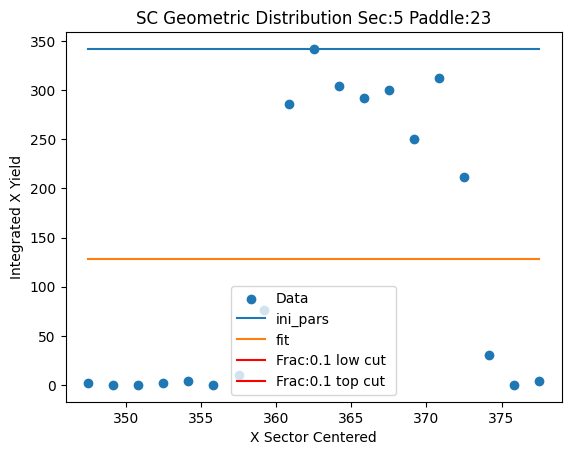

Parameters for Sec:5 Paddle:24
test pars [338.         375.83333333  51.23335377 513.4406694 ]
fit pars [119.47368448 375.83333333  51.23335377 513.4406694 ]


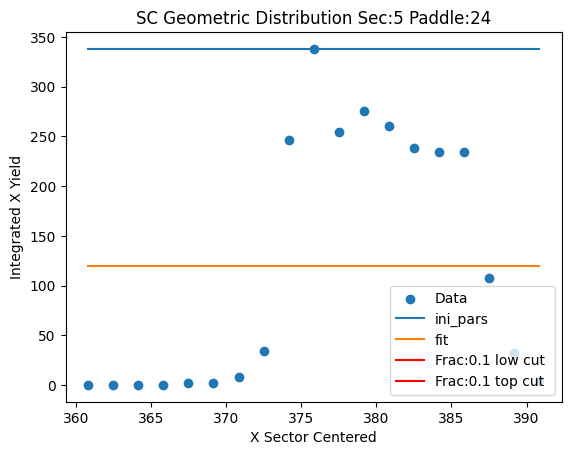

Parameters for Sec:5 Paddle:25
test pars [888.         377.5         52.23335377 513.4406694 ]
fit pars [161.57894737 377.5         52.23335377 513.4406694 ]


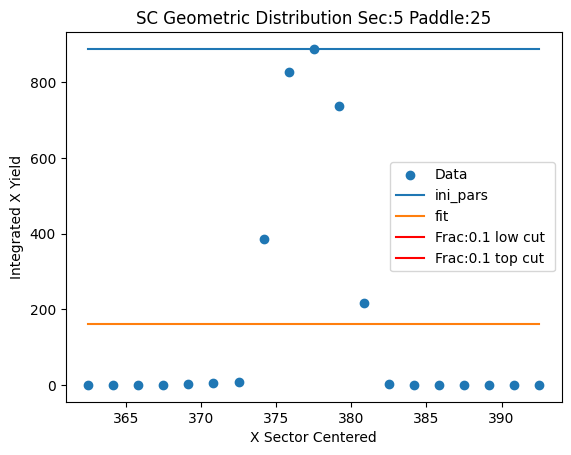

Parameters for Sec:5 Paddle:26
test pars [786.         382.5         53.23335377 513.4406694 ]
fit pars [142.73684496 382.5         53.23335377 513.4406694 ]


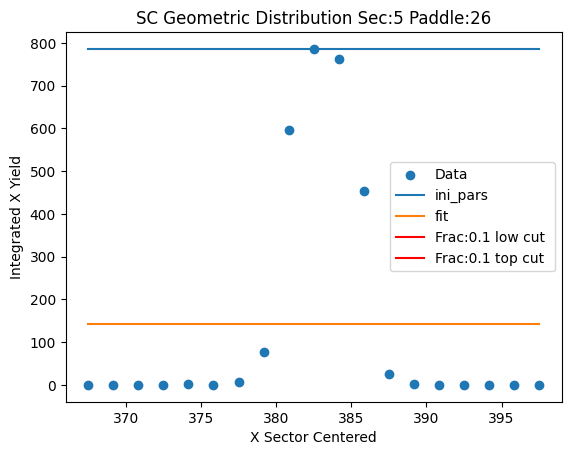

Parameters for Sec:5 Paddle:27
test pars [264.         389.16666667  54.23335377 513.4406694 ]
fit pars [ 48.63157831 389.16666667  54.23335377 513.4406694 ]


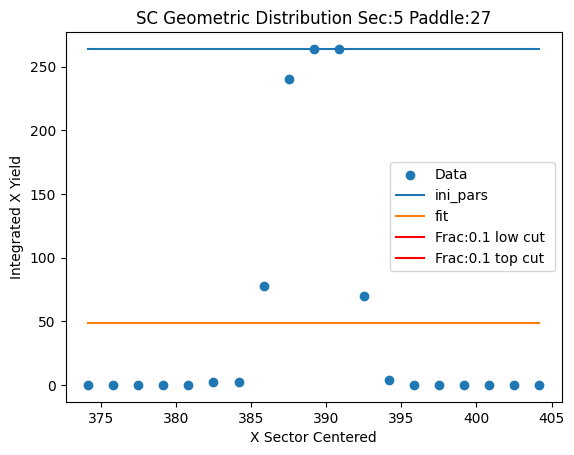

Parameters for Sec:5 Paddle:28
test pars [168.         394.16666667  55.23335377 513.4406694 ]
fit pars [ 30.3157897  394.16666667  55.23335377 513.4406694 ]


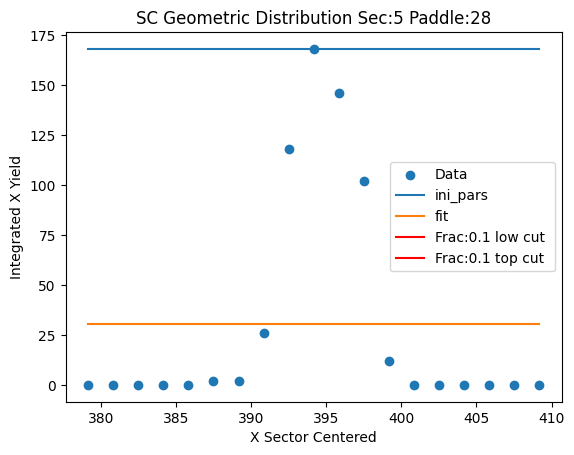

Parameters for Sec:5 Paddle:29
test pars [628.         400.83333333  56.23335377 513.4406694 ]
fit pars [111.68420891 400.83333333  56.23335377 513.4406694 ]


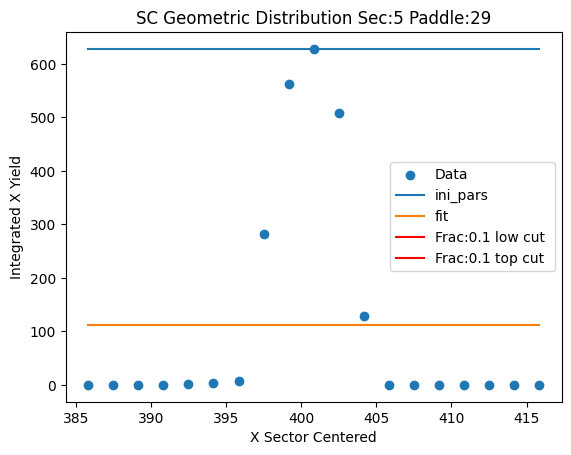

Parameters for Sec:5 Paddle:30
test pars [548.         407.5         57.23335377 513.4406694 ]
fit pars [ 96.94736772 407.5         57.23335377 513.4406694 ]


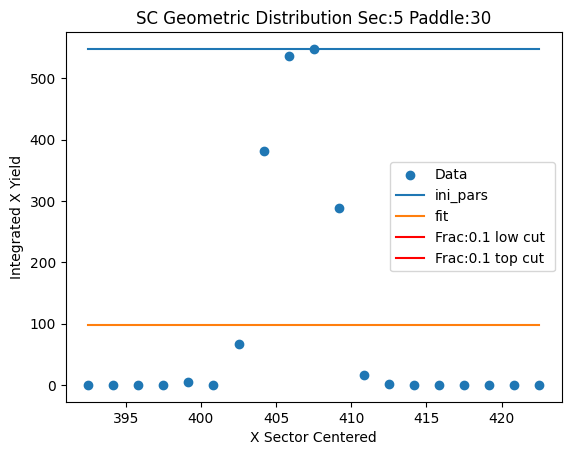

Parameters for Sec:5 Paddle:36
test pars [ 72.         442.5         58.23335377 513.4406694 ]
fit pars [ 11.68421032 442.5         58.23335377 513.4406694 ]


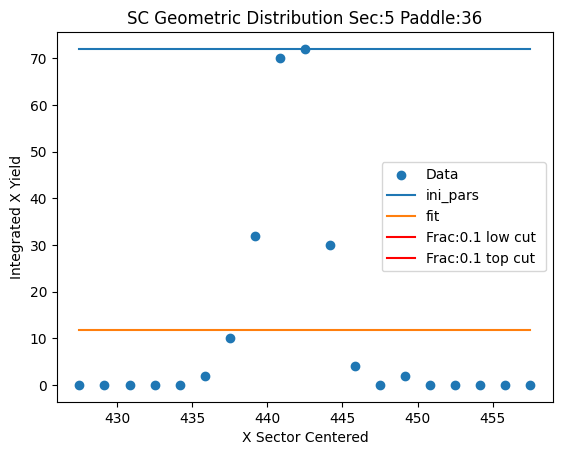

Parameters for Sec:5 Paddle:41
test pars [ 44.         409.16666667  59.23335377 513.4406694 ]
fit pars [ 10.73684206 409.16666667  59.23335377 513.4406694 ]


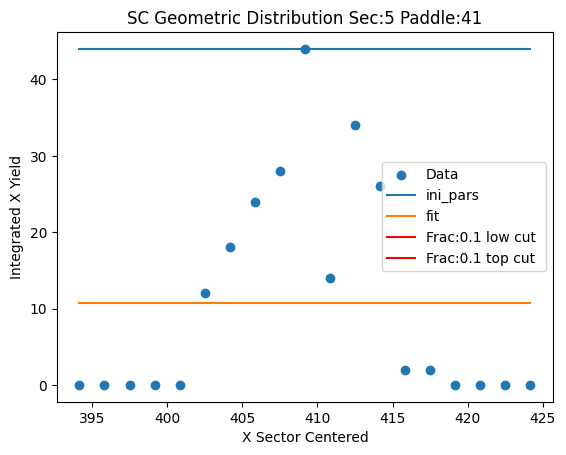

Parameters for Sec:5 Paddle:42
test pars [ 26.         399.16666667  60.23335377 513.4406694 ]
fit pars [  6.42105274 399.16666667  60.23335377 513.4406694 ]


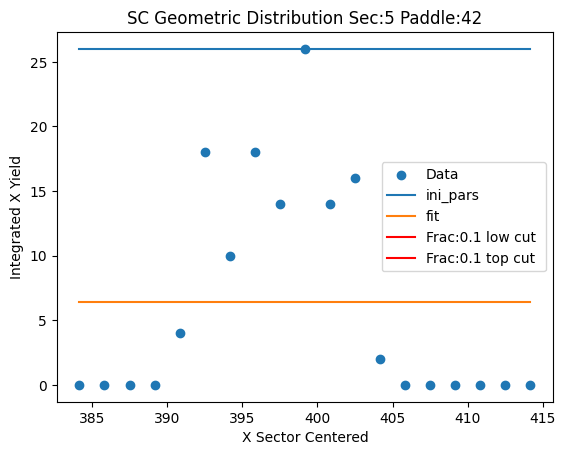

Parameters for Sec:5 Paddle:44
test pars [  8.         369.16666667  61.23335377 513.4406694 ]
fit pars [  2.63157894 369.16666667  61.23335377 513.4406694 ]


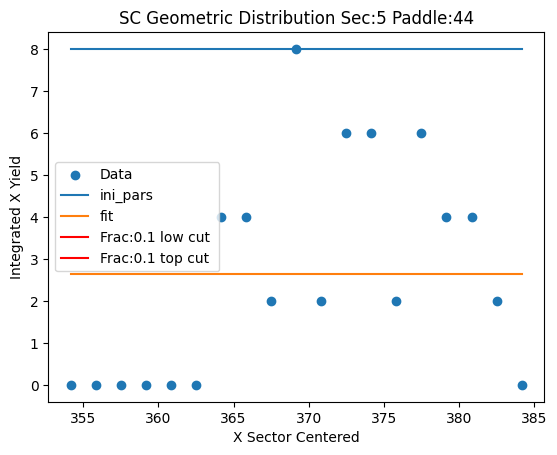

Parameters for Sec:5 Paddle:45
test pars [  8.         335.83333333  62.23335377 513.4406694 ]
fit pars [  2.63157895 335.83333333  62.23335377 513.4406694 ]


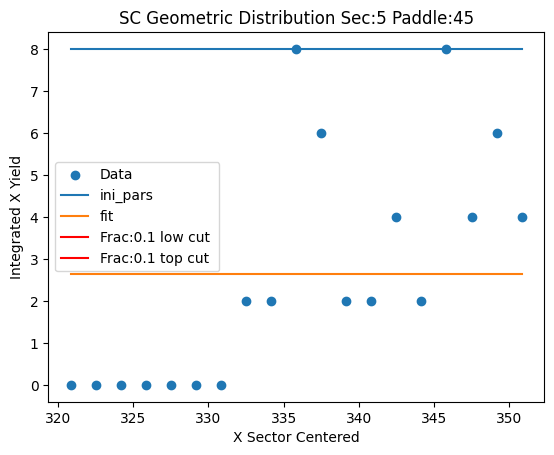

Parameters for Sec:5 Paddle:46
test pars [ 10.         305.83333333  63.23335377 513.4406694 ]
fit pars [  1.57894737 305.83333333  63.23335377 513.4406694 ]


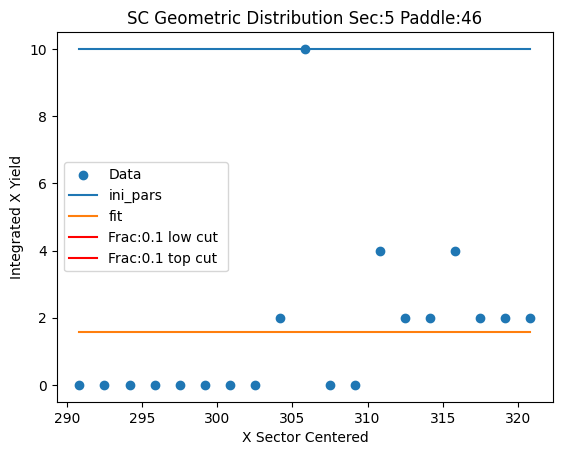

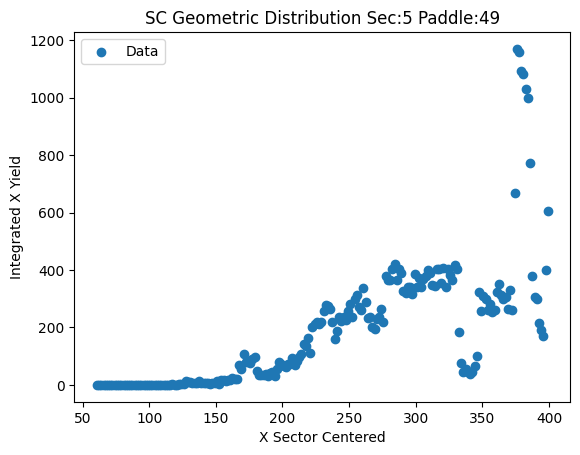

Parameters for Sec:6 Paddle:6
test pars [ 16.         135.83333333   5.4          4.        ]
fit pars [ 13.33333333 133.208644     4.07280956  75.25839748]


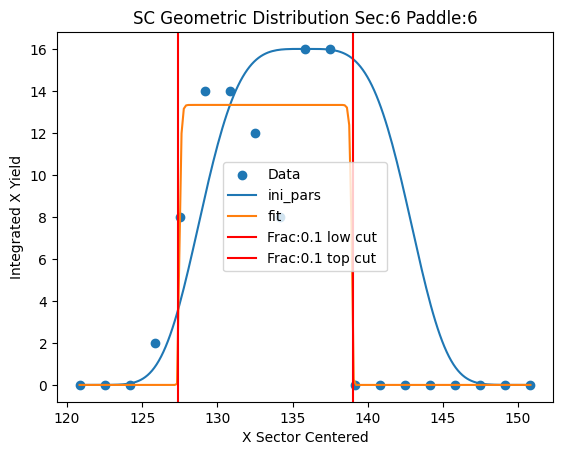

Parameters for Sec:6 Paddle:7
test pars [ 20.         145.83333333   5.07280956  75.25839748]
fit pars [ 15.6000001  145.89061946   3.61162729  40.76348891]


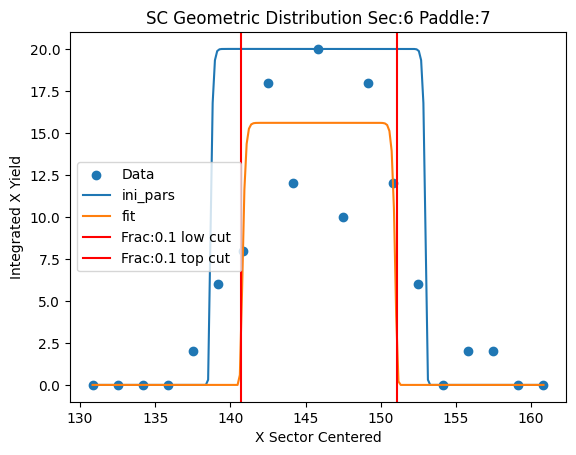

Parameters for Sec:6 Paddle:8
test pars [ 34.         160.83333333   4.61162729  40.76348891]
fit pars [ 22.74999998 160.43047976   4.97086622 157.93028697]


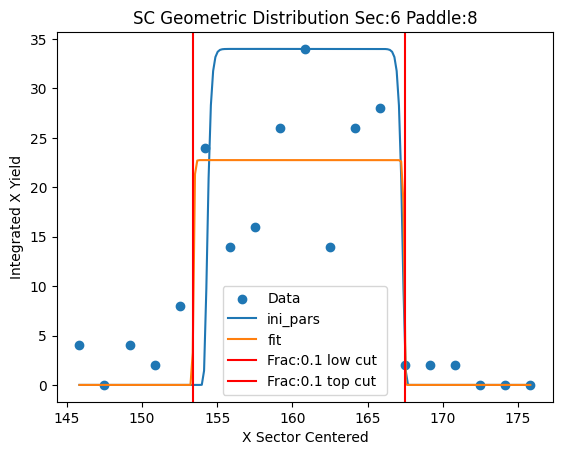

Parameters for Sec:6 Paddle:9
test pars [106.         175.83333333   5.97086622 157.93028697]
fit pars [ 85.33333333 172.4079535    5.71158768 115.00543219]


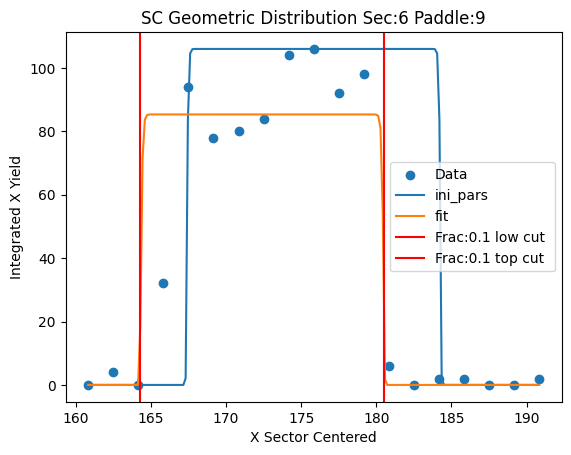

Parameters for Sec:6 Paddle:10
test pars [138.         192.5          6.71158768 115.00543219]
fit pars [90.6859925   0.38119083  3.96959634 68.02043938]


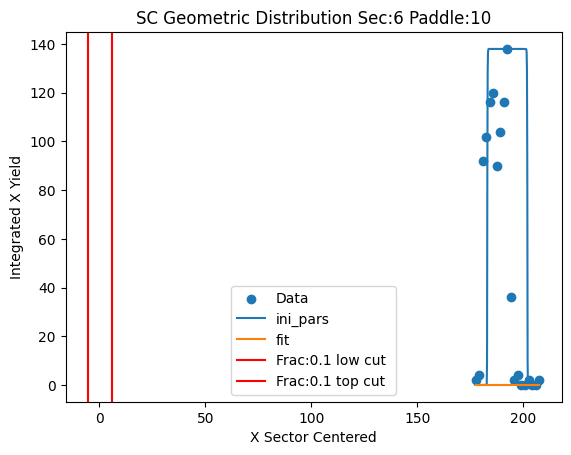

Parameters for Sec:6 Paddle:11
test pars [174.         197.5          4.96959634  68.02043938]
fit pars [152.28571476 200.78906546   4.77351917  61.45486974]


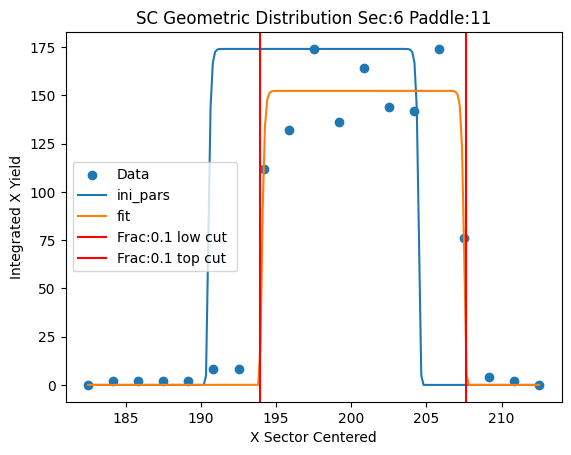

Parameters for Sec:6 Paddle:12
test pars [202.         219.16666667   5.77351917  61.45486974]
fit pars [180.46694246 214.58141962   5.1002489   10.55452679]


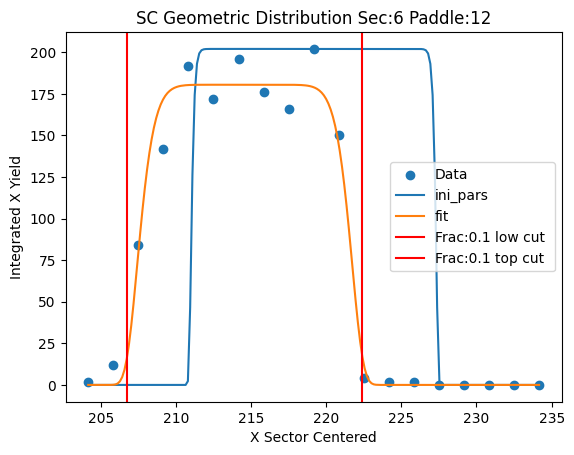

Parameters for Sec:6 Paddle:13
test pars [306.         232.5          6.1002489   10.55452679]
fit pars [242.25000847 228.28991518   5.25341331  65.66194934]


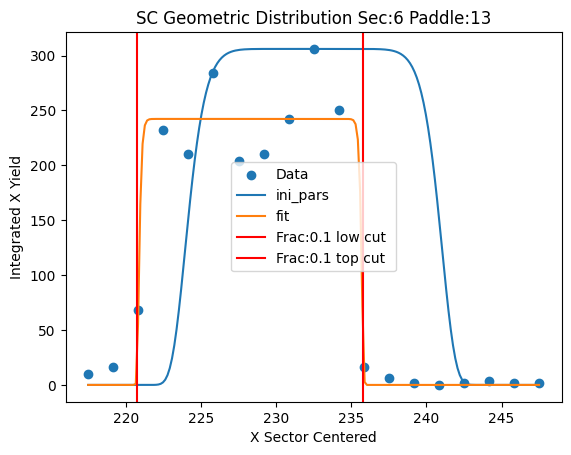

Parameters for Sec:6 Paddle:14
test pars [304.         245.83333333   6.25341331  65.66194934]
fit pars [228.44444444 242.8159686    5.62673817 207.23697324]


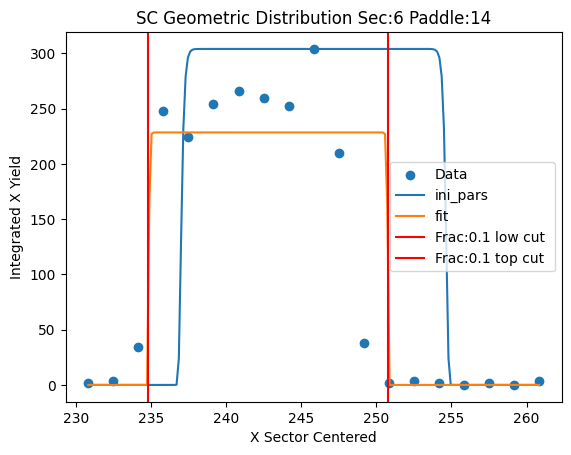

Parameters for Sec:6 Paddle:15
test pars [390.         260.83333333   6.62673817 207.23697324]
fit pars [280.8888887  245.89668218  11.78520677 246.12854556]


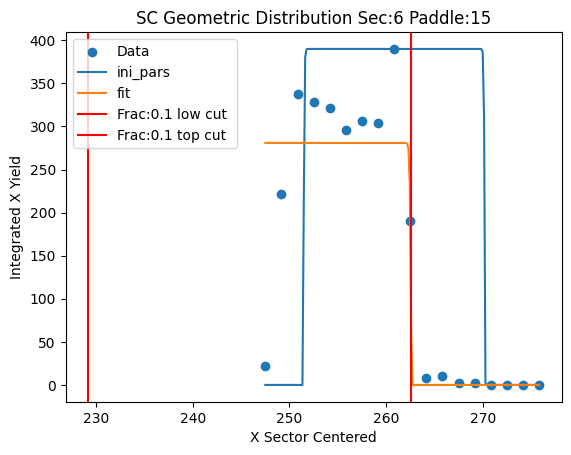

Parameters for Sec:6 Paddle:16
test pars [384.         270.83333333  12.78520677 246.12854556]
fit pars [164.77777778 270.83333333  12.78520677 246.12854556]


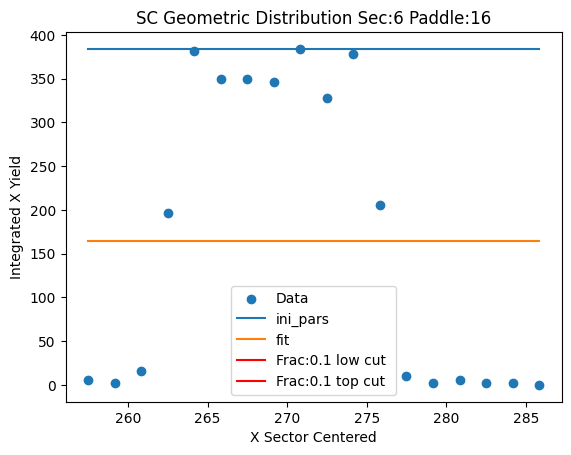

Parameters for Sec:6 Paddle:17
test pars [362.         284.16666667  13.78520677 246.12854556]
fit pars [137.36842105 284.16666667  13.78520677 246.12854556]


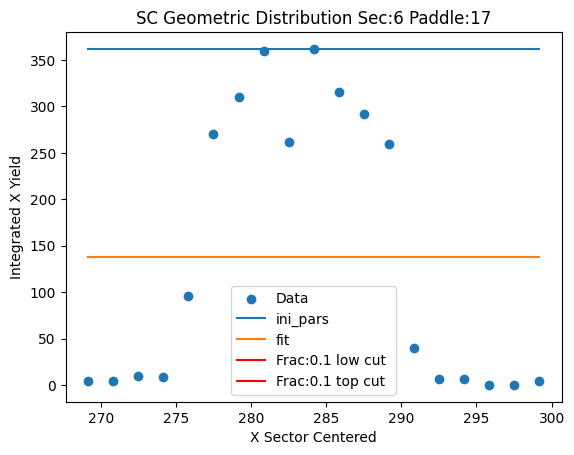

Parameters for Sec:6 Paddle:18
test pars [400.         295.83333333  14.78520677 246.12854556]
fit pars [166.94736842 295.83333333  14.78520677 246.12854556]


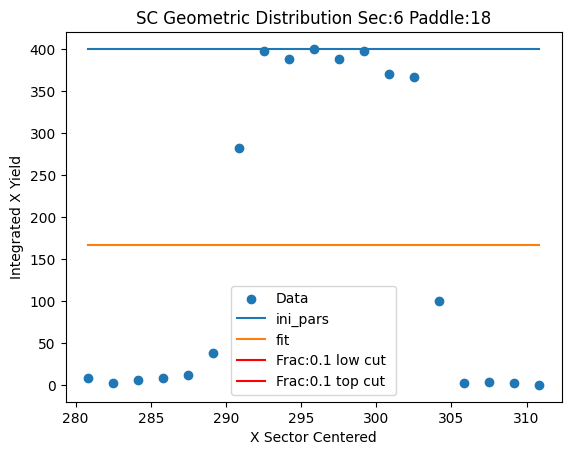

Parameters for Sec:6 Paddle:19
test pars [378.         305.83333333  15.78520677 246.12854556]
fit pars [146.73684211 305.83333333  15.78520677 246.12854556]


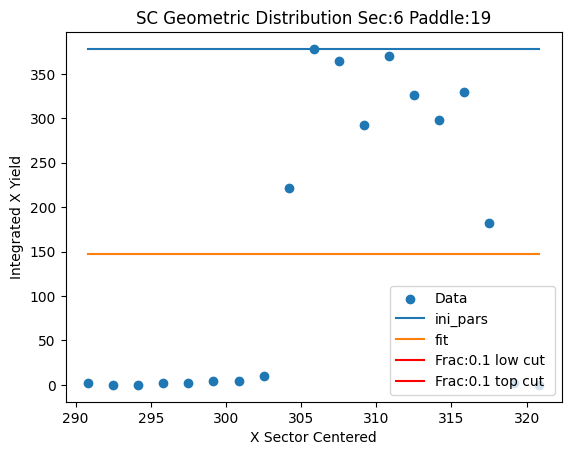

Parameters for Sec:6 Paddle:20
test pars [364.         325.83333333  16.78520677 246.12854556]
fit pars [145.89473684 325.83333333  16.78520677 246.12854556]


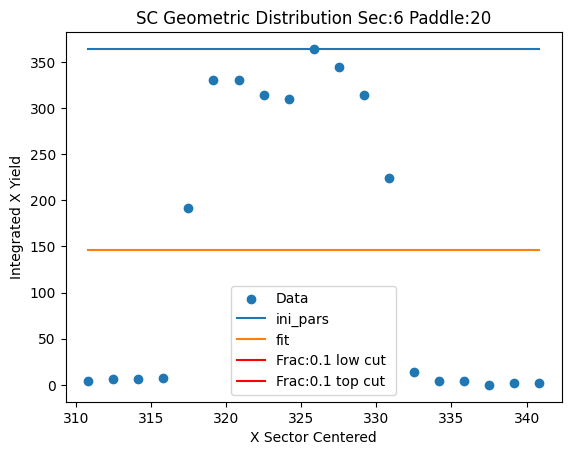

Parameters for Sec:6 Paddle:21
test pars [326.         335.83333333  17.78520677 246.12854556]
fit pars [128.73684211 335.83333333  17.78520677 246.12854556]


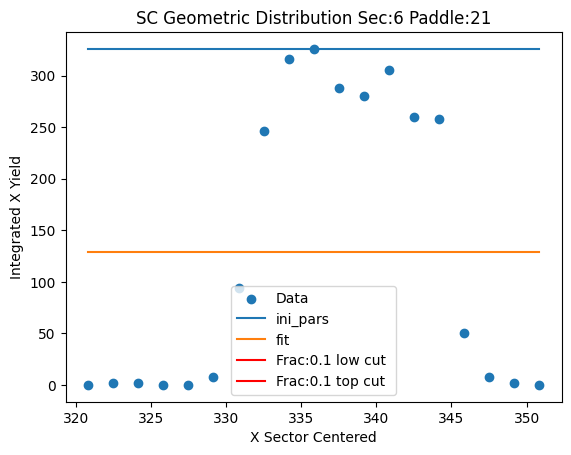

Parameters for Sec:6 Paddle:22
test pars [328.         350.83333333  18.78520677 246.12854556]
fit pars [136.31578947 350.83333333  18.78520677 246.12854556]


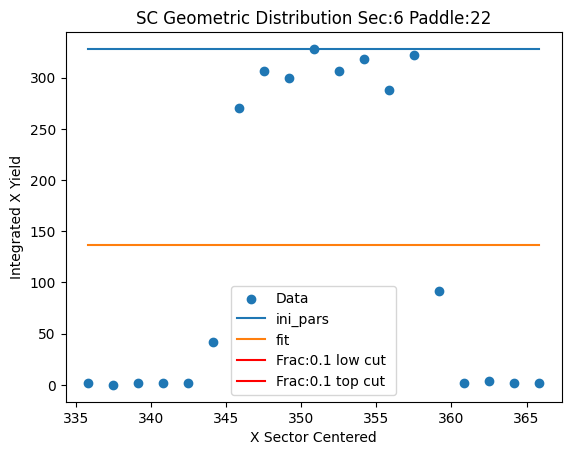

Parameters for Sec:6 Paddle:23
test pars [310.         362.5         19.78520677 246.12854556]
fit pars [118.94736842 362.5         19.78520677 246.12854556]


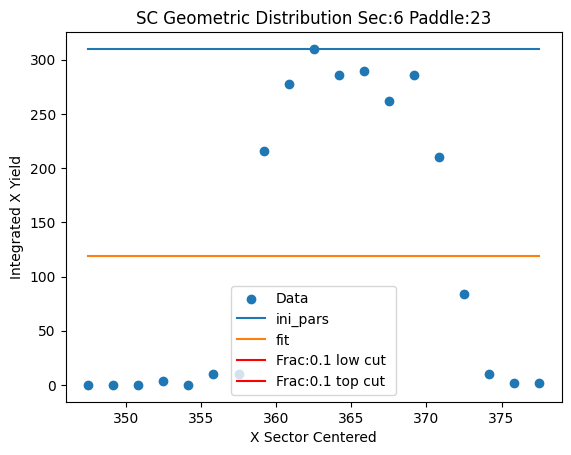

Parameters for Sec:6 Paddle:24
test pars [270.         374.16666667  20.78520677 246.12854556]
fit pars [114.21052657 374.16666667  20.78520677 246.12854556]


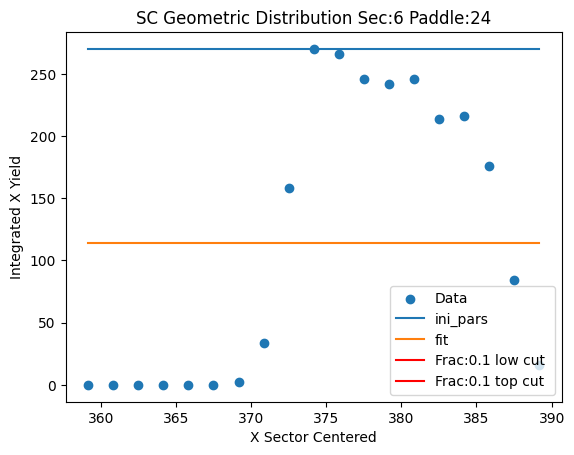

Parameters for Sec:6 Paddle:25
test pars [724.         375.83333333  21.78520677 246.12854556]
fit pars [147.5789447  375.83333333  21.78520677 246.12854556]


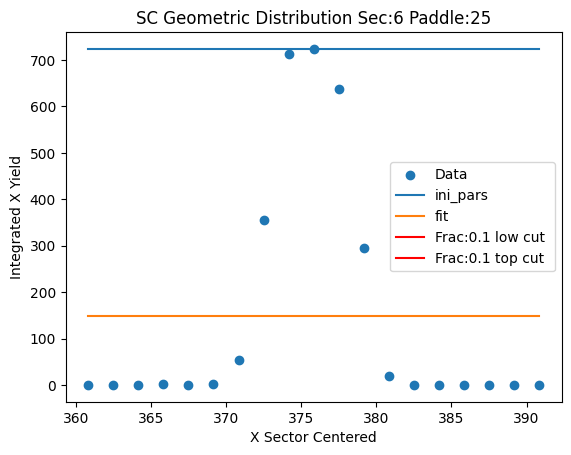

Parameters for Sec:6 Paddle:26
test pars [732.         382.5         22.78520677 246.12854556]
fit pars [135.57895007 382.5         22.78520677 246.12854556]


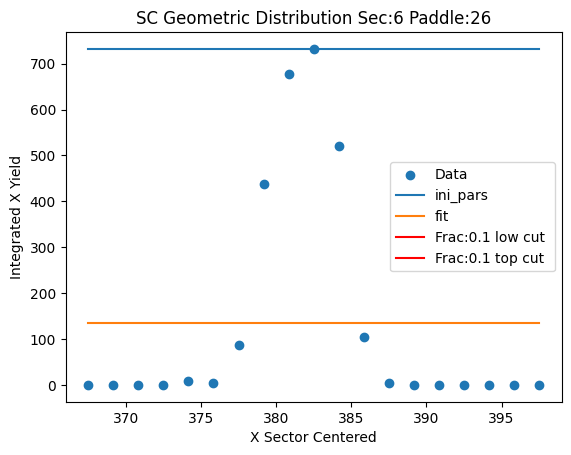

Parameters for Sec:6 Paddle:27
test pars [704.         387.5         23.78520677 246.12854556]
fit pars [128.52631609 387.5         23.78520677 246.12854556]


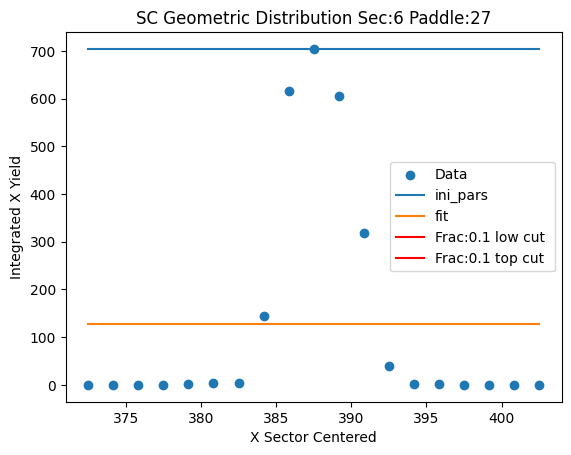

Parameters for Sec:6 Paddle:33
test pars [278.         422.5         24.78520677 246.12854556]
fit pars [ 52.63157961 422.5         24.78520677 246.12854556]


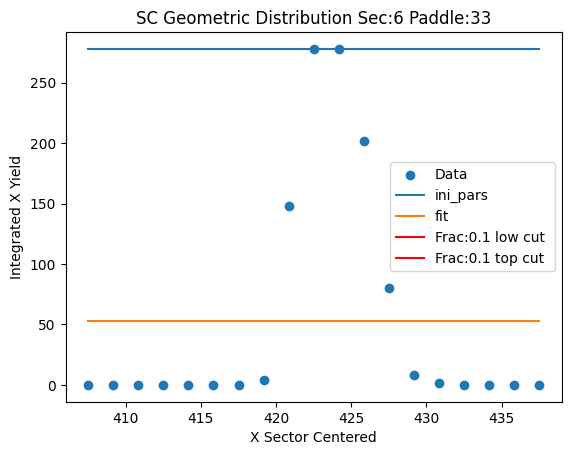

Parameters for Sec:6 Paddle:41
test pars [ 32.         410.83333333  25.78520677 246.12854556]
fit pars [  9.26315784 410.83333333  25.78520677 246.12854556]


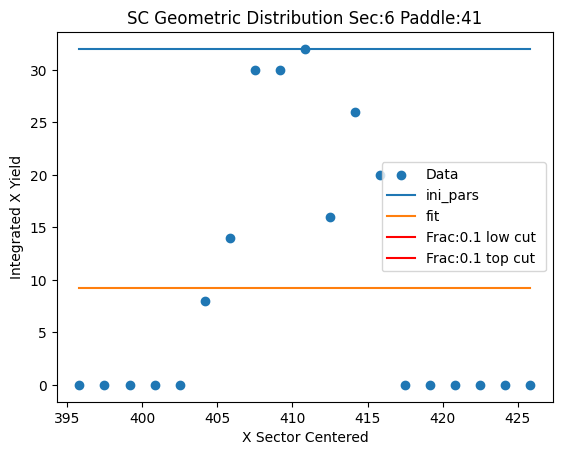

Parameters for Sec:6 Paddle:42
test pars [ 20.         400.83333333  26.78520677 246.12854556]
fit pars [  5.6842106  400.83333333  26.78520677 246.12854556]


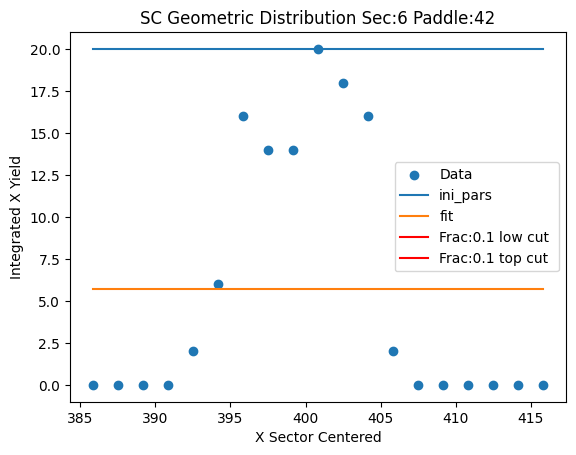

Parameters for Sec:6 Paddle:43
test pars [ 20.         385.83333333  27.78520677 246.12854556]
fit pars [  5.89473687 385.83333333  27.78520677 246.12854556]


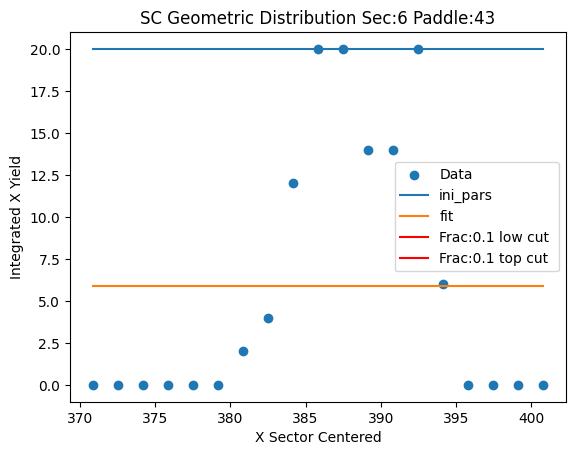

Parameters for Sec:6 Paddle:44
test pars [ 10.         367.5         28.78520677 246.12854556]
fit pars [  3.89473685 367.5         28.78520677 246.12854556]


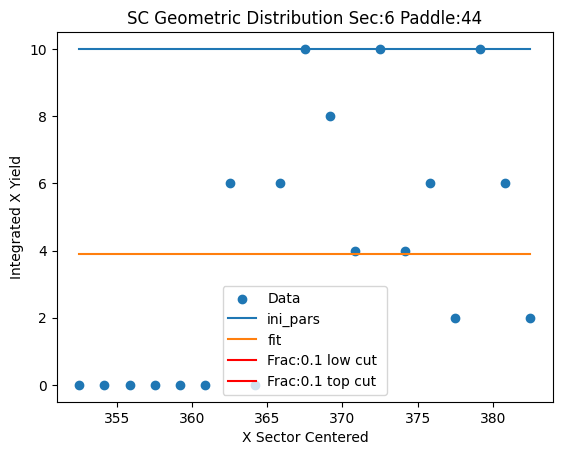

Parameters for Sec:6 Paddle:46
test pars [ 10.         319.16666667  29.78520677 246.12854556]
fit pars [  2.42105263 319.16666667  29.78520677 246.12854556]


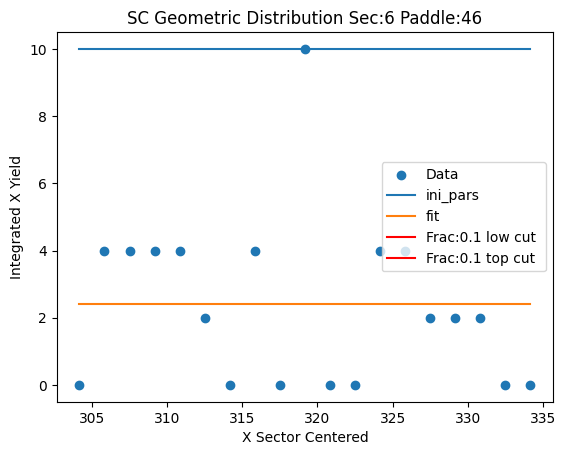

Parameters for Sec:6 Paddle:47
test pars [  6.         280.83333333  30.78520677 246.12854556]
fit pars [  2.         280.83333333  30.78520677 246.12854556]


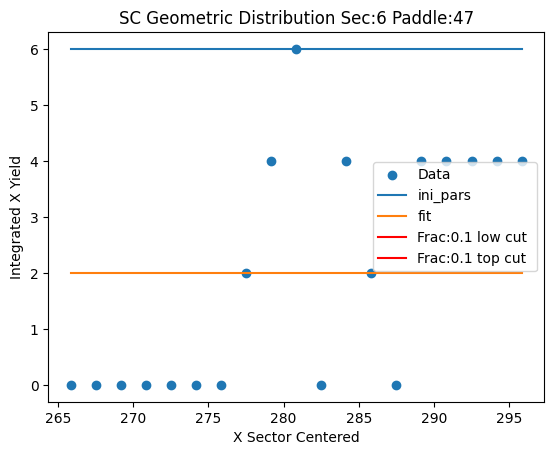

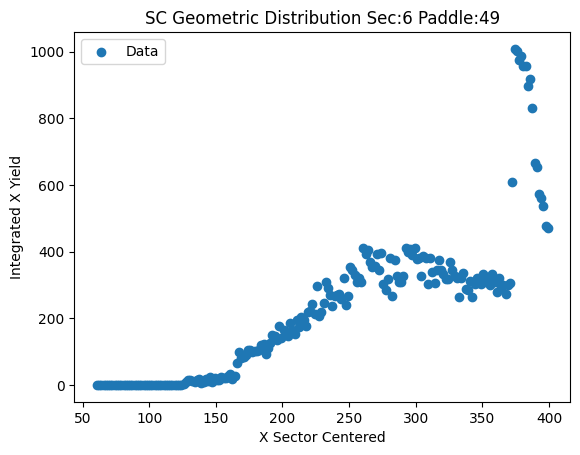

Parameters for Sec:7 Paddle:5
test pars [  8.         124.16666667   5.4          4.        ]
fit pars [2.10929793e+04 1.23605255e+02 5.05259880e-08 1.30016737e-01]


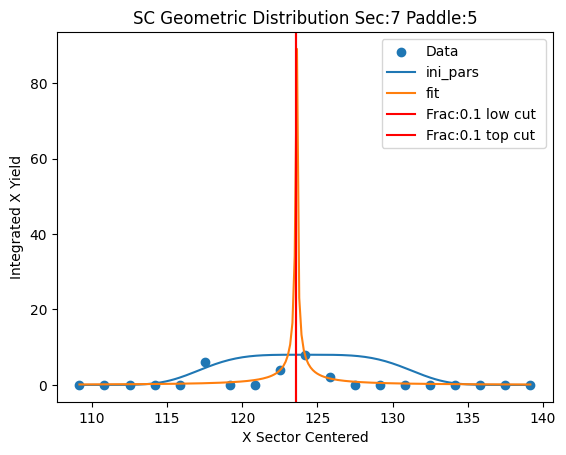

Parameters for Sec:7 Paddle:6
test pars [5.80000000e+01 1.37500000e+02 1.00000005e+00 1.30016737e-01]
fit pars [ 57.53743633 137.49999957   3.17725735   0.5022418 ]


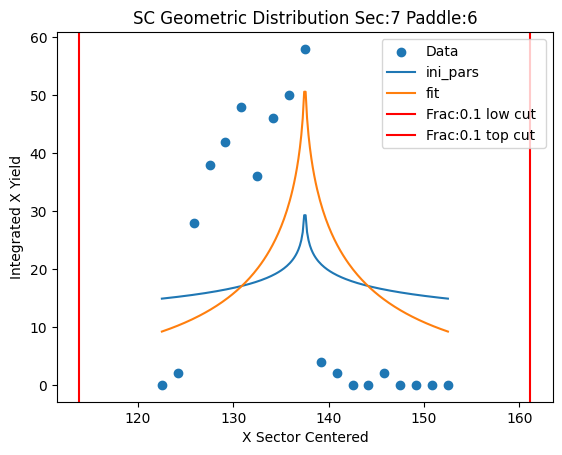

Parameters for Sec:7 Paddle:7
test pars [120.         150.83333333   4.17725735   0.5022418 ]
fit pars [ 87.14285727 145.80014012   4.72822483  64.65703839]


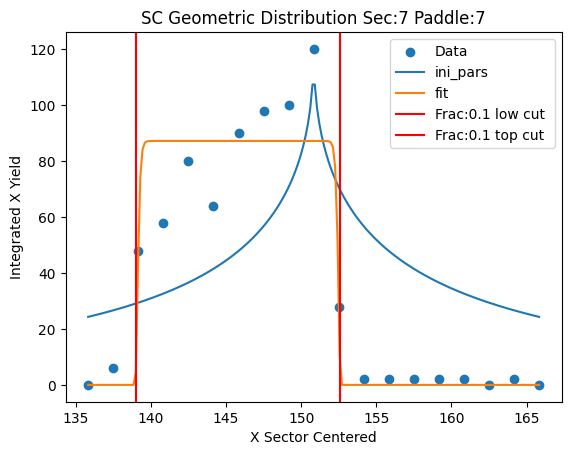

Parameters for Sec:7 Paddle:8
test pars [202.         160.83333333   5.72822483  64.65703839]
fit pars [175.70091847 159.6434456    5.10550498  12.58449599]


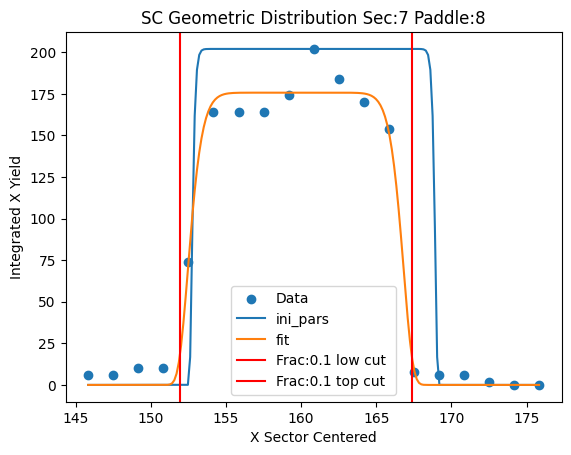

Parameters for Sec:7 Paddle:9
test pars [474.         175.83333333   6.10550498  12.58449599]
fit pars [411.95965153 173.19048091   5.16431678  18.68622657]


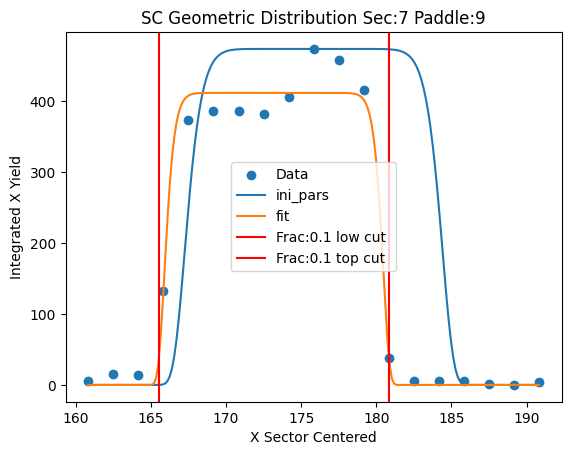

Parameters for Sec:7 Paddle:10
test pars [650.         190.83333333   6.16431678  18.68622657]
fit pars [577.16700631 186.89117662   5.03915394   9.95132177]


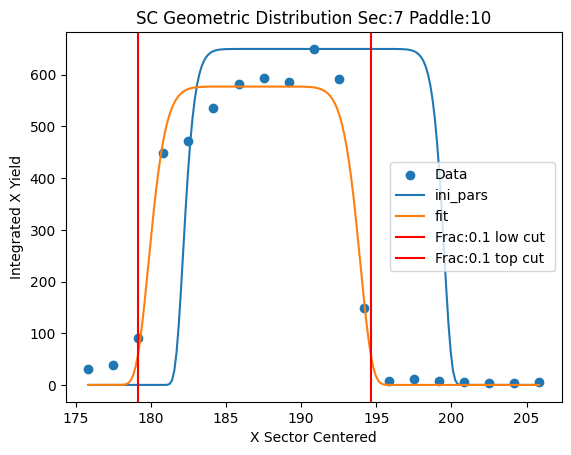

Parameters for Sec:7 Paddle:11
test pars [836.         205.83333333   6.03915394   9.95132177]
fit pars [808.01503062 200.79333689   5.13800775   8.31251975]


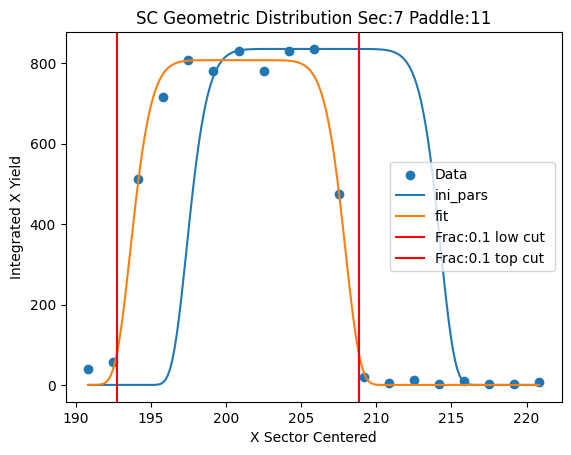

Parameters for Sec:7 Paddle:12
test pars [1162.          219.16666667    6.13800775    8.31251975]
fit pars [1016.49038376  214.55551118    5.03314236    9.6787792 ]


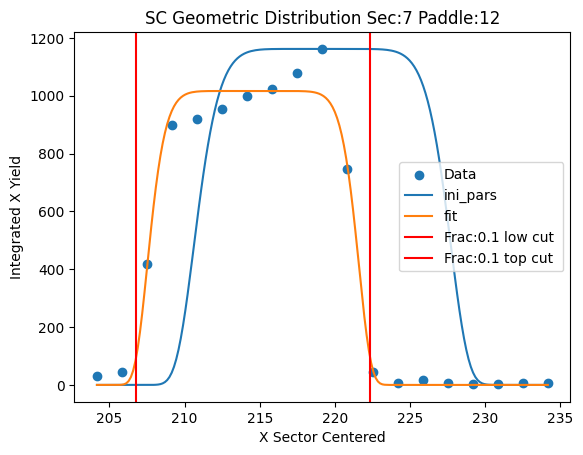

Parameters for Sec:7 Paddle:13
test pars [1554.          232.5           6.03314236    9.6787792 ]
fit pars [1359.66854884  228.28652328    5.17262712   15.3020609 ]


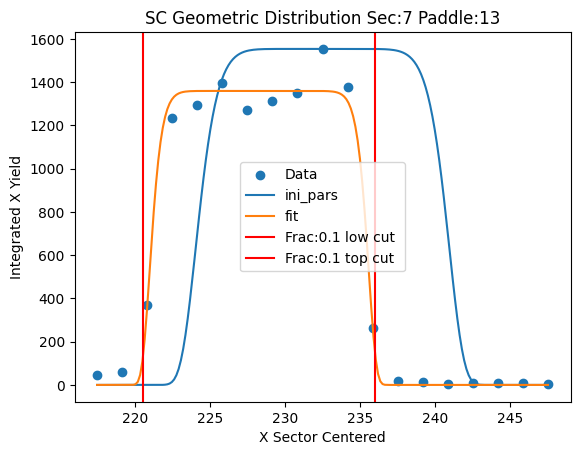

Parameters for Sec:7 Paddle:14
test pars [1548.          245.83333333    6.17262712   15.3020609 ]
fit pars [1435.63607871  241.89134447    5.07398032   10.13975335]


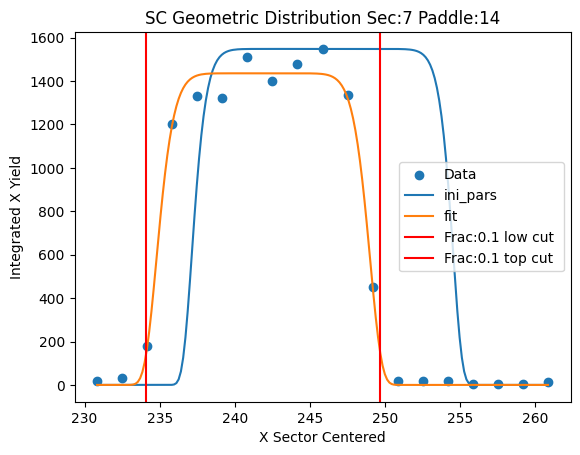

Parameters for Sec:7 Paddle:15
test pars [2024.          260.83333333    6.07398032   10.13975335]
fit pars [1926.85714533  255.81696266    4.76073327   64.46089521]


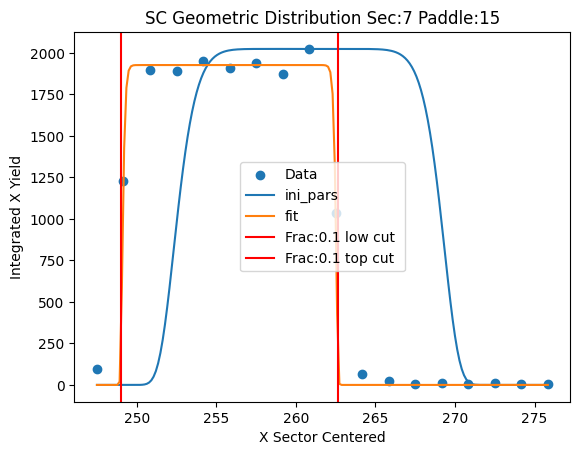

Parameters for Sec:7 Paddle:16
test pars [2108.          270.83333333    5.76073327   64.46089521]
fit pars [2008.27149984  269.42983674    5.09437875    8.74552644]


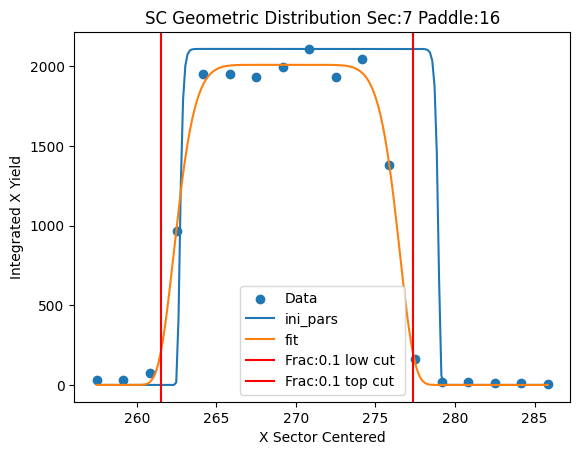

Parameters for Sec:7 Paddle:17
test pars [1928.          284.16666667    6.09437875    8.74552644]
fit pars [1839.19859367  283.31742553    5.13241058   10.8644588 ]


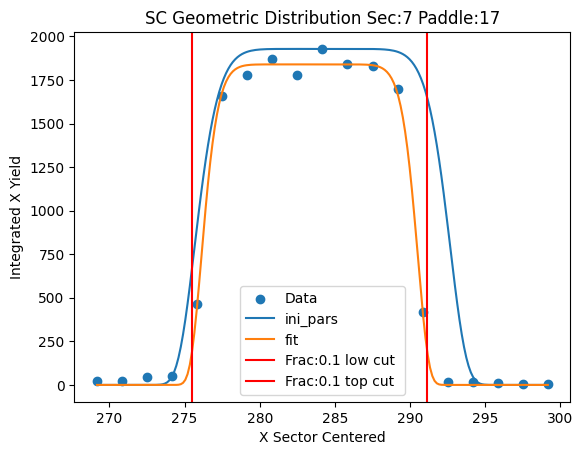

Parameters for Sec:7 Paddle:18
test pars [2194.          299.16666667    6.13241058   10.8644588 ]
fit pars [2134.29652279  296.98400989    5.05319557    9.00040823]


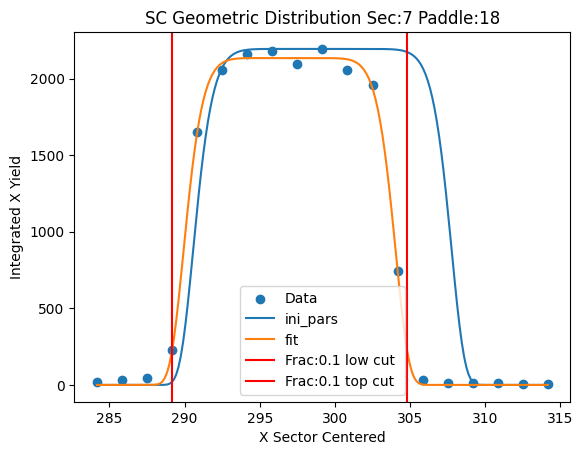

Parameters for Sec:7 Paddle:19
test pars [2214.          309.16666667    6.05319557    9.00040823]
fit pars [2116.40314047  310.7576353     5.13919475    8.37270668]


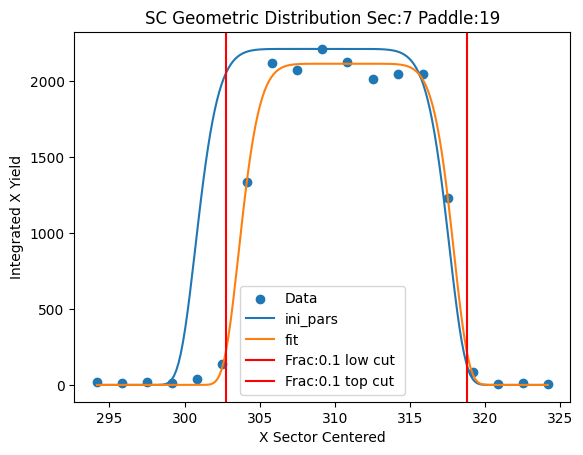

Parameters for Sec:7 Paddle:20
test pars [1980.          324.16666667    6.13919475    8.37270668]
fit pars [1932.11062176  324.5108018     5.15697827    8.65348437]


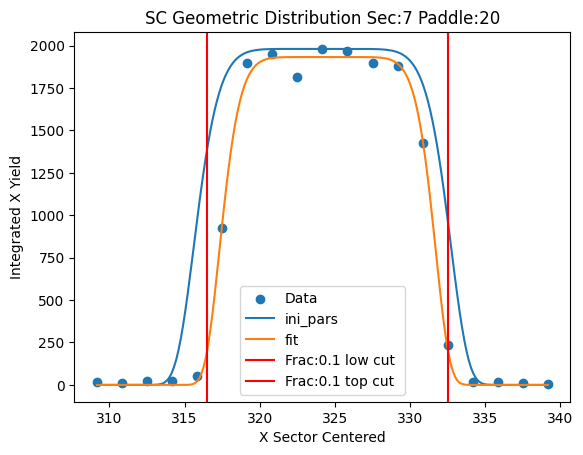

Parameters for Sec:7 Paddle:21
test pars [1706.          334.16666667    6.15697827    8.65348437]
fit pars [1628.90981171  338.15359404    5.10667303    8.39093458]


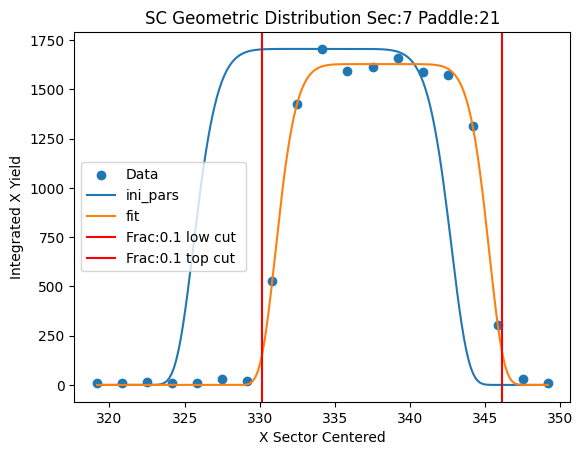

Parameters for Sec:7 Paddle:22
test pars [1644.          349.16666667    6.10667303    8.39093458]
fit pars [1558.43852799  351.98977603    5.13038479    7.91167044]


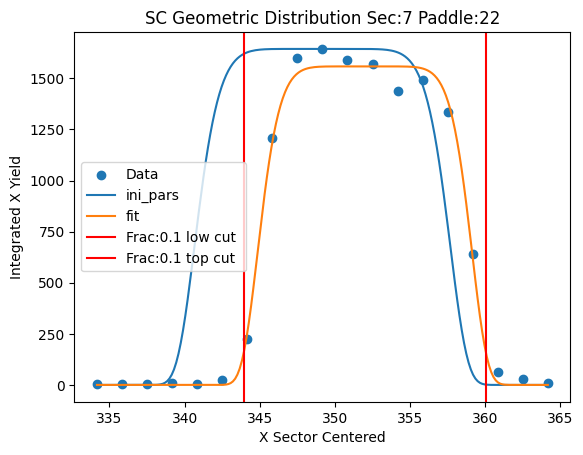

Parameters for Sec:7 Paddle:23
test pars [1724.          362.5           6.13038479    7.91167044]
fit pars [1700.62585083  365.5131749     5.0115845     7.85570391]


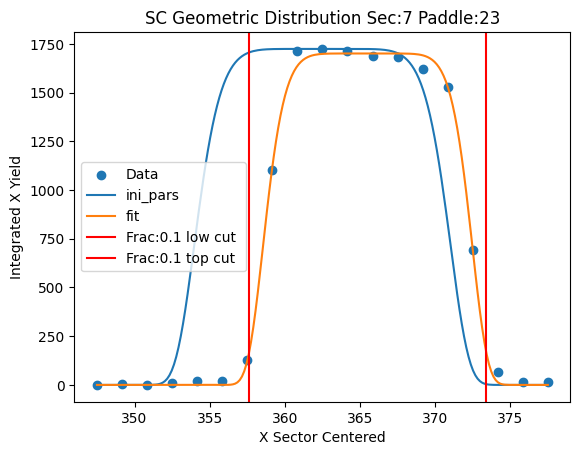

Parameters for Sec:7 Paddle:24
test pars [1600.          375.83333333    6.0115845     7.85570391]
fit pars [1443.61999777  379.8218197     5.5054914     7.60228281]


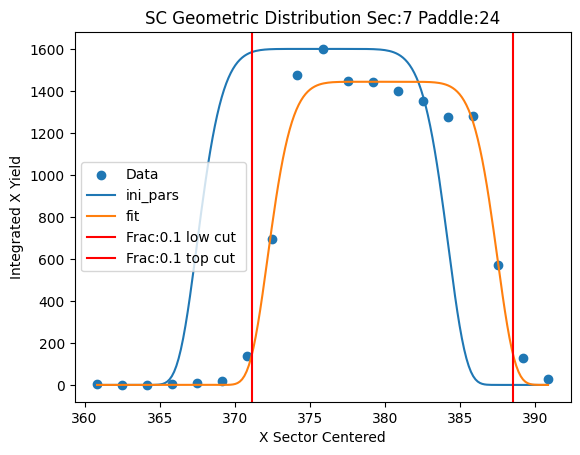

Parameters for Sec:7 Paddle:25
test pars [3466.          377.5           6.5054914     7.60228281]
fit pars [3.33278702e+03 3.77371147e+02 2.65678092e+00 2.24321227e+00]


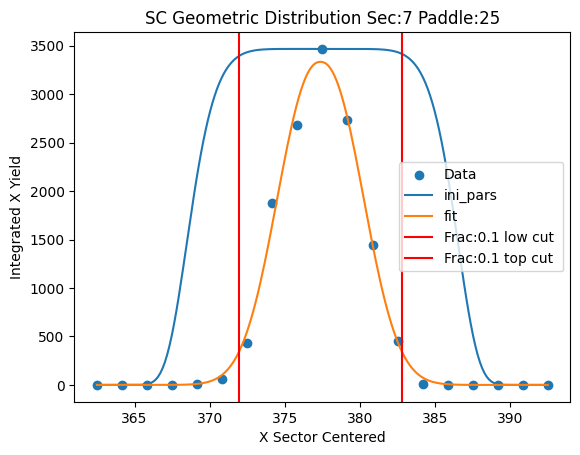

Parameters for Sec:7 Paddle:26
test pars [4.24400000e+03 3.84166667e+02 3.65678092e+00 2.24321227e+00]
fit pars [4.23236229e+03 3.83805912e+02 2.50504512e+00 2.05554279e+00]


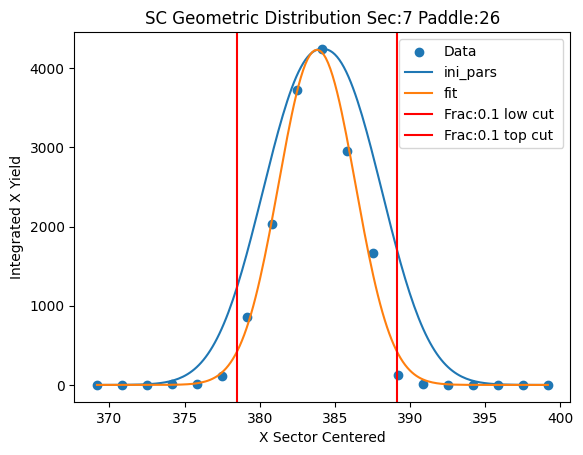

Parameters for Sec:7 Paddle:27
test pars [3.53000000e+03 3.89166667e+02 3.50504512e+00 2.05554279e+00]
fit pars [3.51232053e+03 3.89744628e+02 2.46125091e+00 2.08939835e+00]


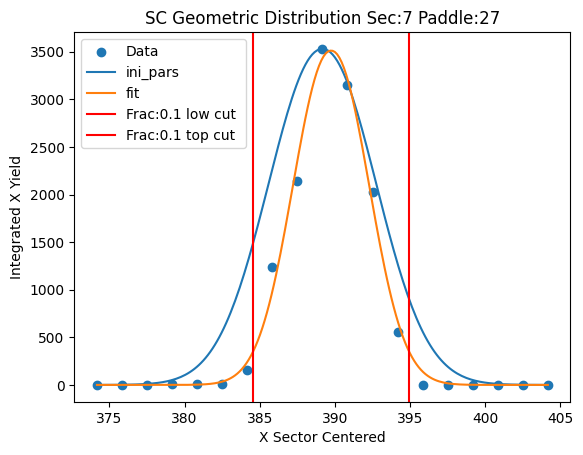

Parameters for Sec:7 Paddle:28
test pars [2.88000000e+03 3.95833333e+02 3.46125091e+00 2.08939835e+00]
fit pars [2.91027499e+03 3.95612927e+02 2.43266718e+00 2.25323666e+00]


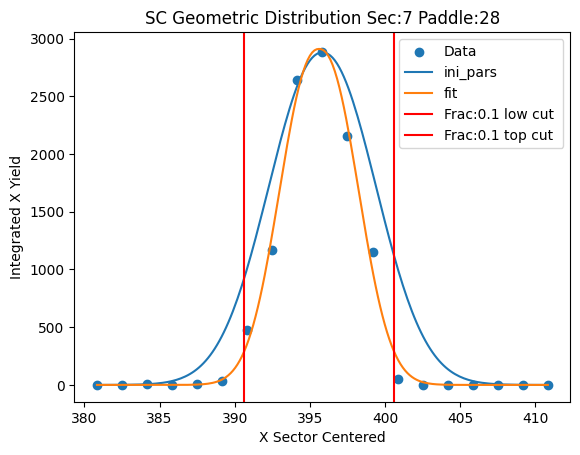

Parameters for Sec:7 Paddle:29
test pars [3.12200000e+03 4.00833333e+02 3.43266718e+00 2.25323666e+00]
fit pars [3.11478635e+03 4.01342705e+02 2.36094140e+00 2.18033022e+00]


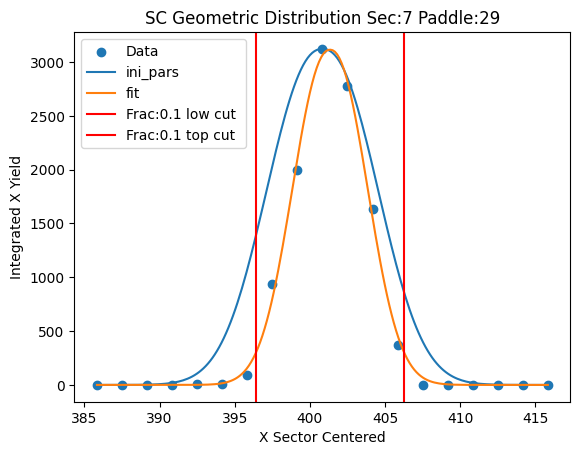

Parameters for Sec:7 Paddle:30
test pars [2.82800000e+03 4.07500000e+02 3.36094140e+00 2.18033022e+00]
fit pars [2.83242035e+03 4.07142439e+02 2.35822325e+00 2.52671565e+00]


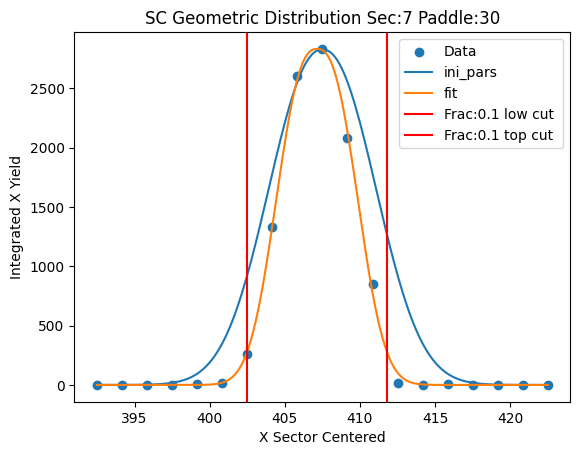

Parameters for Sec:7 Paddle:31
test pars [2294.          412.5           3.35822325    2.52671565]
fit pars [2250.85874016  413.05499062    2.39701665    2.66507627]


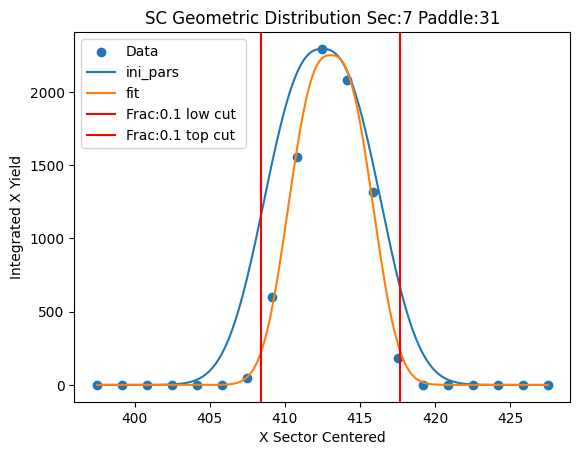

Parameters for Sec:7 Paddle:32
test pars [2134.          419.16666667    3.39701665    2.66507627]
fit pars [2149.41432024  418.88159119    2.34768826    2.55380972]


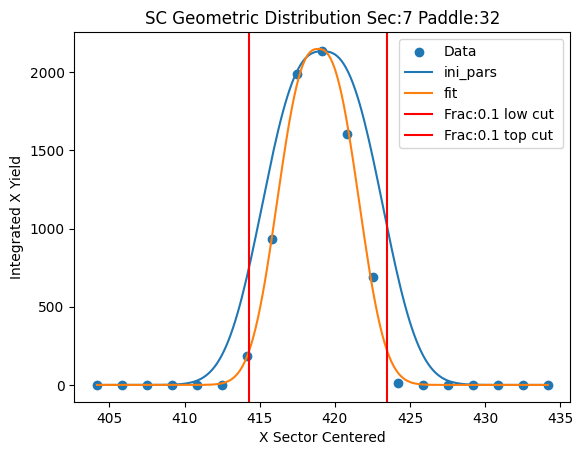

Parameters for Sec:7 Paddle:33
test pars [1534.          424.16666667    3.34768826    2.55380972]
fit pars [1485.36944852  424.80318161    2.42062869    2.87625189]


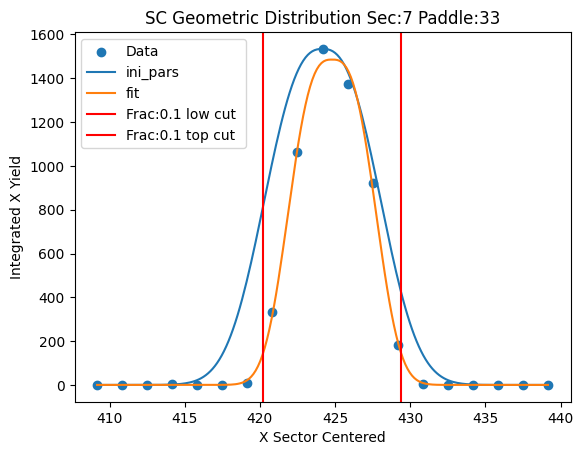

Parameters for Sec:7 Paddle:34
test pars [1244.          430.83333333    3.42062869    2.87625189]
fit pars [1262.86455056  430.52955425    2.35403198    2.60405086]


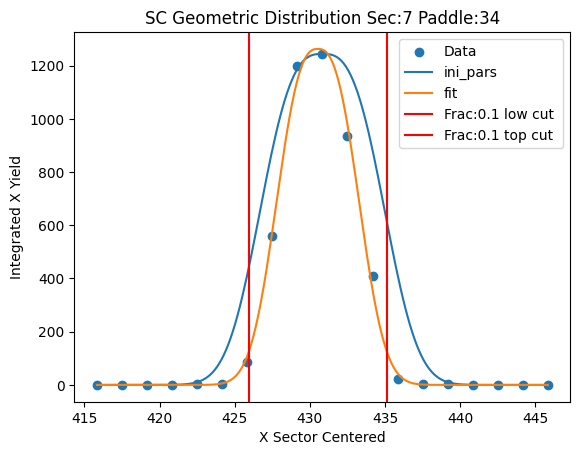

Parameters for Sec:7 Paddle:35
test pars [708.         435.83333333   3.35403198   2.60405086]
fit pars [673.47737352 436.17099855   2.40456053   3.33960644]


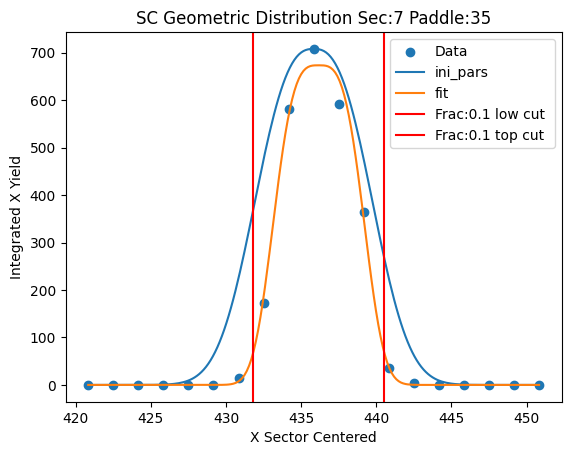

Parameters for Sec:7 Paddle:36
test pars [522.         442.5          3.40456053   3.33960644]
fit pars [511.54429373 442.38148658   2.22070559   5.23451296]


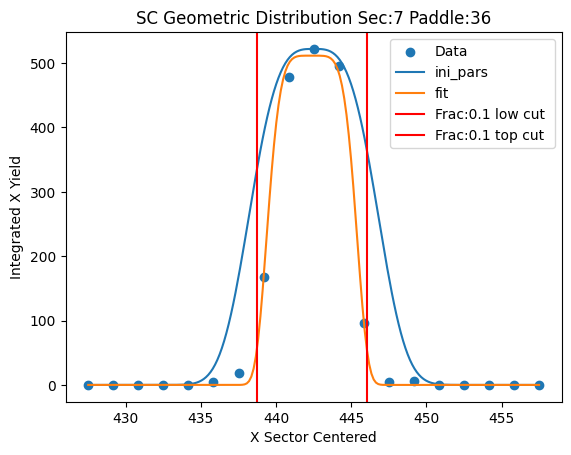

Parameters for Sec:7 Paddle:37
test pars [352.         435.83333333   3.22070559   5.23451296]
fit pars [328.16636616 436.78815034   2.09554549   3.63092919]


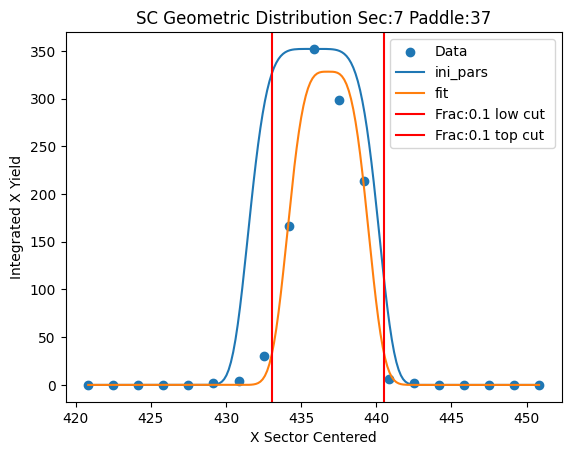

Parameters for Sec:7 Paddle:39
test pars [198.         425.83333333   3.09554549   3.63092919]
fit pars [200.09288654 425.32056893   2.22366877   2.92041981]


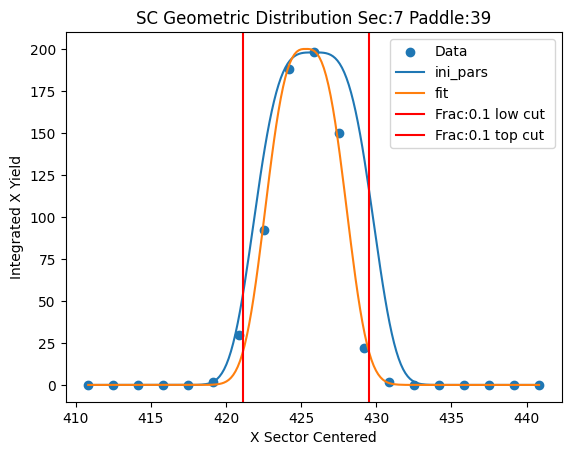

Parameters for Sec:7 Paddle:41
test pars [142.         409.16666667   3.22366877   2.92041981]
fit pars [126.3333477  411.62651306   4.1153214   44.76178403]


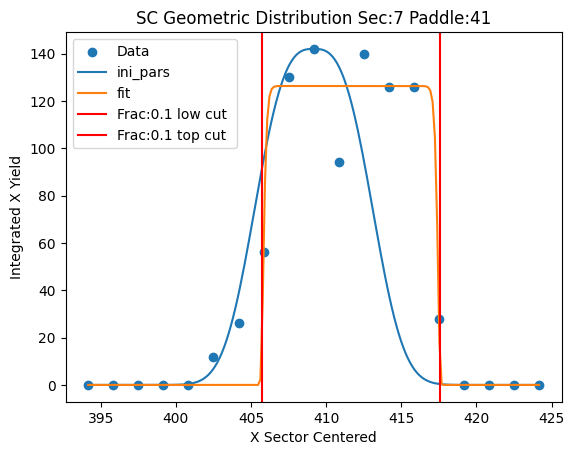

Parameters for Sec:7 Paddle:42
test pars [100.         399.16666667   5.1153214   44.76178403]
fit pars [ 95.82767384 399.79976198   4.21701247   4.03263989]


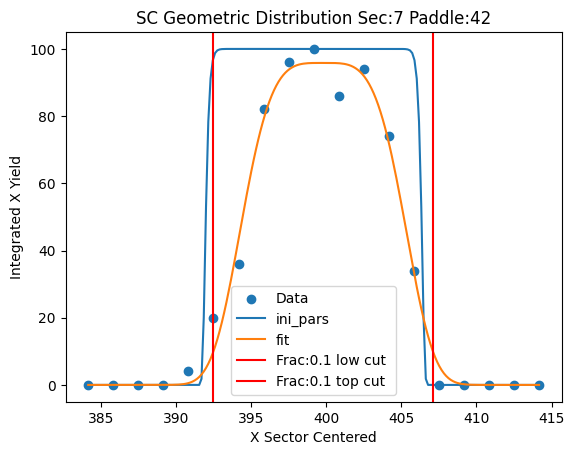

Parameters for Sec:7 Paddle:43
test pars [ 68.         392.5          5.21701247   4.03263989]
fit pars [ 53.42227004 389.58244508   3.88820686   6.43321667]


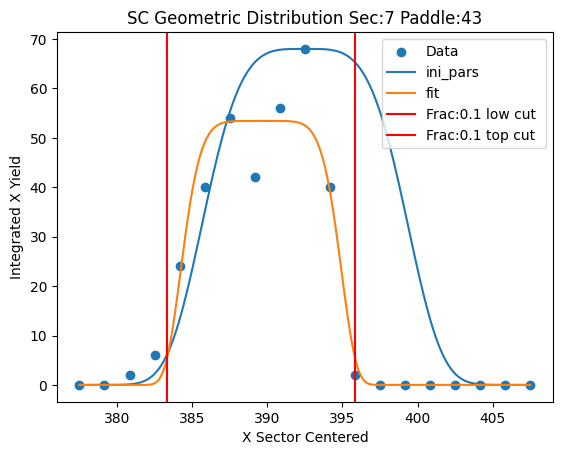

Parameters for Sec:7 Paddle:44
test pars [ 34.         370.83333333   4.88820686   6.43321667]
fit pars [ 25.85299108 377.91275247  11.06288077   8.33441933]


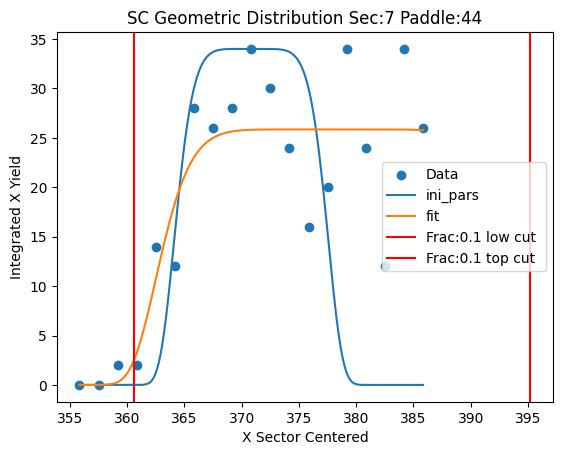

Parameters for Sec:7 Paddle:45
test pars [ 32.         345.83333333  12.06288077   8.33441933]
fit pars [ 18.73739114 347.4513916   10.0604754   13.32466738]


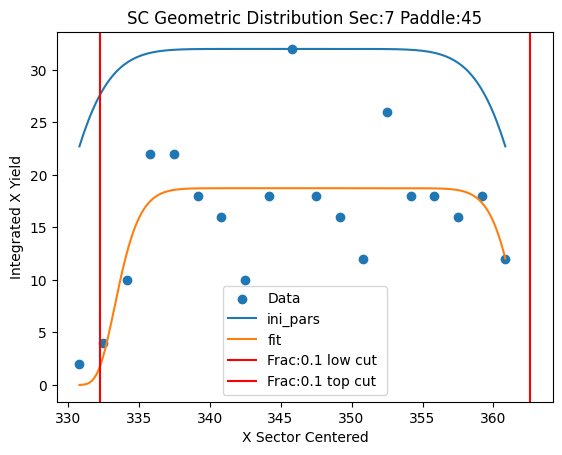

Parameters for Sec:7 Paddle:46
test pars [ 14.         305.83333333  11.0604754   13.32466738]
fit pars [  8.66666665 312.5          5.86791446  91.33344529]


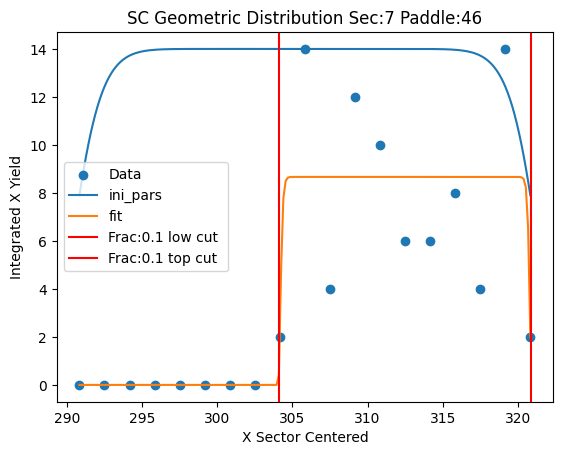

Parameters for Sec:7 Paddle:47
test pars [ 20.         300.83333333   6.86791446  91.33344529]
fit pars [12.15473206 41.84824836 22.12671449 84.79285911]


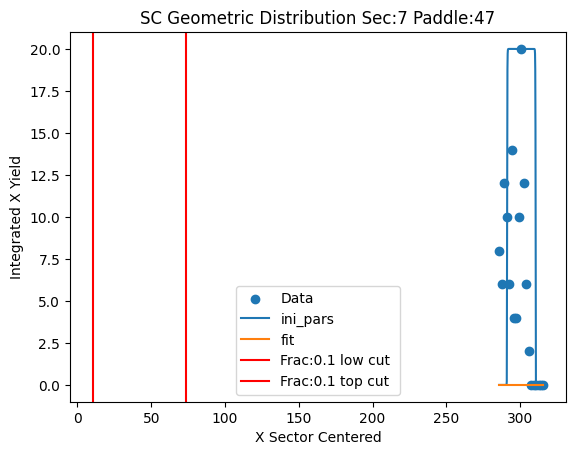

Parameters for Sec:7 Paddle:48
test pars [ 14.         259.16666667  23.12671449  84.79285911]
fit pars [  4.52631578 259.16666667  23.12671449  84.79285911]


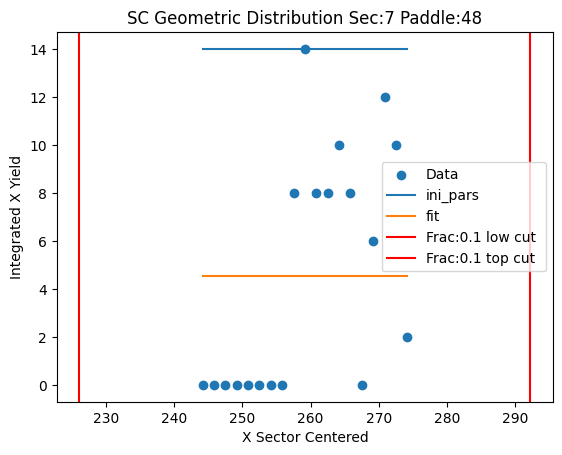

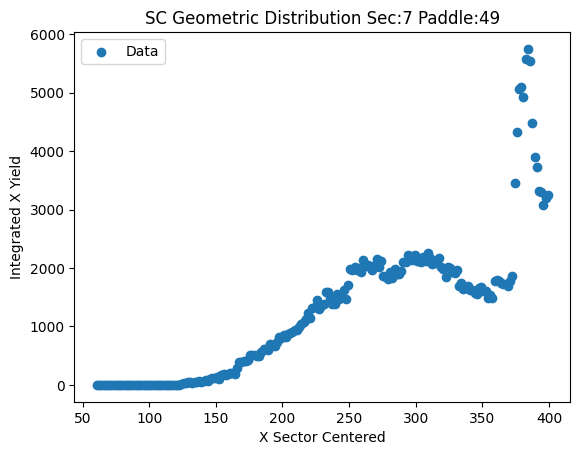

In [25]:
cut_lines = np.zeros((7,cut_hist_len,2))

low = 0.0
high = 0.0
space = 15

#Super_Gaus(x,a_,m_,s_,p_)


fit_pars = np.zeros((7,cut_hist_len,4))

ini_par = [20.0,130,5.4,4.0]

test_pars = np.zeros(4)

frac_cut = 0.1

paddle_expand = 19

par_bounds = [[0.0,0.0,0.0,0.0],[np.inf,np.inf,np.inf,np.inf]]


for sec in range(7):
    for i in range(4):
        test_pars[i] = ini_par[i]
    
    for hist_idx in range(cut_hist_len):
        if(Count_Non_Zero(proj_y[sec][hist_idx]) >= 8):
            if hist_idx == num_sc_pad:
                low = 60.
                high = 400.
            else:
                low = yvals[np.argmax(proj_y[sec][hist_idx])] - space
                high = yvals[np.argmax(proj_y[sec][hist_idx])] + space
            test_pars[0] = proj_y[sec][hist_idx][np.argmax(proj_y[sec][hist_idx])]
            test_pars[1] = yvals[np.argmax(proj_y[sec][hist_idx])]
            new_yvals = Bounds_on_Y(yvals,low,high)
            new_zvals = Bounds_on_X_From_Y(proj_y[sec][hist_idx],yvals,low,high)
            plt.scatter(new_yvals,new_zvals,label="Data")
            if hist_idx < num_sc_pad:
                try: 
                    pars, pars_cov = op.curve_fit(Super_Gaus,new_yvals,new_zvals,p0=test_pars,maxfev=5000,bounds=par_bounds)
                    print("Parameters for Sec:{} Paddle:{}".format(sec+1,hist_idx+1))
                    print("test pars",test_pars)
                    print("fit pars",pars)
                    cont_x = np.linspace(new_yvals[0],new_yvals[len(new_yvals)-1],200)
                    plt.plot(cont_x,Super_Gaus(cont_x,*test_pars),label="ini_pars")
                    plt.plot(cont_x,Super_Gaus(cont_x,*pars),label="fit")

                    for j in range(4):
                        test_pars[j] = pars[j]
                        if j == 1:
                            test_pars[j]=yvals[np.argmax(proj_y[sec][hist_idx+1])]
                        if j == 2:
                            test_pars[j]+=1.
                        fit_pars[sec][hist_idx][j] = pars[j]
                    #if hist_idx == paddle_expand:
                    #    test_pars[2]+=3
                    cut_lines[sec][hist_idx][0] = super_gaus_cut_bound(frac_cut,0,*pars)
                    cut_lines[sec][hist_idx][1] = super_gaus_cut_bound(frac_cut,1,*pars)
                    plt.axvline(x=cut_lines[sec][hist_idx][0],color='r',label="Frac:{} low cut ".format(frac_cut))
                    plt.axvline(x=cut_lines[sec][hist_idx][1],color='r',label="Frac:{} top cut ".format(frac_cut))
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            plt.title("SC Geometric Distribution Sec:{} Paddle:{}".format(sec+1,hist_idx+1))
            plt.ylabel("Integrated X Yield")
            plt.xlabel("X Sector Centered")
            plt.legend()
            plt.show()



[[70.0, 1.7320508075688772], [70.0, 1.7320508075688772], [70.0, 1.7320508075688772], [70.0, 1.7320508075688772], [70.0, 1.7320508075688772], [70.0, 1.7320508075688772], [70.0, 1.7320508075688772]]
[70.0, 1.7320508075688772]


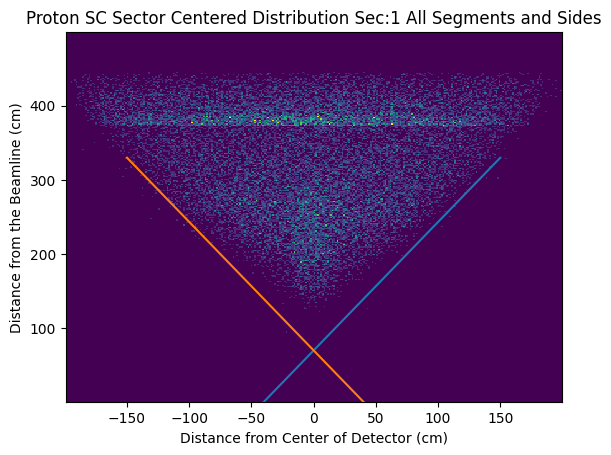

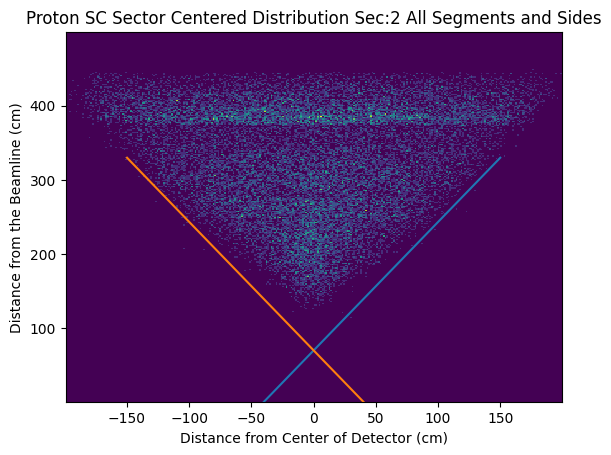

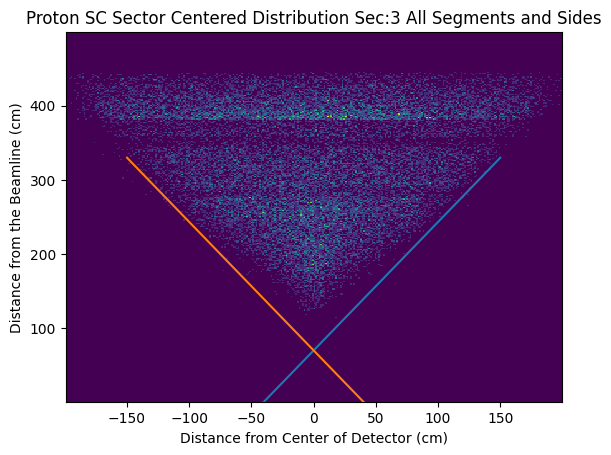

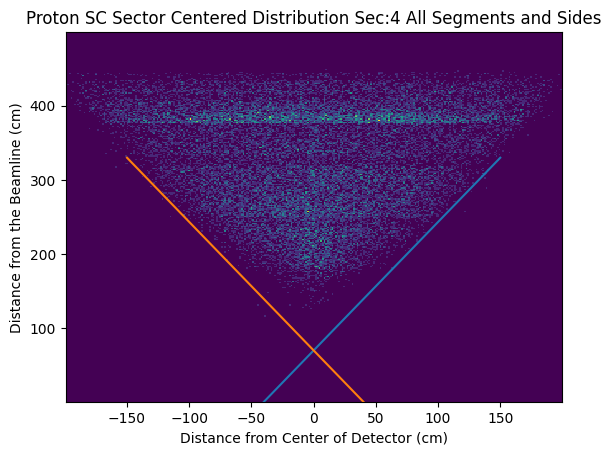

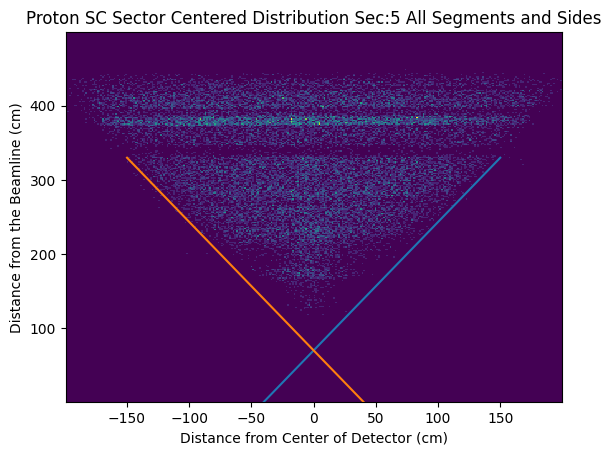

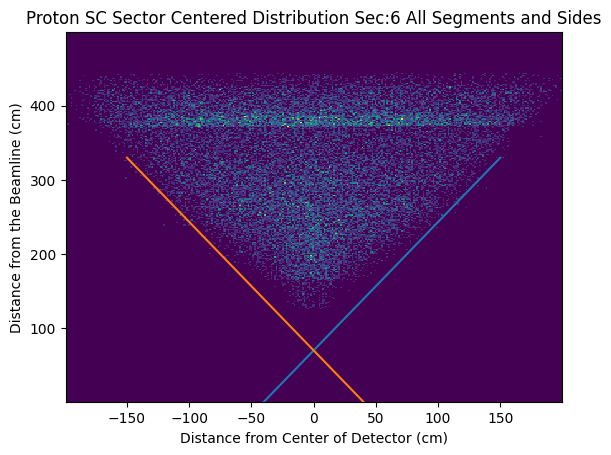

In [31]:
right_cut_pars = [[70.,3.**(1/2)] for i in range(7)]
left_cut_pars = [[70.,-3.**(1/2)] for i in range(7)]

print(right_cut_pars)
print(right_cut_pars[0])

cont_x_r = np.linspace(-50.0,150.,200)
cont_x_l = np.linspace(-150.0,50.,200)

for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1])
    plt.plot(cont_x_r,Poly(cont_x_r,right_cut_pars[sec]),label="right_edge")
    plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec]),label="left_edge")
    plt.title("Proton SC Sector Centered Distribution Sec:{} All Segments and Sides".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

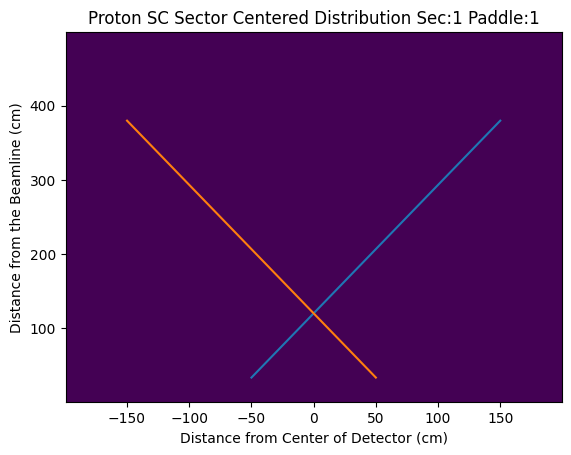

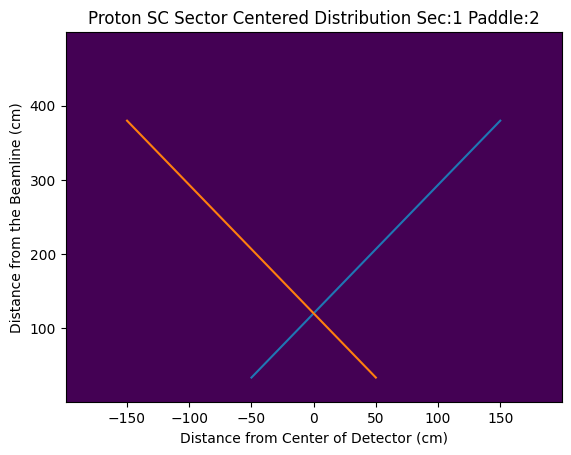

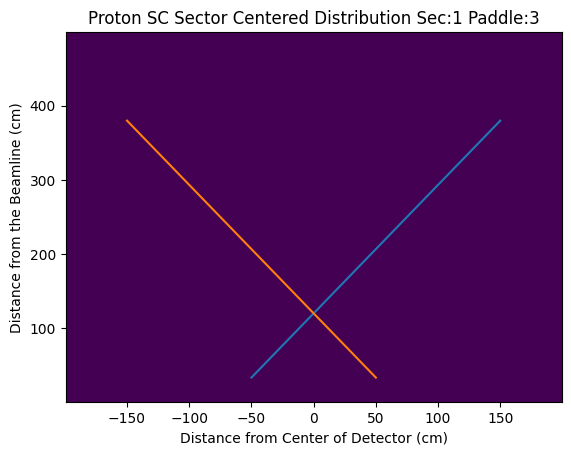

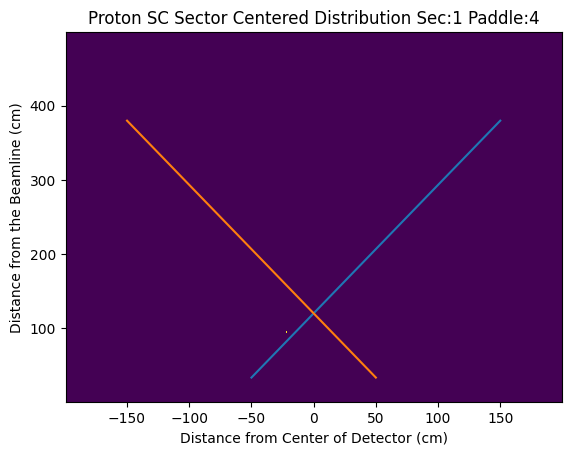

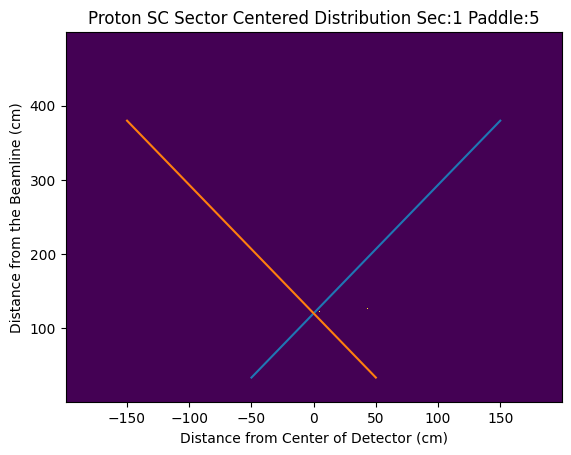

...

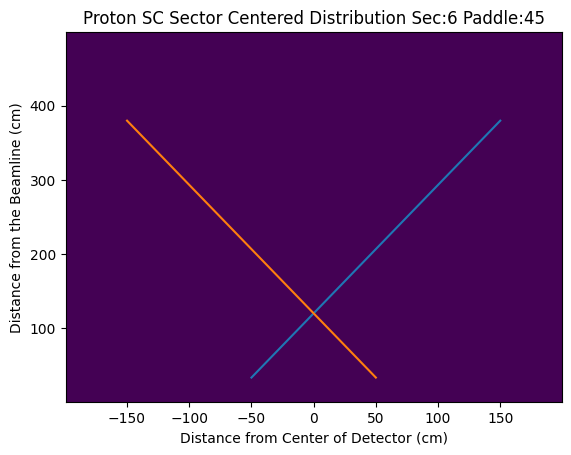

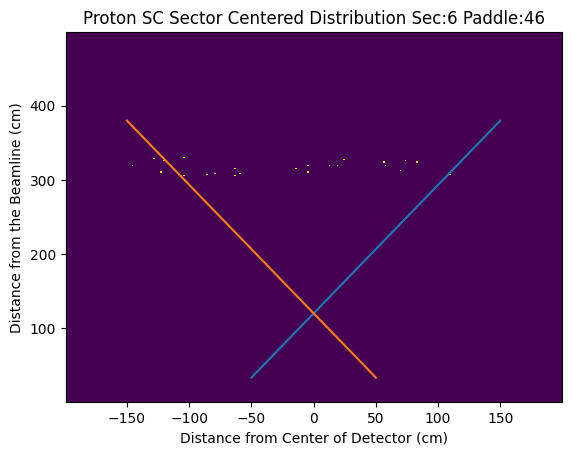

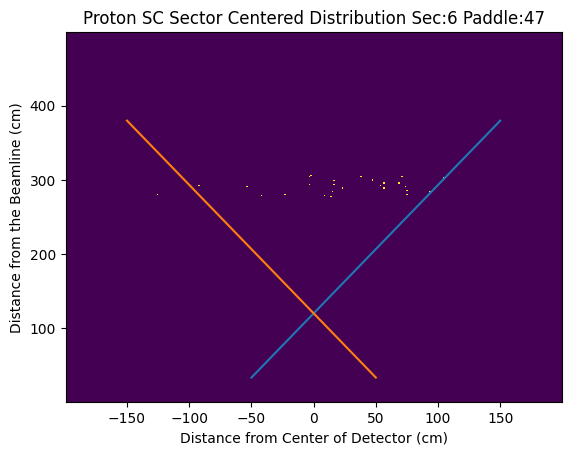

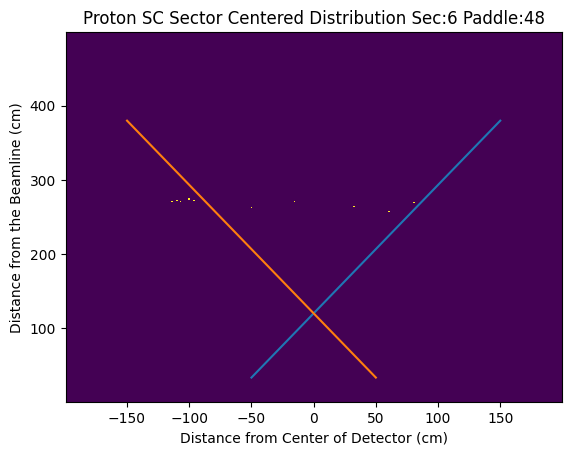

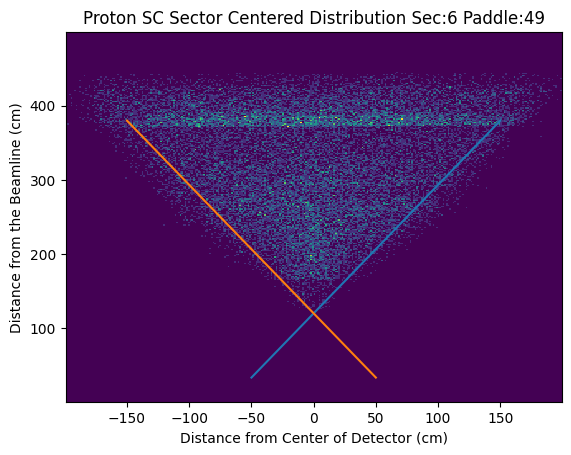

In [30]:
for sec in range(6):
    for hist_idx in range(cut_hist_len):
        plt.hist2d(dumb1_x[sec][hist_idx], dumb1_y[sec][hist_idx], bins=(xdim, ydim), weights=dense1[sec][hist_idx])
        if cut_lines[sec][hist_idx][0] > 0.0:
            plt.axhline(y=cut_lines[sec][hist_idx][0],color='r')
            plt.axhline(y=cut_lines[sec][hist_idx][1],color='r')
        plt.plot(cont_x_r,Poly(cont_x_r,right_cut_pars[sec]),label="right_edge")
        plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec]),label="left_edge")
        plt.title("Proton SC Sector Centered Distribution Sec:{} Paddle:{}".format(sec+1,hist_idx+1))
        plt.xlabel("Distance from Center of Detector (cm)")
        plt.ylabel("Distance from the Beamline (cm)")
        plt.show()

In [ ]:
print()